# **Electric Energy Consumption Time Series Analysis**
<br>
Manami Yano
<br>
26002204001
<br>
Applied Informatics 1
<br>
Final project
<br>
July 21st, 2024
    
</div>

## Dataset Definition

The dataset shows a comprehensive record of energy consumption every 10 minutes collected over a year (2017/1/1 0:00 - 12/30/2017 23:50) in Tetouan, Morocco. Tetousan is a city located in the north of Morocco which occupies and area of around 10375 km^2 and its population is about 550.374 inhabitants. It includes the date and time of the observations collected at 10-minute intervals, weather temperature (e.g., 6.559), weather humidity (e.g., 73.8), wind speed (e.g., 0.083), general diffuse flows which is a catchall term to describe low-temperature fluids (e.g., 0.051), diffuse flows (e.g., 0.051), zone 1 power consumption (e.g., 34055.6962), zone 2 power consumption (e.g., 16128.87538), and zone 3 power consumption (e.g., 20240.96386). In total, there are 9 columns: Datetime, Temperature, Humidity, WindSpeed, GeneralDiffuseFlows, DiffuseFlows, PowerConsumption_Zone1, PowerConsumption_Zone2, PowerConsumption_Zone3, and 52416 rows, excluding the section title. There is no missing or overlapping data. providing insights into various factors influencing electricity usage. The data spans a considerable period and is structured to facilitate detailed analysis. The dataset is meant to be used for studying the impact of energy consumption. The dataset originates from the SCADA system of Amendis, responsible for distributing electricity in Tetouan.

**Dataset URL:** [Kaggle, powerconsumption.csv](https://www.kaggle.com/datasets/fedesoriano/electric-power-consumption/data)


## Project Objectives
1.**Examine Trends and Patterns in Energy Consumption**
- Find seasonal trends and peaks in Tetouan, Morocco's energy consumption patterns over time.
- Understand consumption seasonality by examining hourly, daily and weekly fluctuations in energy demand.
2.**Examine the Impact of Weather on Energy Usage**
- Analyze how different weather conditions affect energy usage.
- Determine the relationship between weather variables (temperature, humidity) and electricity consumption.
3.**Evaluate the Performance of Various Machine Learning Models in Predicting Energy Consumption**
- Evaluate the effectiveness of different machine learning models (e.g., ARIMA, SARIMA, MLP, CNN, LSTM) in forecasting energy consumption.
- Identify the most accurate and reliable model for predicting future energy usage based on historical data.
- Compare the models based on their RMSE, MAE, and MAPE metrics to determine the best-performing model.
4.**Find the Benefits of Integrating Multiple Features for Enhanced Forecast Accuracy**
- Investigate how incorporating multiple features (temperature) can improve the accuracy of energy consumption forecasts.
- Develop and evaluate multi-input models to capture additional variability and dependencies in the data.


## Research Questions

1. **What are the trends and patterns in energy consumption over the recorded period?**
2. **How do different weather conditions affect electricity usage in Tetouan?**
3. **How effective are different machine learning models in predicting energy consumption, and which model performs the best?**
4. **How can integrating multiple features (e.g., temperature, humidity) improve the accuracy of energy consumption forecasts?**


# 1. Data Analysis

- The power consumption data is analyzed with multiple visualization techniques.

In [ ]:
!pip install pmdarima
!pip install seaborn


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 7.4 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
from pandas.plotting import lag_plot
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose, STL
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error
from statsmodels.tsa.ar_model import AutoReg
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller, kpss
import warnings
# Ignore all warnings
warnings.filterwarnings("ignore")
import os
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.models import Sequential
from sklearn.model_selection import train_test_split
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, concatenate
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error



In [ ]:
df = pd.read_csv("powerconsumption.csv")

In [ ]:
df

,Datetime,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3
0,1/1/2017 0:00,6.559,73.8,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386
1,1/1/2017 0:10,6.414,74.5,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434
2,1/1/2017 0:20,6.313,74.5,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373
3,1/1/2017 0:30,6.121,75.0,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711
4,1/1/2017 0:40,5.921,75.7,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964
...,...,...,...,...,...,...,...,...,...
52411,12/30/2017 23:10,7.010,72.4,0.080,0.040,0.096,31160.45627,26857.31820,14780.31212
52412,12/30/2017 23:20,6.947,72.6,0.082,0.051,0.093,30430.41825,26124.57809,14428.81152
52413,12/30/2017 23:30,6.900,72.8,0.086,0.084,0.074,29590.87452,25277.69254,13806.48259
52414,12/30/2017 23:40,6.758,73.0,0.080,0.066,0.089,28958.17490,24692.23688,13512.60504


- It shows the all the data that is contained.

- The shown data includes the following columns:
1. Date Time: The time window of ten minutes.
2. Temperature: Weather temperature at the time of observation.
3. Humidity: Weather humidity at the time of observation.
4. Wind Speed: Wind speed at the time of observation.
5. General Diffuse Flows: Low-temperature fluid discharge.
6. Diffuse Flows: Specific data on low-temperature fluid discharge.
7. Zone 1 Power Consumption: Power consumption in Zone 1.
8. Zone 2 Power Consumption: Power consumption in Zone 2.
9. Zone 3 Power Consumption: Power consumption in Zone 3.


In [ ]:
uncertainty_columns = df.filter(like='DiffuseFlows').columns.tolist()
# uncertainty_columns += df.filter(like='PowerConsumption_Zone2').columns.tolist()
uncertainty_columns += df.filter(like='PowerConsumption_Zone3').columns.tolist()

df = df.drop(columns=uncertainty_columns)

In [ ]:
df

,Datetime,Temperature,Humidity,WindSpeed,PowerConsumption_Zone1,PowerConsumption_Zone2
0,1/1/2017 0:00,6.559,73.8,0.083,34055.69620,16128.87538
1,1/1/2017 0:10,6.414,74.5,0.083,29814.68354,19375.07599
2,1/1/2017 0:20,6.313,74.5,0.080,29128.10127,19006.68693
3,1/1/2017 0:30,6.121,75.0,0.083,28228.86076,18361.09422
4,1/1/2017 0:40,5.921,75.7,0.081,27335.69620,17872.34043
...,...,...,...,...,...,...
52411,12/30/2017 23:10,7.010,72.4,0.080,31160.45627,26857.31820
52412,12/30/2017 23:20,6.947,72.6,0.082,30430.41825,26124.57809
52413,12/30/2017 23:30,6.900,72.8,0.086,29590.87452,25277.69254
52414,12/30/2017 23:40,6.758,73.0,0.080,28958.17490,24692.23688


- The diffused flows and power consumption zone 2 columns are dropped.

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52416 entries, 0 to 52415
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Datetime                52416 non-null  object 
 1   Temperature             52416 non-null  float64
 2   Humidity                52416 non-null  float64
 3   WindSpeed               52416 non-null  float64
 4   PowerConsumption_Zone1  52416 non-null  float64
 5   PowerConsumption_Zone2  52416 non-null  float64
dtypes: float64(5), object(1)
memory usage: 2.4+ MB


In [ ]:
df.describe()

,Temperature,Humidity,WindSpeed,PowerConsumption_Zone1,PowerConsumption_Zone2
count,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000
mean,18.810024,68.259518,1.959489,32344.970564,21042.509082
std,5.815476,15.551177,2.348862,7130.562564,5201.465892
min,3.247000,11.340000,0.050000,13895.696200,8560.081466
25%,14.410000,58.310000,0.078000,26310.668692,16980.766032
50%,18.780000,69.860000,0.086000,32265.920340,20823.168405
75%,22.890000,81.400000,4.915000,37309.018185,24713.717520
max,40.010000,94.800000,6.483000,52204.395120,37408.860760


- The data information is described.

In [ ]:
all_nan_rows = df[df.isna().all(axis=1)]
print("Number of rows where all columns are NaN:", len(all_nan_rows))
print(all_nan_rows)

Number of rows where all columns are NaN: 0
Empty DataFrame
Columns: [Datetime, Temperature, Humidity, WindSpeed, PowerConsumption_Zone1, PowerConsumption_Zone2]
Index: []


- The NaN data is printed.

In [ ]:
df.isnull().sum()

Datetime                  0
Temperature               0
Humidity                  0
WindSpeed                 0
PowerConsumption_Zone1    0
PowerConsumption_Zone2    0
dtype: int64

In [ ]:
print(df[['Temperature']].min())
print(df[['Temperature']].max())
print(df[['Humidity']].min())
print(df[['Humidity']].max())
print(df[['WindSpeed']].min())
print(df[['WindSpeed']].max())
print(df[['PowerConsumption_Zone1']].min())
print(df[['PowerConsumption_Zone1']].max())

Temperature    3.247
dtype: float64
Temperature    40.01
dtype: float64
Humidity    11.34
dtype: float64
Humidity    94.8
dtype: float64
WindSpeed    0.05
dtype: float64
WindSpeed    6.483
dtype: float64
PowerConsumption_Zone1    13895.6962
dtype: float64
PowerConsumption_Zone1    52204.39512
dtype: float64


- The code shows the max and min values for each category.

In [ ]:
df['Datetime'] = pd.to_datetime(df['Datetime'])
df.set_index('Datetime', inplace=True)

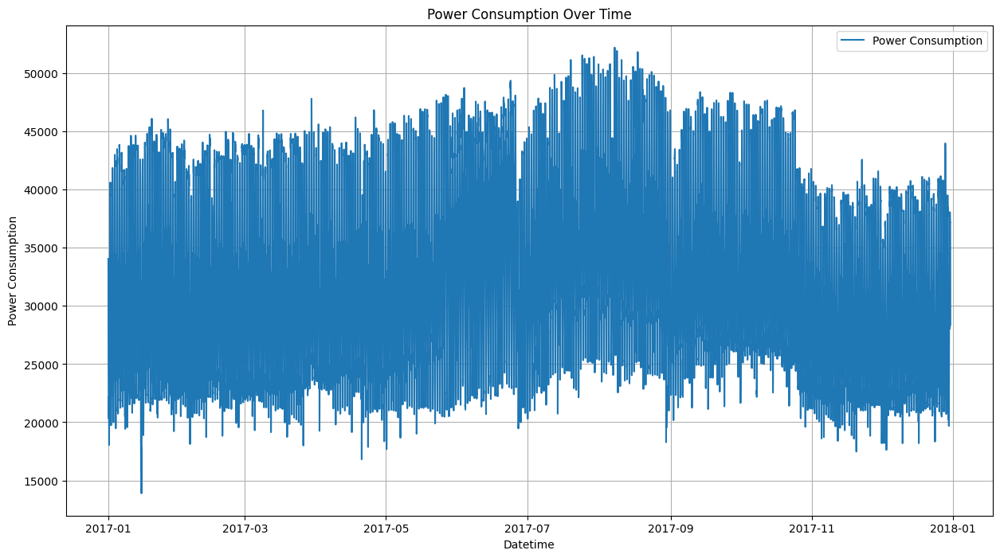

In [ ]:
plt.figure(figsize=(15, 8))
plt.plot(df['PowerConsumption_Zone1'], label='Power Consumption')
plt.xlabel('Datetime')
plt.ylabel('Power Consumption')
plt.title('Power Consumption Over Time')
plt.legend()
plt.grid(True)
plt.show()


**Objective**
- The plot shows the power consumption data over time.
- The x-axis represents the date and time, and the y-axis represents the power consumption.
- The overall trend of power consumption is observed.
- High and low consumption periods and patterns can be identified.

**Insights**
- Seasonal trends are shown like a wave.
- There is a noticeable increase in power consumption during the summer months (probably due to the overuse of cooling systems), and there is a noticeable decrease during middle-temperature periods.
- Since there are too many data points, it is difficult to find a clear trend.
- The data shows characteristics of white noise, which indicates many random fluctuations with no clear patterns.
- There are some significant spikes and drops in the graph. The reason might be some specific events or holidays.


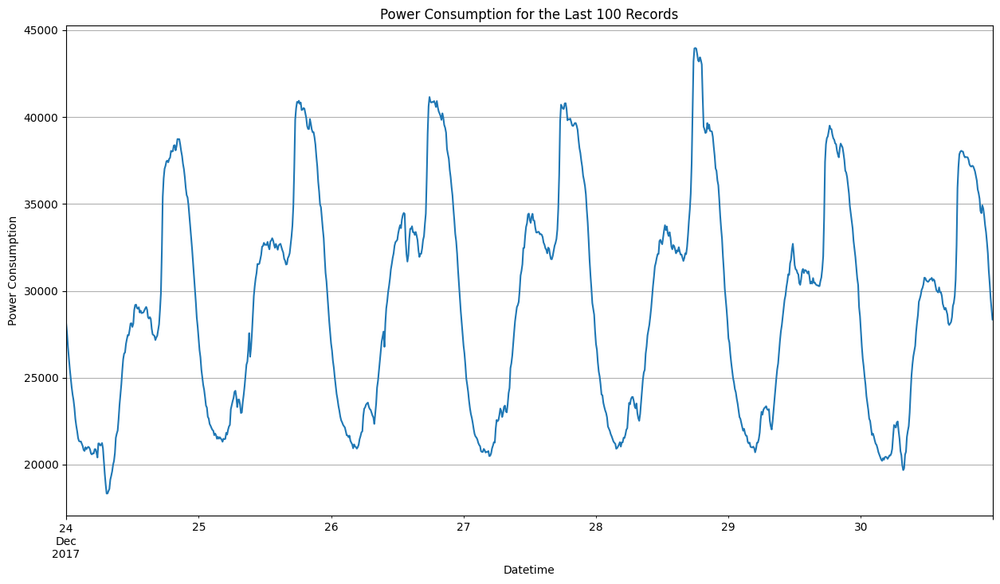

In [ ]:
df['PowerConsumption_Zone1'][-6*24*7:].plot(figsize=(15, 8))
plt.title('Power Consumption for the Last 100 Records')
plt.xlabel('Datetime')
plt.ylabel('Power Consumption')
plt.grid(True)
plt.show()

**Objective**
- The plot shows the power consumption data over the last 100 records.
- The x-axis represents the date and time, and the y-axis represents the power consumption.
- The short-term trends in power consumption are observed since the last 100 data points are used.
- Daily and weekly power consumption seasonality and some trends can be identified.


**Insights**
- The plot shows a distinct daily seasonality of power consumption, which is like a wave-like pattern.
- Around 4-5 pm power consumption tends to decrease.
- There is an increase in power consumption until around noon, probably due to the morning, and working time.
- There is a significant decrease in power consumption around midnight due to the sleeping hours.
- Peak usage times are shown clearly, and this indicates the time of higher power demand.


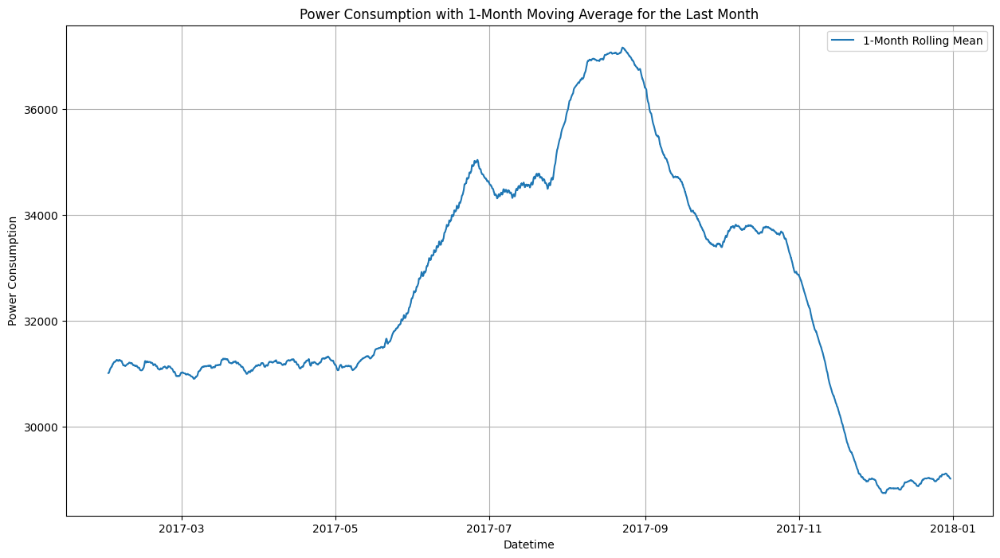

In [ ]:
# Set the figure size for the plot
plt.figure(figsize=(15, 8))

# Calculate the 1-month rolling mean (assuming hourly data and 30 days in a month)
rolling_mean = df['PowerConsumption_Zone1'].rolling(window=6*24*30).mean()

plt.plot(rolling_mean.index, rolling_mean, label='1-Month Rolling Mean')

# Add labels and title to the plot
plt.xlabel('Datetime')
plt.ylabel('Power Consumption')
plt.title('Power Consumption with 1-Month Moving Average for the Last Month')

# Display the plot
plt.legend()
plt.grid(True)
plt.show()

**Objective**
- The plot shows the power consumption data over time with a 1-month moving average.
- The x-axis represents the date and time, and the y-axis represents the power consumption.
- The overall trend of power consumption is observed with the moving average smoothing out short-term fluctuations.
- High and low consumption periods and patterns can be identified more clearly with the moving average.


**Insights**
- The plot shows a clear seasonal trend with power consumption increasing and decreasing like a wave.
- From May to July, the power consumption demand increases due to the summer season.
- From September to December, the power consumption demand decreases due to the winter season.
- Significant changes in power consumption, such as sharp rises and falls, may indicate specific events or changes in energy usage patterns during those periods.
- From summer to fall periods’ power consumption changes a lot such as significantly increasing and decreasing, compared to the seasons from winter to spring.


In [ ]:
print("Index of the lowest value:", rolling_mean.idxmin())

Index of the lowest value: 2017-12-05 05:30:00


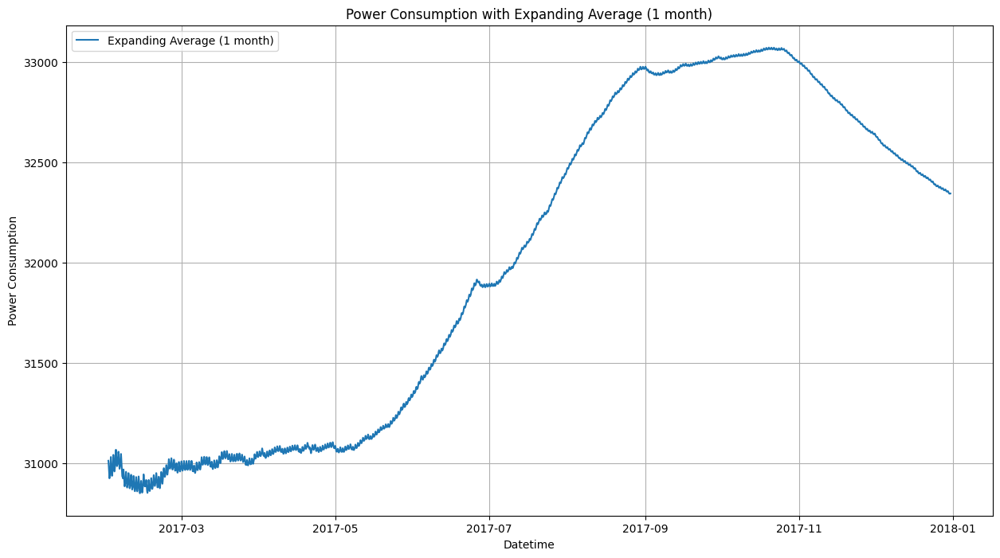

In [ ]:
expanding_mean = df['PowerConsumption_Zone1'].expanding(6*24*30).mean()

# Plot the expanding mean
plt.figure(figsize=(15, 8))
plt.plot(expanding_mean.index, expanding_mean, label='Expanding Average (1 month)')
plt.xlabel('Datetime')
plt.ylabel('Power Consumption')
plt.title('Power Consumption with Expanding Average (1 month)')
plt.legend()
plt.grid(True)

**Objective**
- The plot shows the power consumption data over time with a 1-month expanding average.
- The x-axis represents the date and time, and the y-axis represents the power consumption.
- The expanding average makes the data smooth by incorporating more observations, and it can make people see the long-term trend more easily.
- High and low consumption periods and overall trends can be identified.


**Insights**
- From May to September (the summer months), there is a clear increasing trend in power consumption because of cooling systems such as air conditioners.
- The peak is the summer, and the demand decreases after that.
- Although there is no significant increase from September to November, the demand is maintained.


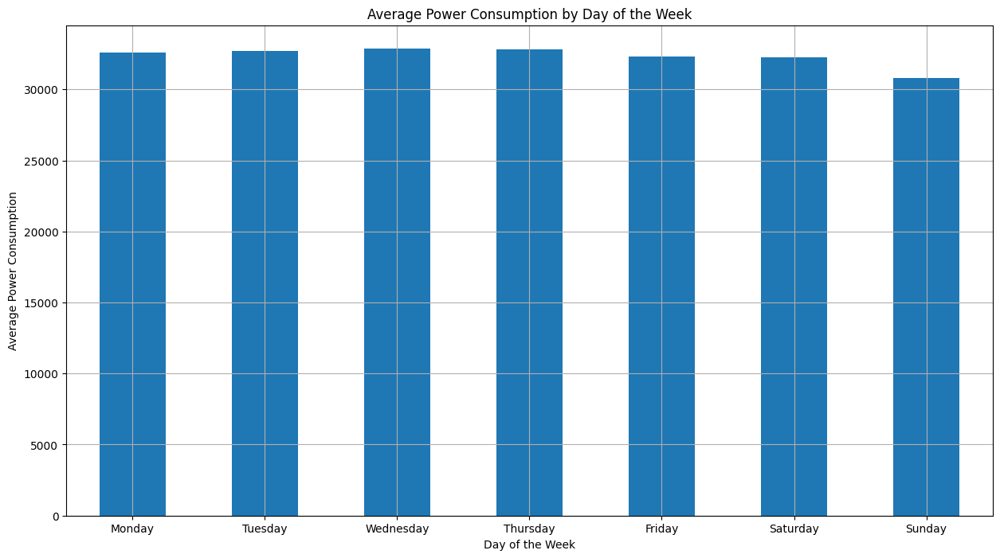

In [ ]:
# Create a new column for the day of the week
df['DayOfWeek'] = df.index.dayofweek

# Plot the average power consumption by day of the week
plt.figure(figsize=(15, 8))
ax = df.groupby('DayOfWeek')['PowerConsumption_Zone1'].mean().plot(kind='bar')
plt.title('Average Power Consumption by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Average Power Consumption')
ax.set_xticklabels(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'], rotation=0)
plt.grid(True)
plt.show()

**Objective**
- The bar graph shows the average power consumption by day of the week.
- The x-axis represents the days of the week, and the y-axis represents the average power consumption.
- It is easier to compare the power consumption on different days to identify any patterns or differences in usage.


**Insights**
- The average power consumption is almost consistent across all days of the week.
- Weekdays, from Monday to Saturday, tend to be in high demand compared to weekends, Saturday and Sunday.
- There is a slight decreasing pattern from Friday to Sunday (mostly weekends), probably due to human activities (work, school…).


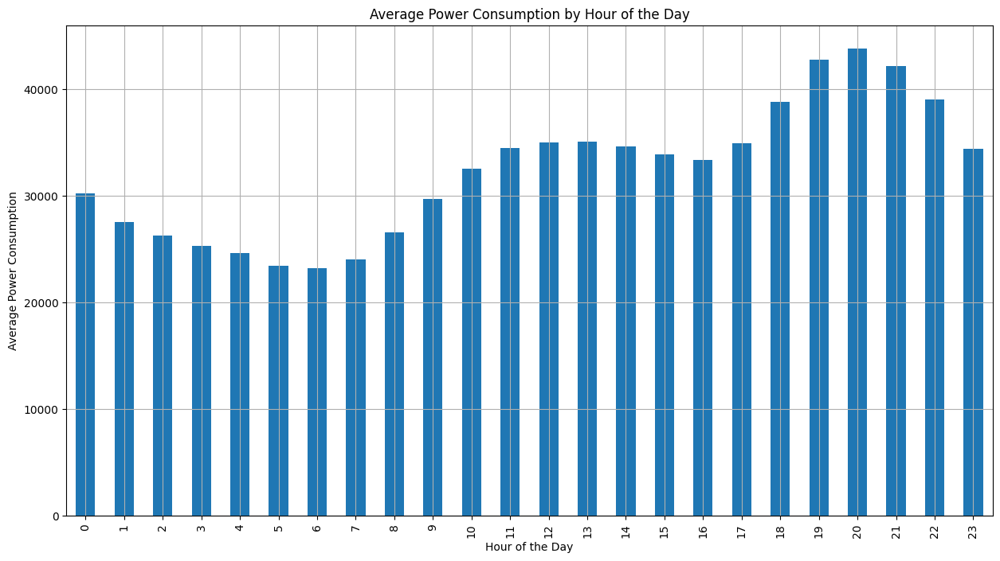

In [ ]:
df['HourOfDay'] = df.index.hour
plt.figure(figsize=(15, 8))
df.groupby('HourOfDay')['PowerConsumption_Zone1'].mean().plot(kind='bar')
plt.title('Average Power Consumption by Hour of the Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Average Power Consumption')
plt.grid(True)
plt.show()

**Objective**
- The bar graph shows the average power consumption by hour of the day.
- The x-axis represents the hours of the day, and the y-axis represents the average power consumption.
- It is easier to compare the power consumption to different hours to identify any patterns or differences in usage.


**Insights**
- The average power consumption is lowest during the early morning hours (1:00 am to 6:00 am) when most people are likely asleep and industrial activities are minimal.
- There is an increase in power consumption starting from 7 am, peaking between 7 pm and 9:00 pm, due to the industrial activities.
- There is a decrease in power consumption starting from 8:00 pm to 6:00 because of sleeping periods.
- The peak time in the day is 8:00, and the reason of this is probably due to the household activities and lighting.


<Figure size 1500x800 with 0 Axes>

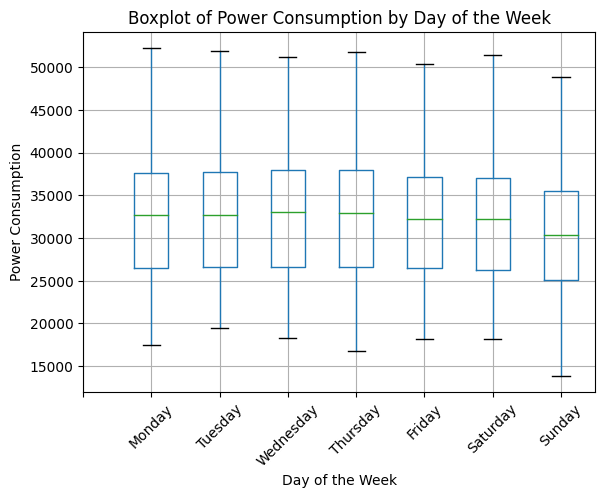

<Figure size 1500x800 with 0 Axes>

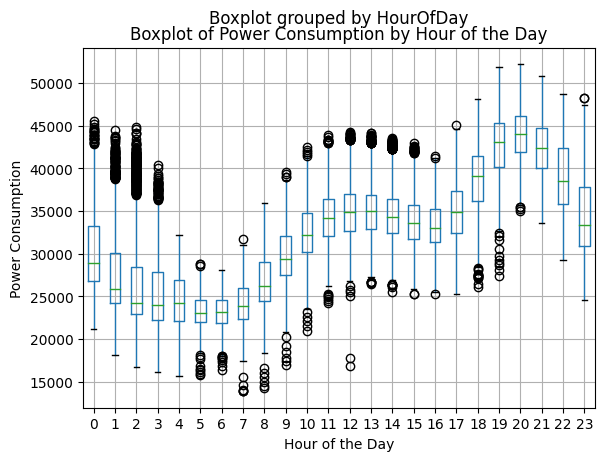

In [ ]:
# Boxplot of Traffic Volume by day of the week
plt.figure(figsize=(15, 8))
df.boxplot(column='PowerConsumption_Zone1', by='DayOfWeek')
plt.title('Boxplot of Power Consumption by Day of the Week')
plt.suptitle('')  # Suppress the automatic title to match the other plots
plt.xlabel('Day of the Week')
plt.ylabel('Power Consumption')
plt.xticks(ticks=range(8), labels=['', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'], rotation=45)
plt.grid(True)
plt.show()

# Boxplot of Traffic Volume by hour of the day
plt.figure(figsize=(15, 8))
df.boxplot(column='PowerConsumption_Zone1', by='HourOfDay')
plt.title('Boxplot of Power Consumption by Hour of the Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Power Consumption')
plt.grid(True)
plt.show()

**Technological Terms**
1. Median (Green Line) – The middle value of the data set when it is ordered from lowest to highest.
2. Interquartile Range (IQR) – The measurement of the statistical dispersion of the data. It is calculated as the difference between the 75th percentile (Q3) and the 25th percentile (Q1).
3. Quartiles (Q1 and Q3) – The data divided into four equal parts.
4. Whiskers – The whiskers extend from the quartiles to the minimum and maximum values within 1.5 times the IQR from the quartiles.
5. Outliers – The data points that fall outside the whiskers.


**Objective**
- The boxplot shows the distribution of power consumption by day of the week.
- The x-axis represents the days of the week, and the y-axis represents the - power consumption.
- The plot gives insights into the variability and distribution of power consumption for each day.


**Insights**
- The median power consumption is consistent across all days of the week although the weekend (Saturday and Sunday) median is a little low.
- There is some trend (decreasing as going weekends) when focused on IQR.
- The whiskers extend to similar ranges for each day, but it decreases as going weekends.


**Objective**
- The boxplot shows the distribution of power consumption by hour of the day.
- The x-axis represents the hours of the day, and the y-axis represents the power consumption.
- The plot provides insights into the variability and distribution of power consumption for each hour.



**Insights**
- Power consumption is highest during the evening hours (6:00 pm to 9:00 pm), with the median values peaking during these times, which means the activity of humans and demand increases.
- Early morning hours (1:00 am to 6:00 am) have the lowest median power consumption because of non-activity time.
- From 10:00 pm to 4:00 am, the IQR range tends to be longer compared to the activity duration.
- Many outliers can be seen in midnight and even activity durations, probably due to the unusual events, or holidays.


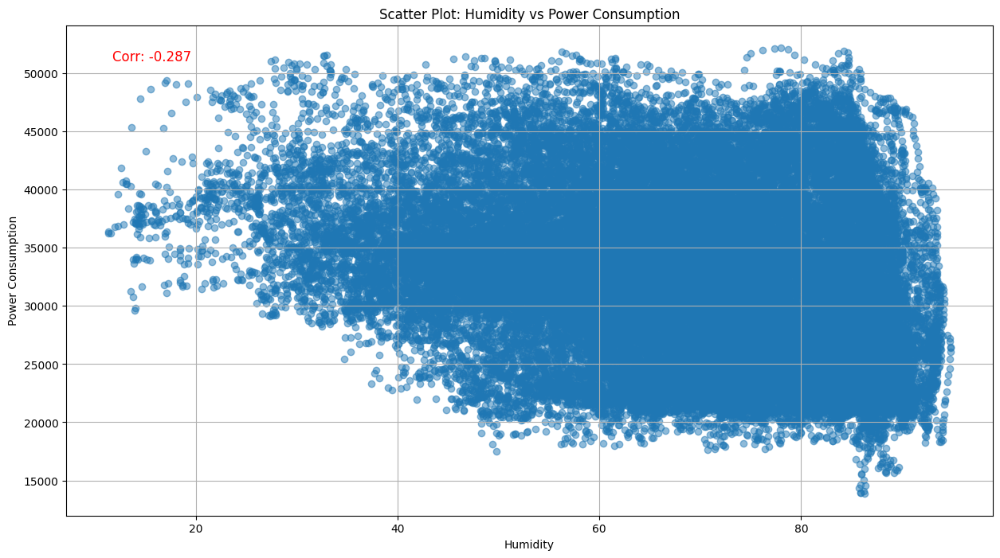

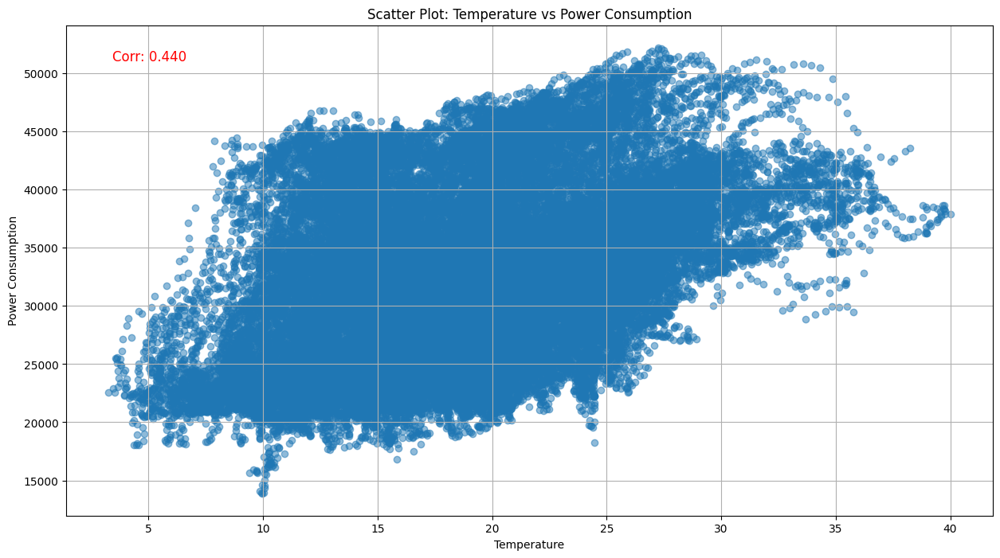

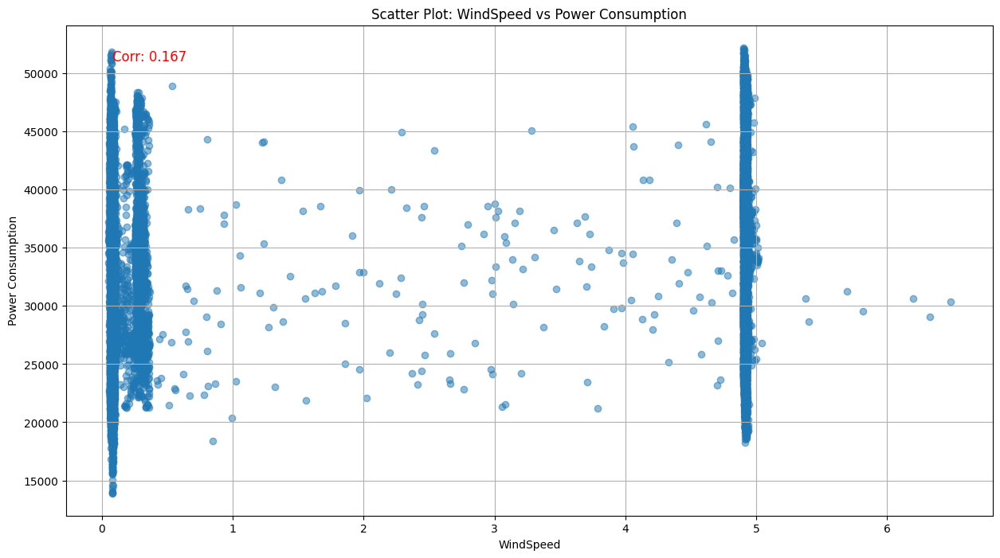

In [ ]:
corr_humidity = df['Humidity'].corr(df['PowerConsumption_Zone1'])

# Scatter plot of Humidity vs Power Consumption
plt.figure(figsize=(15, 8))
plt.scatter(df['Humidity'], df['PowerConsumption_Zone1'], alpha=0.5)
plt.title('Scatter Plot: Humidity vs Power Consumption')
plt.xlabel('Humidity')
plt.ylabel('Power Consumption')
plt.grid(True)
# Add correlation value to the plot
plt.annotate(f'Corr: {corr_humidity:.3f}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', va='top', fontsize=12, color='red')
plt.show()

# Calculate correlation for Temperature vs Power Consumption
corr_temperature = df['Temperature'].corr(df['PowerConsumption_Zone1'])

# Scatter plot of Temperature vs Power Consumption
plt.figure(figsize=(15, 8))
plt.scatter(df['Temperature'], df['PowerConsumption_Zone1'], alpha=0.5)
plt.title('Scatter Plot: Temperature vs Power Consumption')
plt.xlabel('Temperature')
plt.ylabel('Power Consumption')
plt.grid(True)
# Add correlation value to the plot
plt.annotate(f'Corr: {corr_temperature:.3f}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', va='top', fontsize=12, color='red')
plt.show()

# Calculate correlation for Temperature vs Power Consumption
corr_temperature = df['WindSpeed'].corr(df['PowerConsumption_Zone1'])

# Scatter plot of Temperature vs Power Consumption
plt.figure(figsize=(15, 8))
plt.scatter(df['WindSpeed'], df['PowerConsumption_Zone1'], alpha=0.5)
plt.title('Scatter Plot: WindSpeed vs Power Consumption')
plt.xlabel('WindSpeed')
plt.ylabel('Power Consumption')
plt.grid(True)
# Add correlation value to the plot
plt.annotate(f'Corr: {corr_temperature:.3f}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', va='top', fontsize=12, color='red')
plt.show()

**O​​bjective**
- The scatter plot shows the relationship between humidity and power consumption.
- The x-axis represents humidity, and the y-axis represents power consumption.
- This plot is to identify any correlation between humidity levels and power consumption.

**Insights**
- The correlation coefficient is -0.287, so it is a weak negative correlation between humidity and power consumption.
- As humidity increases, there is a slight tendency for power consumption to decrease, though the relationship is not very strong.
- The data points are many and widely scattered, which means that the data shows significant variability in power consumption at different humidity levels.
- Even though the correlation is weak, the power consumption and humidity are relevant.



**Objective**
- The scatter plot shows the relationship between temperature and power consumption.
- The x-axis represents temperature, and the y-axis represents power consumption.
- The plot aims to identify any correlation between temperature levels and power consumption.

**Insights**
- The correlation coefficient is 0.440, so it is a moderate positive correlation between temperature and power consumption.
- As temperature increases, there is a general tendency for power consumption to increase as well.
- There is a cluster of high power consumption values in the higher temperature range, indicating a consistent pattern of increased energy usage during hot weather.
- It is possible to say that the power consumption and temperature are relevant.


**Objective**
- The scatter plot shows the relationship between powerwind and power consumption.
- The x-axis represents powerwind, and the y-axis represents power consumption.
- The plot aims to identify any correlation between powerwind and power consumption.

**Insights**
- The correlation coefficient is 0.167, so basically, there is no correlation between them.


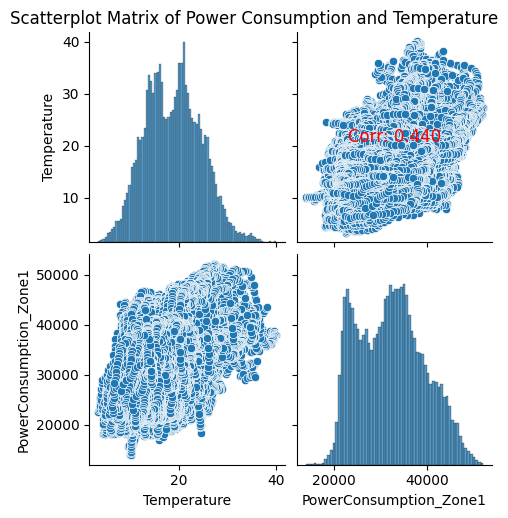

In [ ]:
# Select the relevant columns for the scatterplot matrix
selected_columns = ['Temperature', 'PowerConsumption_Zone1']
df_selected = df[selected_columns]

# Create the pair plot
g = sns.pairplot(df_selected)

# Add the correlation coefficients
def corrfunc(x, y, **kws):
    r = np.corrcoef(x, y)[0, 1]
    ax = plt.gca()
    ax.annotate(f'Corr: {r:.3f}', xy=(0.5, 0.5), xycoords='axes fraction', ha='center', va='center', fontsize=10)

for i, j in zip(*np.triu_indices_from(g.axes, 1)):
    g.axes[i, j].annotate(
        f'Corr: {df_selected.corr().iloc[i, j]:.3f}',
        xy=(0.5, 0.5),
        xycoords='axes fraction',
        ha='center',
        va='center',
        fontsize=12,
        color='red'
    )

plt.suptitle('Scatterplot Matrix of Power Consumption and Temperature', y=1.02)
plt.show()

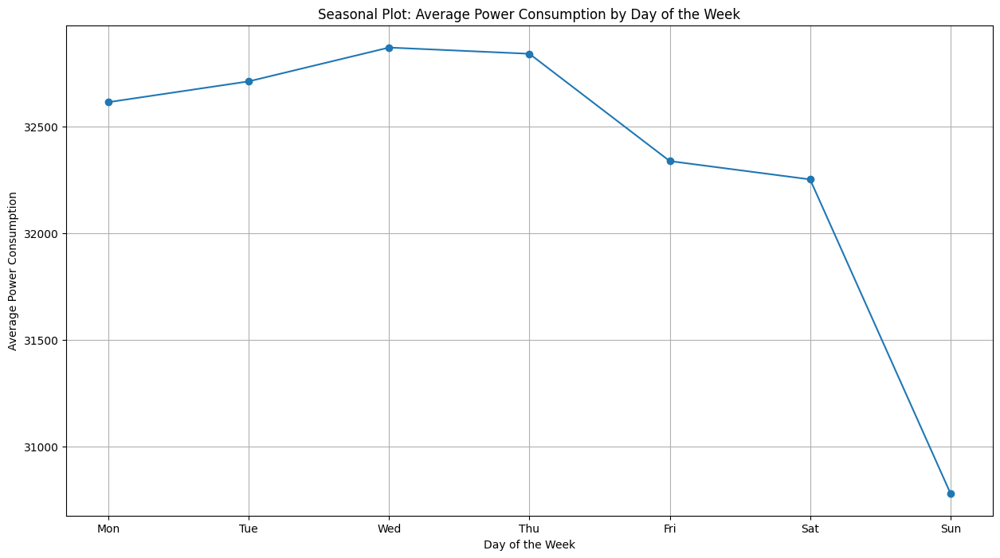

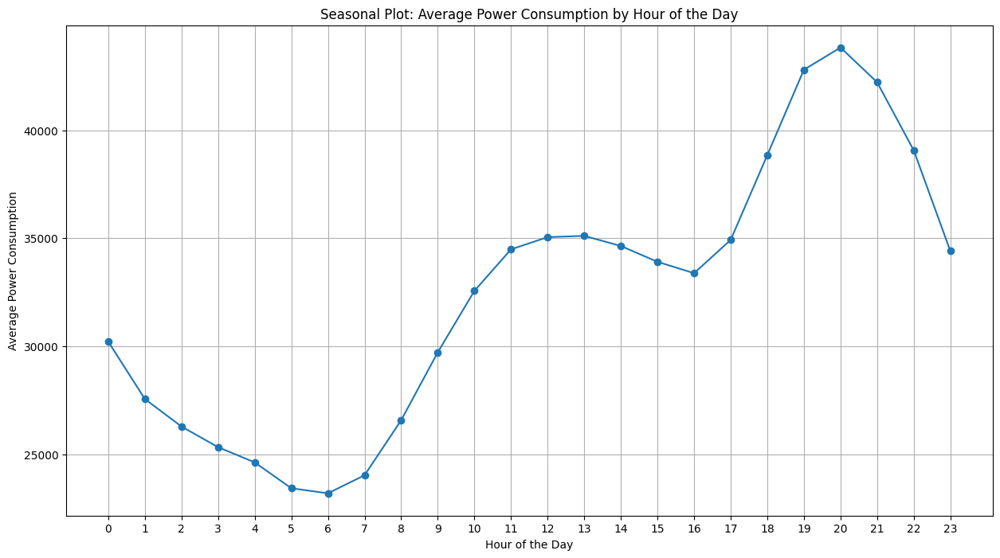

In [ ]:
# Set the style for the plots
# plt.style.use('seaborn-darkgrid')
# Assuming df is your DataFrame and it has a datetime index

# Seasonal Plot by Day of the Week
df['DayOfWeek'] = df.index.dayofweek
df['Week'] = df.index.isocalendar().week

# Calculate average power consumption for each day of the week across all weeks
avg_power_by_day = df.groupby('DayOfWeek')['PowerConsumption_Zone1'].mean()

plt.figure(figsize=(15, 8))
plt.plot(avg_power_by_day.index, avg_power_by_day, marker='o')
plt.title('Seasonal Plot: Average Power Consumption by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Average Power Consumption')
plt.xticks(range(7), ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'])
plt.grid(True)
plt.show()

# Seasonal Plot by Hour of the Day (Aggregated)
df['HourOfDay'] = df.index.hour
df['Day'] = df.index.date

# Calculate average power consumption for each hour of the day across all days
avg_power_by_hour = df.groupby('HourOfDay')['PowerConsumption_Zone1'].mean()

plt.figure(figsize=(15, 8))
plt.plot(avg_power_by_hour.index, avg_power_by_hour, marker='o')
plt.title('Seasonal Plot: Average Power Consumption by Hour of the Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Average Power Consumption')
plt.xticks(range(24))
plt.grid(True)
plt.show()


**Objective**
- The line plot shows the average power consumption by day of the week.
- The x-axis represents the days of the week, and the y-axis represents the average power consumption.
- The plot aims to identify any patterns or trends in power consumption across different days of the week.

**Insights**
- The plot shows a consistent pattern of higher power consumption during weekdays compared to weekends.
- Power consumption peaks on Wednesday, indicating that midweek has high energy usage.
- There is a significant decline in power consumption from Thursday to Sunday, with the lowest consumption on Sunday, likely due to less social activity.
- There is a potential to save power consumption on weekends.



**Objective**
- The line plot shows the average power consumption by hour of the day.
- The x-axis represents the hours of the day, and the y-axis represents the average power consumption.
- The plot aims to identify daily patterns or trends in power consumption.

**Insights**
- From 2:00 am to 6:00 am, power consumption is the lowest during the early morning hours.
- The highest power consumption is around 8:00 pm, due to household activities and lighting.
- Power consumption starts to decline after 9:00 pm as activities wind down for the day.


In [ ]:
# Display the column names to identify any issues with the 'Datetime' column
df.columns


Index(['Temperature', 'Humidity', 'WindSpeed', 'PowerConsumption_Zone1',
       'PowerConsumption_Zone2', 'DayOfWeek', 'HourOfDay', 'Week', 'Day'],
      dtype='object')

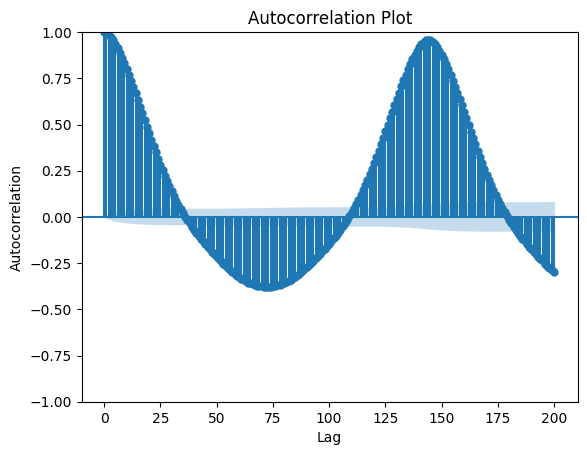

In [ ]:
# Create autocorrelation plot
plot_acf(df['PowerConsumption_Zone1'], lags=200)
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.title('Autocorrelation Plot')
plt.show()

**Objective**
- The autocorrelation plot is to identify the correlation between a time series and its past values.
- The x-axis represents the lag, and the y-axis represents the autocorrelation value.
- The plot aims to identify repeating patterns or periodicity in the power consumption data over time.
- Lag 0 indicates the correlation between the time series and itself shifted by one time. Thus, it has to be always 1.

**Insights**
- The autocorrelation plot shows a strong cyclical pattern, indicating predictability using forecasting models.
- The autocorrelation is almost 1 at lag 0.
- The autocorrelation decreases smoothly, reaching a minimum around lag 72.
- The pattern repeats, with autocorrelation increasing again and peaking around lag 144, indicating a strong positive correlation with a 144-lag period.
- There is a strong seasonality with a 1-day (144 lag) cycle.
- This information is helpful for using forecasting models to predict future power consumption.


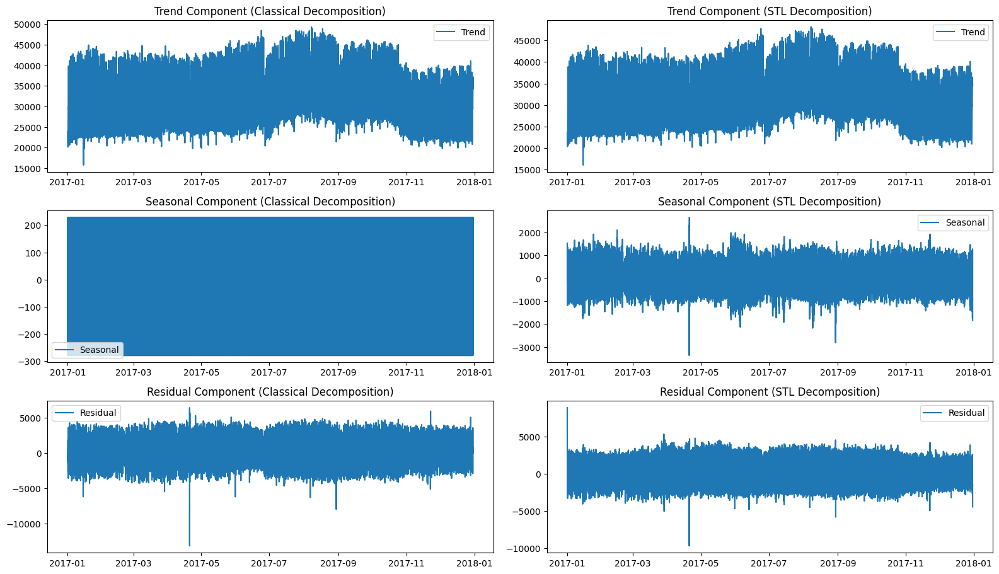

In [ ]:
# Perform classical decomposition of the 'PowerConsumption_Zone1' column
classical_decomposition = seasonal_decompose(df['PowerConsumption_Zone1'], model='additive', period=24)  # Assuming hourly data with daily seasonality

# Extract components: trend, seasonal, and residual
classical_trend = classical_decomposition.trend
classical_seasonal = classical_decomposition.seasonal
classical_residual = classical_decomposition.resid

# Perform Seasonal-Trend decomposition using Loess (STL) on the 'PowerConsumption_Zone1' column
stl = STL(df['PowerConsumption_Zone1'], period=24)  # Assuming hourly data with daily seasonality

# Fit the STL decomposition model
stl_result = stl.fit()

# Extract components: trend, seasonal, and residual
stl_trend = stl_result.trend
stl_seasonal = stl_result.seasonal
stl_residual = stl_result.resid

# Plotting
plt.figure(figsize=(16, 12))

# Classical Decomposition Components
plt.subplot(4, 2, 1)
plt.plot(df.index, classical_trend, label='Trend')
plt.title('Trend Component (Classical Decomposition)')
plt.legend()

plt.subplot(4, 2, 3)
plt.plot(df.index, classical_seasonal, label='Seasonal')
plt.title('Seasonal Component (Classical Decomposition)')
plt.legend()

plt.subplot(4, 2, 5)
plt.plot(df.index, classical_residual, label='Residual')
plt.title('Residual Component (Classical Decomposition)')
plt.legend()

# STL Decomposition Components
plt.subplot(4, 2, 2)
plt.plot(df.index, stl_trend, label='Trend')
plt.title('Trend Component (STL Decomposition)')
plt.legend()

plt.subplot(4, 2, 4)
plt.plot(df.index, stl_seasonal, label='Seasonal')
plt.title('Seasonal Component (STL Decomposition)')
plt.legend()

plt.subplot(4, 2, 6)
plt.plot(df.index, stl_residual, label='Residual')
plt.title('Residual Component (STL Decomposition)')
plt.legend()

plt.tight_layout()
plt.show()


**Objective**
- The plots show the decomposition of power consumption data into trend, seasonal, and residual components using both classical decomposition and Seasonal-Trend decomposition using LOESS (STL).
- The x-axis represents time, and the y-axis represents the values of each component.
- The goal is to understand the underlying patterns and variations in the power consumption data.

**Insights**
**Trend Component**
- Classical Decomposition:
  - The trend component shows a pattern in the data.
  - Power consumption increases steadily until mid-2017, then declines towards the end of the year.
- STL Decomposition:
  - The STL decomposition trend looks generally similar to the classical decomposition, showing similar patterns of increase and decrease over the year.

**Seasonal Component**
- Classical Decomposition:
  - The seasonal component appears to be constant.
- STL Decomposition:
  - The STL decomposition shows clear seasonal variations with repeating patterns and some unusual spikes, indicating unusual events or holidays.

**Residual Component**
- Classical Decomposition:
  - The residual component shows the remaining variation in the data after removing the trend and seasonal components. There are several spikes, indicating anomalies or outliers.
- STL Decomposition:
  - The STL residual component also shows spikes, but overall, the variations seem to be more uniformly distributed compared to the classical decomposition.


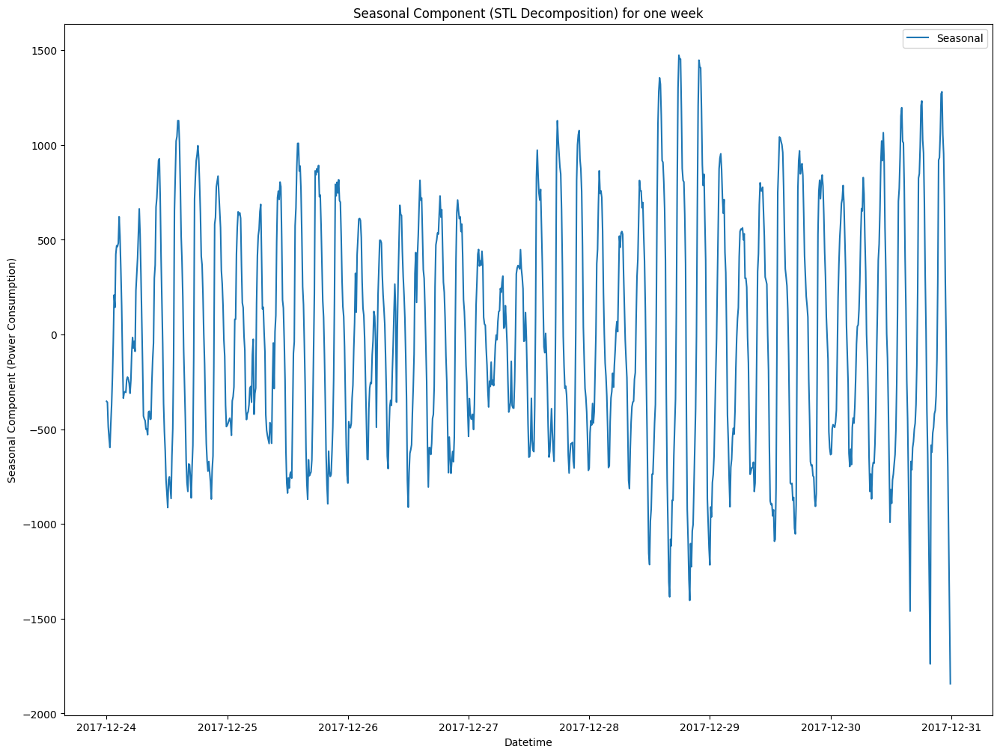

In [ ]:
# Plot the seasonal component (STL Decomposition) for the last five years
plt.figure(figsize=(16, 12))
plt.plot(df.index[-6*24*7:], stl_seasonal[-6*24*7:], label='Seasonal')
plt.title('Seasonal Component (STL Decomposition) for one week')
plt.xlabel('Datetime')
plt.ylabel('Seasonal Component (Power Consumption)')
plt.legend()
plt.show()

**Objective**
- The plot shows the seasonal component of the power consumption data for one week, as extracted using STL decomposition.
- The x-axis represents the date and time, and the y-axis represents the seasonal component of power consumption.
- The plot aims to highlight the periodic fluctuations in power consumption within a week.

**Insights**
- The seasonal component shows daily seasonality.
- Power consumption exhibits regular fluctuations, with peaks multiple times each day, likely corresponding to periods of high activity and energy usage.
- The amplitude of these daily cycles is significant, indicating strong daily seasonality.
- The seasonal variations are consistent across the week, with similar patterns observed each day.
- The amplitude varies depending on the day, with high cyclicality on December 29th and 31st.
- These insights can help in planning for peak demand periods and ensuring the stability of the power grid by anticipating regular fluctuations in energy consumption.


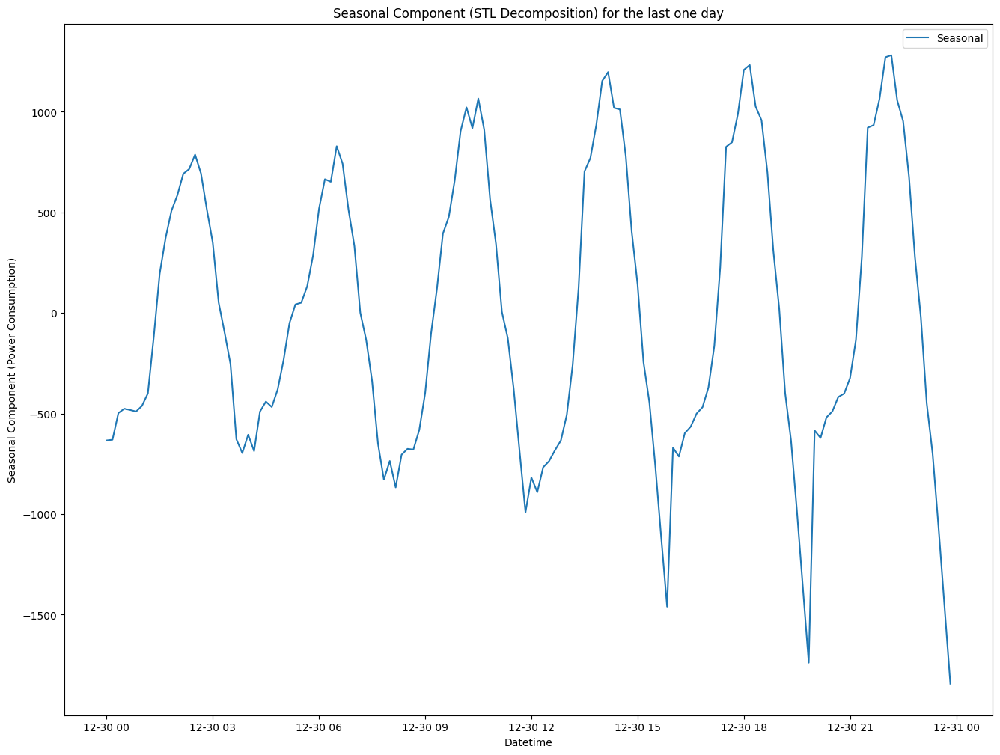

In [ ]:
# Plot the seasonal component (STL Decomposition) for the last five years
plt.figure(figsize=(16, 12))
plt.plot(df.index[-6*24:], stl_seasonal[-6*24:], label='Seasonal')
plt.title('Seasonal Component (STL Decomposition) for the last one day')
plt.xlabel('Datetime')
plt.ylabel('Seasonal Component (Power Consumption)')
plt.legend()
plt.show()

**Objective**
- The plot shows the seasonal component of the power consumption data for the last day, as extracted using STL decomposition.
- The x-axis represents the date and time, and the y-axis represents the seasonal component of power consumption.
- The plot aims to highlight the short-term periodic fluctuations in power consumption within an hour.

**Insights**
- The seasonal component shows clear short-term cycles within the hour.
- The amplitude of these short-term cycles is significant, it indicates strong seasonality.
- These insights are particularly useful for applications requiring real-time energy management and monitoring.


In [ ]:
def check_stationarity(data):
    # Perform ADF test
    adf_result = adfuller(data)
    adf_statistic = adf_result[0]
    adf_p_value = adf_result[1]

    # Print ADF results
    print("ADF Test:")
    print("ADF Statistic:", adf_statistic)
    print("p-value:", adf_p_value)
    if adf_p_value < 0.05:
        print("ADF Test Result: Data is stationary\n")
    else:
        print("ADF Test Result: Data is non-stationary\n")

    # Perform KPSS test
    kpss_result = kpss(data, regression='c', nlags="auto")
    kpss_statistic = kpss_result[0]
    kpss_p_value = kpss_result[1]

    # Print KPSS results
    print("KPSS Test:")
    print("KPSS Statistic:", kpss_statistic)
    print("p-value:", kpss_p_value)
    if kpss_p_value < 0.05:
        print("KPSS Test Result: Data is non-stationary\n")
    else:
        print("KPSS Test Result: Data is stationary\n")

# Example usage with your data
check_stationarity(df['PowerConsumption_Zone1'])

ADF Test:
ADF Statistic: -32.12127853462604
p-value: 0.0
ADF Test Result: Data is stationary

KPSS Test:
KPSS Statistic: 6.018599702888408
p-value: 0.01
KPSS Test Result: Data is non-stationary



- Stationarity is that the statistical properties of the series (mean, variance) are constant over time.
- Stationarity has to be checked because the data with non-stationality can lead to unreliable statistical properties.
- The ADF and KPSS test is to determine if a time series is stationary or not.
- If the ADF test p-value < 0.05, the data is stationry.
- If the KPSS test p-value >= 0.05, the data is stationry.
- If the ADF test p-value >= 0.05, the data is non-stationry.
- If the KPSS test p-value < 0.05, the data is non-stationry.
- p-value is the probability value for the test.


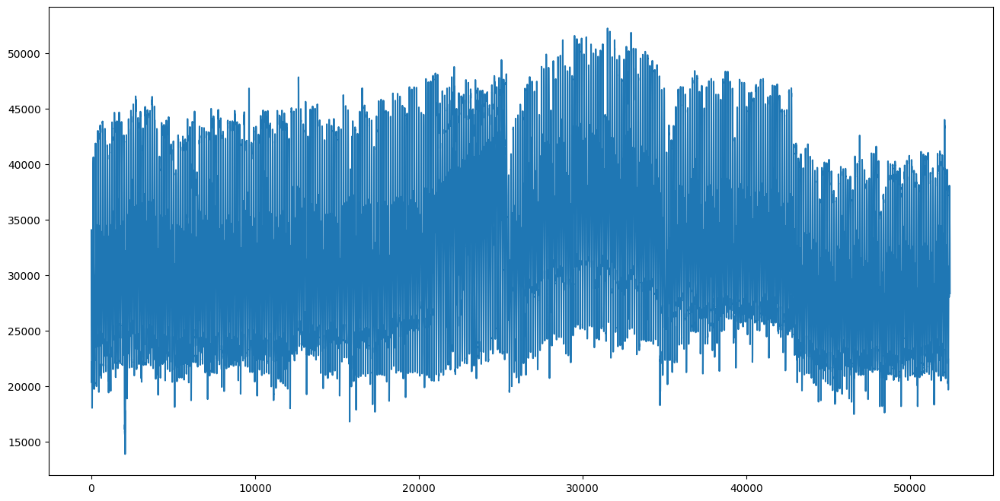

In [ ]:
df.PowerConsumption_Zone1.plot(figsize=(16, 8));

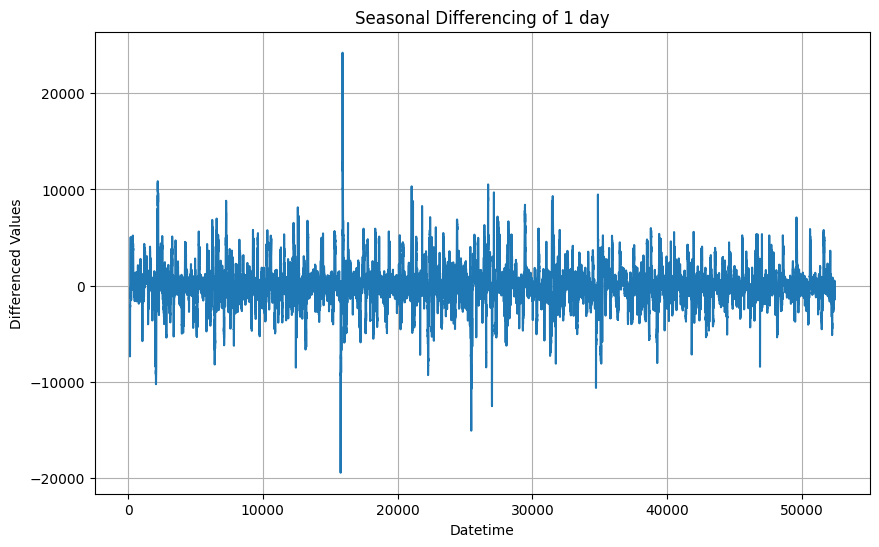

In [ ]:
data = pd.read_csv('powerconsumption.csv', parse_dates=['Datetime'], index_col='Datetime')

# Compute seasonal differencing of 12 months for the 'LandAverageTemperature' column
seasonal_diff = df['PowerConsumption_Zone1'].diff(6*24)

# Plot the differenced column
plt.figure(figsize=(10, 6))
plt.plot(seasonal_diff)
plt.title('Seasonal Differencing of 1 day')
plt.xlabel('Datetime')
plt.ylabel('Differenced Values')
plt.grid(True)
plt.show()

- This analysis applies seasonal differencing to the power consumption data because the KPSS test indicated non-stationarity in the original data.
- Seasonal differencing is to remove seasonal patterns to make the data more suitable for time series modeling.
- The goal was to remove the seasonal component and stabilize the mean of the time series.
- The data shows that the seasonality has been reduced and removed.
- This plot still has some noise and variability to be more random and less systematic.


In [ ]:
second_diff = seasonal_diff.diff().dropna()
print("Checking stationarity of second order differenced data:")
check_stationarity(second_diff)

Checking stationarity of second order differenced data:
ADF Test:
ADF Statistic: -38.852083931348
p-value: 0.0
ADF Test Result: Data is stationary

KPSS Test:
KPSS Statistic: 0.004594084163975917
p-value: 0.1
KPSS Test Result: Data is stationary



- After the second-order differencing, both ADF test and KPSS test show that tha data is stationaly.
- p-value of 0.0 shows a strong rejection of non-stationarity.
- Stationary data usually results in more accurate forecasts.


In [ ]:
# Compute the absolute minimum value of the seasonal differenced data
add_value = round(abs(second_diff.min()))

# Print the value to be subtracted after developing the model
print(f"This value has to be subtracted after developing our model = {add_value}")

# Add the absolute minimum value to the seasonal differenced data
second_diff += add_value

This value has to be subtracted after developing our model = 19555


- This is the absolute minimum value of the differencing data to ensure seasonal differencing data is more suitanle for modeling


# Time Series Forecasting with Various Models



### Data Preprocessing
1. **Differencing for Stationarity:**
- Purpose: Non-stationary data can adversely affect the performance of forecasting models.
- Method: To make the data stationary, differencing is applied. Specifically, a 24-hour seasonal differencing was used.
2. **Downsampling:**
- Purpose: High-frequency data can be complex and computationally expensive to model (time consuming). Downsampling reduces the data's frequency, and it simplifies the analysis and modeling process.
- Method: The data is resambled to an hourly frequency by averaging the values within each hour. (The original data is every 10 minuetes)

### Model Training
3. **Early Stopping:**
- Purpose: Early stopping is used to prevent overfitting. It stops the training process when the model's performance on a validation set starts to degrade.
- Method: An early stopping callback was implemented with a patience of 10 epochs. This means the training stops if the validation loss does not improve for 10 consecutive epochs.


### Multi-Input Models
4. **Incorporating Temperature Data:**
- Purpose: Power consumption is influenced by various factors, including temperature. By incorporating temperature as an additional input, improving the model's predictive capability is aimed.
- Method: In the multi-input models, both power consumption and temperature data were used as inputs. This approach finds the correlation between temperature and power consumption.
- Correlation Analysis: A correlation analysis was performed, and it was a correlation coefficient of 0.440 between temperature and power consumption. This moderate positive correlation indicates that temperature is a valuable predictor for power consumption.

### Forecasting Models
1. **Simple Forecasting Models:**
- Purpose: To establish a baseline, simple forecasting models, which are mean, naive, and seasonal naive were implemented.
- Method: These models predict future values based on basic assumptions and historical data patterns.

2. **Autoregressive (AR) Models:**
- Purpose: AR models predict future values based on past values of the time series.
- Method: The AR model was fitted using the statsmodels library, and it specifies the order of the autoregression.

3. **Moving Average (MA) Models:**
- Purpose: MA models predict future values based on past forecast errors.
- Method: The MA model was fitted using the statsmodels library, and it specifies the order of the moving average.


4. **Autoregressive Integrated Moving Average (ARIMA) Models:**
- Purpose: ARIMA models combine AR and MA models along with differencing to handle non-stationary data.
- Method: The ARIMA model was fitted using the statsmodels library, and it specifies the orders of autoregression, differencing, and moving average.

5. **Seasonal ARIMA (SARIMA) Models:**
- Purpose: SARIMA models extend ARIMA models by including seasonal components.
- Method: The SARIMA model was fitted using the statsmodels library, and it specifies the orders of autoregression, differencing, moving average, and seasonal components.

6. **Holt-Winters Exponential Smoothing:**
- Purpose: Holt-Winters method is used for forecasting time series data that exhibit both trend and seasonality.
- Method: The model was implemented using the statsmodels library, and it specifies the trend and seasonal components.

### Neural Network Architectures
1. **Multilayer Perceptrons (MLP):**
- Purpose: MLPs serve as a baseline model for comparison. They are simple neural networks that can handle tabular data well.
- Implementation: MLP models were implemented with varying complexities, including single-layer and multi-layer structures, to capture the relationships in the data.
2. **Convolutional Neural Networks (CNN):**
- Purpose: CNNs are effective in capturing local patterns in data.
- Implementation: The CNN model includes Conv1D layers followed by pooling layers to extract and downsample features.
3. **Long Short-Term Memory Networks (LSTM):**
- Purpose: LSTMs are designed to handle sequential data and capture long-term dependencies.
- Implementation: Several LSTM architectures were explored, including Vanilla LSTM, Stacked LSTM, Bidirectional LSTM, and Encoder-Decoder LSTM models. Each architecture is tried to capture different aspects of the temporal dependencies in the data.


# 2. Simple Models

In [ ]:
class TSMean:
    def __init__(self, series):
        """
        Initialize TSMean with the given time series.

        Parameters:
        series (pandas Series): Time series data.
        """
        # Calculate the mean of the series
        self.mean = series.mean()

    def forecast(self, steps):
        """
        Generate forecasts using the mean value.

        Parameters:
        steps (int): Number of steps to forecast.

        Returns:
        list: List of forecasted values.
        """
        # Return a list containing the mean value repeated for the specified number of steps
        return [self.mean] * steps

class TSNaive:
    def __init__(self, series):
        """
        Initialize TSNaive with the given time series.

        Parameters:
        series (pandas Series): Time series data.
        """
        # Store the last observed value of the series
        self.last_value = series.iloc[-1]

    def fit(self):
        """
        Fit the model (no action needed for naive method).

        Returns:
        self: Returns self.
        """
        return self

    def forecast(self, steps):
        """
        Generate forecasts using the last observed value.

        Parameters:
        steps (int): Number of steps to forecast.

        Returns:
        list: List of forecasted values.
        """
        # Return a list containing the last observed value repeated for the specified number of steps
        return [self.last_value] * steps
class TSNaiveSeasonal:
    def __init__(self, series, period):
        """
        Initialize TSNaiveSeasonal with the given time series and seasonal period.

        Parameters:
        series (pandas Series): Time series data.
        period (int): Seasonal period of the time series.
        """
        # Store the seasonal period and values of the series
        self.period = period
        self.values = series.values

    def forecast(self, steps):
        """
        Generate seasonal naive forecasts.

        Parameters:
        steps (int): Number of steps to forecast.

        Returns:
        list: List of forecasted values.
        """
        # Generate forecasts by repeating the last observed value from the corresponding season
        seasonal_forecast = []
        for i in range(steps):
            index = len(self.values) - (i % self.period) - 1
            seasonal_forecast.append(self.values[index])
        return seasonal_forecast[::-1]

class TSDrift:
    def __init__(self, series):
        """
        Initialize TSDrift with the given time series.

        Parameters:
        series (pandas Series): Time series data.
        """
        # Calculate the linear regression parameters
        self.x_start = 0
        self.x_end = len(series) - 1
        self.y_start = series.iloc[0]
        self.y_end = series.iloc[-1]
        self.slope = (self.y_end - self.y_start) / (self.x_end - self.x_start)
        self.intercept = self.y_start - self.slope * self.x_start
    def forecast(self, steps):
        """
        Generate forecasts using the linear regression (drift) method.

        Parameters:
        steps (int): Number of steps to forecast.

        Returns:
        list: List of forecasted values.
        """
        # Generate forecasts by extending the linear regression line into the future
        forecast_values = [self.intercept + self.slope * (self.x_end + i) for i in range(1, steps + 1)]
        return forecast_values


The used models are as follows:
1. **TSMean Model**
- This model uses the mean of the historical data.
2. **TSNaive Model**
- This model uses the last observed value.
3. **TSNaiveSeasonal Model**
- This model uses the last observed value from the corresponding season.
4. **TSDrift Model**
- This model uses a linear trend observed in the historical data.


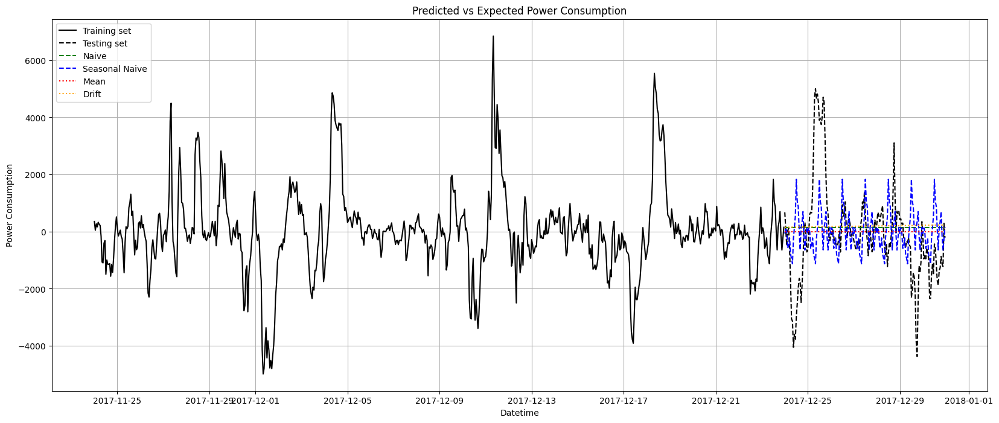

In [ ]:
# Difference the data to make it stationary

df['PowerConsumption_Zone1_diff'] = df['PowerConsumption_Zone1'].diff().dropna()
# Define the training and testing periods (with data points every 10 minutes)
test_period = 7 * 24 * 6  # Last week (7 days * 24 hours * 6 (10-minute intervals per hour))
train_period = -test_period  # All data except the last week

# Downsample the data to an hourly frequency
hourly_data = data.resample('H').mean()

# Compute seasonal differencing of 24 hours for the 'PowerConsumption_Zone1' column
hourly_data['PowerConsumption_Zone1_diff'] = hourly_data['PowerConsumption_Zone1'].diff(24).dropna()


# Define the training and testing periods (with data points every hour)
test_period = 7 * 24  # Last week (7 days * 24 hours)
train_period = -test_period  # All data except the last week

# Split the data into training and testing sets
Train = hourly_data['PowerConsumption_Zone1_diff'][:train_period].dropna()
Test = hourly_data['PowerConsumption_Zone1_diff'][train_period:].dropna()


# Initialize the models
m = TSMean(Train)
n = TSNaive(Train).fit()
s = TSNaiveSeasonal(Train, 24 )  # Seasonal period adjusted to 1 week
dr = TSDrift(Train)

# Calculate forecasted values
forecast_naive = n.forecast(test_period)
forecast_seasonal = s.forecast(test_period)
forecast_mean = m.forecast(test_period)
forecast_drift = dr.forecast(test_period)

# Plotting
fig, ax = plt.subplots(figsize=(20, 8))
ax.plot(Train[-30 * 24 :], 'k', label='Training set')  # Plot the last 30 days of the training set for better visualization
ax.plot(Test, 'k', linestyle='--', label='Testing set')
ax.plot(Test.index, forecast_naive, color='green', label='Naive', linestyle='--')
ax.plot(Test.index, forecast_seasonal, color='blue', label='Seasonal Naive', linestyle='--')
ax.plot(Test.index, forecast_mean, color='red', label='Mean', linestyle='dotted')
ax.plot(Test.index, forecast_drift, color='orange', label='Drift', linestyle=':')
ax.legend(loc='upper left')
ax.grid()
plt.title('Predicted vs Expected Power Consumption')
plt.xlabel('Datetime')
plt.ylabel('Power Consumption')
plt.show()


- This analysis visualize the forecasts by 4 nodels.
- The last 720 observations (1 month) of the power consumption data is represented.

The visualized forecasting has 4 observations as follows:
1. **Naive forecast**
- The data shows one stable line for prediction.
- This forecast does not get any trends, seasonality or cyclicity in the traffic volume data.
2. **Seasonal naive forecast**
- the data shows the observed value from the corresponding period in the past 1 week ago, which means 1008 observations.
- The model just repreats daily pattern in power consumption.
3. **Mean forecast**
- This data shows the one stable line for prediction.
- This forecast does not get any trends, seasonality or cyclicity in the traffic volume data.
4. **Drift forecast**
- This data shows one line (linear) based on the start points and endpoints of the training data.
- The models only predicts the consistent trend.


- differencing data is used for below models since the actual data is not stationality.

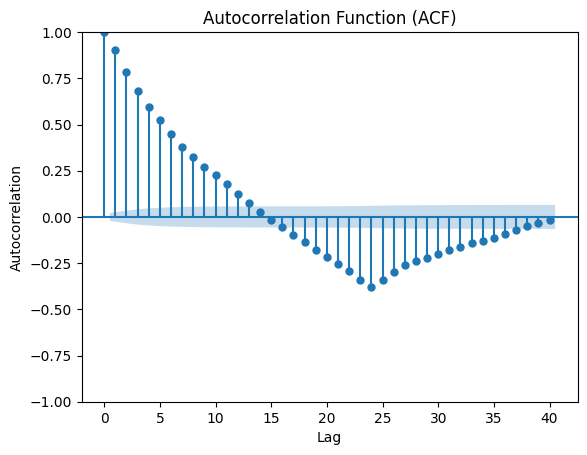

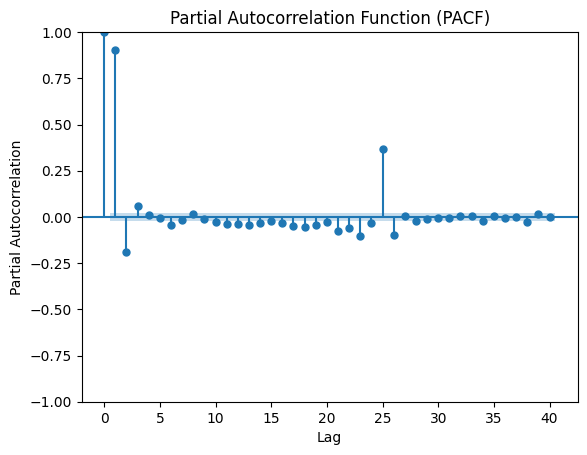

In [ ]:
# Plot ACF
plot_acf(Train, lags=40)
plt.title('Autocorrelation Function (ACF)')
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

# Plot PACF
plot_pacf(Train, lags=40)
plt.title('Partial Autocorrelation Function (PACF)')
plt.xlabel('Lag')
plt.ylabel('Partial Autocorrelation')
plt.show()

In [ ]:
# Print information about the data
print('Observations: {}'.format(len(df)))
print('Training Observations: {}'.format(len(Train)))
print('Testing Observations: {}'.format(len(Test)))

Observations: 52416
Training Observations: 8544
Testing Observations: 168


In [ ]:
# Calculate RMSE, MAE, MAPE for each model
def calculate_metrics(true_values, forecasted_values):
    rmse = np.sqrt(mean_squared_error(true_values, forecasted_values))
    mae = mean_absolute_error(true_values, forecasted_values)
    mape = np.mean(np.abs((true_values - forecasted_values) / true_values)) * 100
    return [rmse, mae, mape]

In [ ]:
naive_metrics = calculate_metrics(Test, forecast_naive)
seasonal_metrics = calculate_metrics(Test, forecast_seasonal)
mean_metrics = calculate_metrics(Test, forecast_mean)
drift_metrics = calculate_metrics(Test, forecast_drift)

# Create a DataFrame to store the results
results = pd.DataFrame({
    'Model': ['Naive', 'Seasonal Naive', 'Mean', 'Drift'],
    'RMSE': [naive_metrics[0], seasonal_metrics[0], mean_metrics[0], drift_metrics[0]],
    'MAE': [naive_metrics[1], seasonal_metrics[1], mean_metrics[1], drift_metrics[1]],
    'MAPE (%)': [naive_metrics[2], seasonal_metrics[2], mean_metrics[2], drift_metrics[2]]
})
results.set_index('Model', inplace=True)
results

,RMSE,MAE,MAPE (%)
Model,,,
Naive,1712.072470,1188.279317,181.208019
Seasonal Naive,1825.429688,1287.102420,274.270866
Mean,1695.014795,1149.035242,100.517539
Drift,1724.262372,1204.868287,200.338491


- This code calculates: Root Mean Squared Error (RMSE), Mean Absolute Error (MAE) and Mean Absolute Percentage Error (MAPE).
- RMSE is used to measure the average magnitude of the error.
- the square root is used to bring the units of the error back to the same scale as the original values, and it makes the interpretation easier.
- MAE does not consider direction, which are positive or negative.
- MAPE is used to measure the average percentage error between the forecasted and actual values.


# 3. AR Model

In [ ]:
# Train autoregression model
model = AutoReg(Train, lags=24*30)  # Create an autoregression model with 25 lags
model_fit = model.fit()  # Fit the autoregression model to the training data
print('Coefficients: %s' % model_fit.params)  # Print the coefficients of the fitted model

Coefficients: const                              -2.064038
PowerConsumption_Zone1_diff.L1      1.060135
PowerConsumption_Zone1_diff.L2     -0.256330
PowerConsumption_Zone1_diff.L3      0.057655
PowerConsumption_Zone1_diff.L4      0.014674
                                      ...   
PowerConsumption_Zone1_diff.L716   -0.011566
PowerConsumption_Zone1_diff.L717   -0.003803
PowerConsumption_Zone1_diff.L718    0.028617
PowerConsumption_Zone1_diff.L719   -0.031213
PowerConsumption_Zone1_diff.L720    0.006430
Length: 721, dtype: float64


- This code trains the autoregression (AR) model.

In [ ]:
model_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 AutoReg Model Results                                 
=======================================================================================
Dep. Variable:     PowerConsumption_Zone1_diff   No. Observations:                 8544
Model:                            AutoReg(720)   Log Likelihood              -61520.822
Method:                        Conditional MLE   S.D. of innovations            629.013
Date:                         Mon, 24 Jun 2024   AIC                         124485.644
Time:                                 16:37:04   BIC                         129514.338
Sample:                             02-01-2017   HQIC                        126208.802
                                  - 12-23-2017                                         
====================================================================================================
                                       coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                               -2.0640      7.138     -0.289      0.772     -16.054      11.926
PowerConsumption_Zone1_diff.L1       1.0601      0.011     93.773      0.000       1.038       1.082
PowerConsumption_Zone1_diff.L2      -0.2563      0.016    -15.561      0.000      -0.289      -0.224
PowerConsumption_Zone1_diff.L3       0.0577      0.017      3.448      0.001       0.025       0.090
PowerConsumption_Zone1_diff.L4       0.0147      0.017      0.877      0.381      -0.018       0.047
PowerConsumption_Zone1_diff.L5       0.0035      0.017      0.208      0.835      -0.029       0.036
PowerConsumption_Zone1_diff.L6       0.0005      0.017      0.031      0.975      -0.032       0.033
PowerConsumption_Zone1_diff.L7      -0.0170      0.017     -1.018      0.309      -0.050       0.016
PowerConsumption_Zone1_diff.L8       0.0108      0.017      0.645      0.519      -0.022       0.044
PowerConsumption_Zone1_diff.L9      -0.0016      0.017     -0.094      0.925      -0.034       0.031
PowerConsumption_Zone1_diff.L10      0.0057      0.017      0.343      0.731      -0.027       0.039
PowerConsumption_Zone1_diff.L11      0.0219      0.017      1.307      0.191      -0.011       0.055
PowerConsumption_Zone1_diff.L12     -0.0058      0.017     -0.348      0.728      -0.039       0.027
PowerConsumption_Zone1_diff.L13      0.0124      0.017      0.742      0.458      -0.020       0.045
PowerConsumption_Zone1_diff.L14     -0.0341      0.017     -2.038      0.042      -0.067      -0.001
PowerConsumption_Zone1_diff.L15      0.0118      0.017      0.703      0.482      -0.021       0.045
PowerConsumption_Zone1_diff.L16      0.0229      0.017      1.366      0.172      -0.010       0.056
PowerConsumption_Zone1_diff.L17     -0.0112      0.017     -0.672      0.502      -0.044       0.022
PowerConsumption_Zone1_diff.L18     -0.0245      0.017     -1.466      0.143      -0.057       0.008
PowerConsumption_Zone1_diff.L19     -0.0092      0.017     -0.552      0.581      -0.042       0.024
PowerConsumption_Zone1_diff.L20      0.0372      0.017      2.220      0.026       0.004       0.070
PowerConsumption_Zone1_diff.L21     -0.0311      0.017     -1.859      0.063      -0.064       0.002
PowerConsumption_Zone1_diff.L22      0.0314      0.017      1.873      0.061      -0.001       0.064
PowerConsumption_Zone1_diff.L23      0.0377      0.017      2.252      0.024       0.005       0.071
PowerConsumption_Zone1_diff.L24     -0.6821      0.017    -40.719      0.000      -0.715      -0.649
PowerConsumption_Zone1_diff.L25      0.7084      0.018     38.414      0.000       0.672       0.744
PowerConsumption_Zone1_diff.L26     -0.1825      0.020     -9.076      0.000      -0.222      -0.143
PowerConsumption_Zone1_diff.L27      0.0512      0.020      2.536      0.011       0.012       0.091
PowerConsumption_Zone1_diff.L

predicted=520.874025, expected=672.243347
predicted=9.931155, expected=67.934093
predicted=-182.152936, expected=-483.650192
predicted=102.431854, expected=22.306718
predicted=82.661202, expected=121.673003
predicted=-190.455649, expected=-612.420785
predicted=-628.253820, expected=-1776.425858
predicted=-1028.196368, expected=-3057.034222
predicted=-1287.000207, expected=-3138.149557
predicted=-1957.093727, expected=-4049.683145
predicted=-2311.819521, expected=-3591.381497
predicted=-2383.986864, expected=-3766.793408
predicted=-2174.305940, expected=-2998.225603
predicted=-2000.724502, expected=-2508.491762
predicted=-1818.679301, expected=-1981.242078
predicted=-1575.092465, expected=-1639.543723
predicted=-946.479318, expected=-1751.077310
predicted=-1207.169734, expected=-2479.087450
predicted=-1364.229506, expected=-1858.555133
predicted=-1044.698003, expected=-1071.736375
predicted=-142.036785, expected=263.624842
predicted=436.484461, expected=305.196453
predicted=-175.643934,

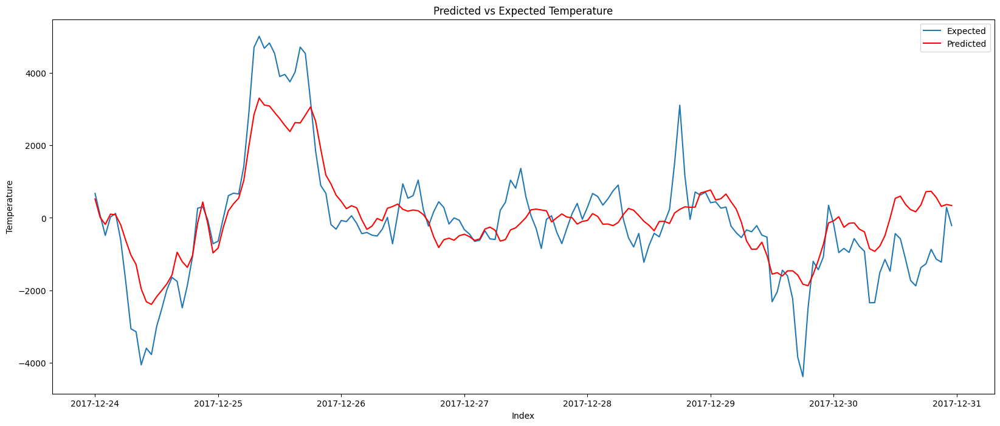

In [ ]:
# Make predictions using the fitted model
predictions = model_fit.predict(start=len(Train), end=len(Train)+len(Test)-1, dynamic=False).values

# Print predicted and expected values
for i in range(len(predictions)):
    print('predicted=%f, expected=%f' % (predictions[i], Test.iloc[i]))

# Plot predictions vs expected
plt.figure(figsize=(20, 8))
plt.plot(Test.index, Test, label='Expected')
plt.plot(Test.index, predictions, color='red', label='Predicted')
plt.xlabel('Index')
plt.ylabel('Temperature')
plt.title('Predicted vs Expected Temperature')
plt.legend();

- The predicted values and expected values are closely followed, which means model was able to capture the underlying patterns in the data.
- The model does not predict the highest spikes and overpredict the lowest troughs.


In [ ]:
# Calculate metrics for the predictions
metrics = calculate_metrics(Test, predictions)

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Autoregression'] = metrics_df.values[0]

In [ ]:
results

,RMSE,MAE,MAPE (%)
Model,,,
Naive,1712.072470,1188.279317,181.208019
Seasonal Naive,1825.429688,1287.102420,274.270866
Mean,1695.014795,1149.035242,100.517539
Drift,1724.262372,1204.868287,200.338491
Autoregression,930.576220,714.182250,322.091152


# 3. MA Model

In [ ]:
# calculate residuals
# Predict values for the training set using the fitted autoregression model
# Start predicting from the 26th observation (lags = 25) to the end of the training set
predictions_train = model_fit.predict(start=24*30, end=len(Train), dynamic=False).values

# Extract the actual values of the training set starting from the 26th observation
Train_mod = Train[24*30:].values

# Calculate residuals by subtracting predicted values from actual values for each corresponding observation
train_resid = [Train_mod[i] - predictions_train[i] for i in range(len(Train_mod))]

In [ ]:
model_ma = AutoReg(train_resid, lags=24*30*3)
model_fit_ma = model_ma.fit()
print('Coefficients: %s' % model_fit_ma.params)

Coefficients: [-0.16323312  0.03012053 -0.03719345 ... -0.00517836 -0.02931956
 -0.0259689 ]


In [ ]:
model_fit_ma.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            AutoReg Model Results                             
==============================================================================
Dep. Variable:                      y   No. Observations:                 7824
Model:                  AutoReg(2160)   Log Likelihood              -43503.312
Method:               Conditional MLE   S.D. of innovations            524.125
Date:                Mon, 24 Jun 2024   AIC                          91330.624
Time:                        16:38:04   BIC                         105690.380
Sample:                          2160   HQIC                         96331.852
                                 7824                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.1632      7.434     -0.022      0.982     -14.734      14.408
y.L1           0.0301      0.013      2.268      0.023       0.004       0.056
y.L2          -0.0372      0.013     -2.801      0.005      -0.063      -0.011
y.L3          -0.0087      0.013     -0.653      0.514      -0.035       0.017
y.L4           0.0053      0.013      0.398      0.690      -0.021       0.031
y.L5          -0.0168      0.013     -1.263      0.207      -0.043       0.009
y.L6          -0.0049      0.013     -0.366      0.714      -0.031       0.021
y.L7           0.0153      0.013      1.153      0.249      -0.011       0.041
y.L8           0.0162      0.013      1.218      0.223      -0.010       0.042
y.L9          -0.0099      0.013     -0.749      0.454      -0.036       0.016
y.L10          0.0109      0.013      0.824      0.410      -0.015       0.037
y.L11          0.0233      0.013      1.754      0.079      -0.003       0.049
y.L12          0.0099      0.013      0.744      0.457      -0.016       0.036
y.L13          0.0163      0.013      1.229      0.219      -0.010       0.042
y.L14         -0.0069      0.013     -0.517      0.605      -0.033       0.019
y.L15          0.0051      0.013      0.382      0.702      -0.021       0.031
y.L16          0.0037      0.013      0.280      0.780      -0.022       0.030
y.L17          0.0182      0.013      1.371      0.170      -0.008       0.044
y.L18          0.0027      0.013      0.202      0.840      -0.023       0.029
y.L19         -0.0052      0.013     -0.390      0.696      -0.031       0.021
y.L20          0.0057      0.013      0.430      0.667      -0.020       0.032
y.L21          0.0318      0.013      2.397      0.017       0.006       0.058
y.L22         -0.0012      0.013     -0.091      0.927      -0.027       0.025
y.L23          0.0366      0.013      2.755      0.006       0.011       0.063
y.L24          0.0071      0.013      0.532      0.595      -0.019       0.033
y.L25         -0.0124      0.013     -0.931      0.352      -0.038       0.014
y.L26          0.0141      0.013      1.064      0.288      -0.012       0.040
y.L27         -0.0022      0.013     -0.166      0.868      -0.028       0.024
y.L28          0.0198      0.013      1.489      0.137      -0.006       0.046
y.L29         -0.0119      0.013     -0.900      0.368      -0.038       0.014
y.L30         -0.0046      0.013     -0.348      0.728      -0.031       0.021
y.L31         -0.0219      0.013     -1.649      0.099      -0.048       0.004
y.L32          0.0059      0.013      0.443      0.658      -0.020       0.032
y.L33         -0.0047      0.013     -0.358      0.721      -0.031       0.021
y.L34         -0.0169      0.013     -1.276      0.202      -0.043       0.009
y.L35         -0.0078      0.013     -0.589      0.556      -0.034       0.018
y.L36          0.0118      0.013      0.892      0.373      -0.014       0.038
y.L37         -0.0212      0.013     -1.597      0.110      -0.047       0.005
y.

predicted=9.188547, expected=151.369322
predicted=267.749337, expected=58.002938
predicted=-396.217371, expected=-301.497256
predicted=46.425682, expected=-80.125136
predicted=-166.877258, expected=39.011802
predicted=269.500364, expected=-421.965136
predicted=-163.353333, expected=-1148.172039
predicted=-311.419339, expected=-2028.837853
predicted=-192.625726, expected=-1851.149349
predicted=120.690838, expected=-2092.589418
predicted=70.568128, expected=-1279.561975
predicted=512.622891, expected=-1382.806544
predicted=-886.726290, expected=-823.919664
predicted=100.200055, expected=-507.767260
predicted=-151.183097, expected=-162.562777
predicted=23.754066, expected=-64.451258
predicted=19.749636, expected=-804.597992
predicted=-793.856741, expected=-1271.917716
predicted=489.041360, expected=-494.325628
predicted=-371.483873, expected=-27.038372
predicted=-54.479287, expected=405.661627
predicted=-533.179999, expected=-131.288008
predicted=-290.805506, expected=107.709840
predicted

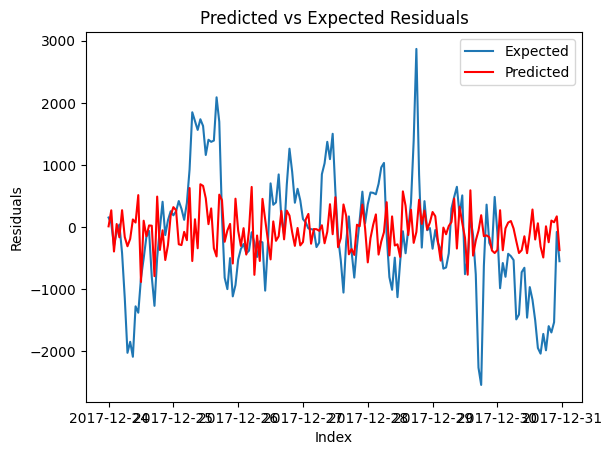

In [ ]:
# Make predictions using the fitted model
predictions_ma = model_fit_ma.predict(start=len(train_resid), end=len(train_resid)+len(Test)-1, dynamic=False)

# Print predicted and expected values
for i in range(len(predictions)):
    print('predicted=%f, expected=%f' % (predictions_ma[i], Test.iloc[i]-predictions[i]))

# Calculate and print Root Mean Squared Error (RMSE) for the predictions
# rmse = sqrt(mean_squared_error(test.values, predictions_ma))
# print('Test RMSE: %.3f' % rmse)

# Plot predictions vs expected
plt.plot(Test.index, Test - predictions, label='Expected')
plt.plot(Test.index, predictions_ma, color='red', label='Predicted')
plt.xlabel('Index')
plt.ylabel('Residuals')
plt.title('Predicted vs Expected Residuals')
plt.legend();

- The red line represents the predicted residuals using a moving average (MA) model filtted to the actual residuals of the training data.
- The red line follows the pattern of the blue line, so it captures some of the noise in the data.
- Spikes are not captured, and the model does not predict the highest peaks and lowest troughs accurately.
- The cyclical pattern (seasonality) was not captured at all.


In [ ]:
predictions_sum = [x + y for x, y in zip(predictions, predictions_ma)]
# Calculate metrics for the predictions
metrics = calculate_metrics(Test, predictions_sum)

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['AR+MA'] = metrics_df.values[0]

In [ ]:
results

,RMSE,MAE,MAPE (%)
Model,,,
Naive,1712.072470,1188.279317,181.208019
Seasonal Naive,1825.429688,1287.102420,274.270866
Mean,1695.014795,1149.035242,100.517539
Drift,1724.262372,1204.868287,200.338491
Autoregression,930.576220,714.182250,322.091152
AR+MA,929.928855,699.429359,347.443463


# 4. ARIMA Model

**DifferenceBetweenARIMAandSARIMA**
1.ARIMA (AutoRegressive Integrated Moving Average)
ARIMA includes following components:
- AR (AutoRegressive): AR involves regressing the variable on its own lagged (prior) values.
- I (Integrated): I involves differencing the data for making it stationary. Removing trends for example.
- MA (Moving Average): MA involves modeling the error term as a linear combination of error terms occurring at different times in the past.
- ARIMA is often used for non-seasonal data, so it is useful for the data that do not have seasonal component.  

2.SARIMA (Seasonal AutoRegressive Integrated Moving Average)
ARIMA includes following components:
- SARIMA is an extension of ARIMA by explicitly modeling the seasonal component of the data.
- SARIMA is the ARIMA that seasonal components are added.
- The seasonal terms are added to the ARIMA model to account for seasonality in the data.
- SARIMA is often used for seasonal data, so it is useful for data that exhibit clear seasonal patterns.

- The used dataset has strong seasonality so SARIMA model is suitable and can produce accurate prediction.


In [ ]:
#  Assuming `data` is your DataFrame
# Downsample the data to daily frequency using mean
daily_data = data.resample('D').mean()

# Split the data into train and test sets
split_date = '2017-12-01'  # Use the appropriate date for your dataset
Train = daily_data.loc[daily_data.index < split_date]
Test = daily_data.loc[daily_data.index >= split_date]

# Select a single column to model
column_to_model = 'PowerConsumption_Zone1'  # Replace with the actual column name

# Fix the seed for randomness
seed = 42
np.random.seed(seed)

# Automatically search for the best ARIMA model parameters using auto_arima function
auto_arima_model = auto_arima(Train[column_to_model], start_p=1, start_q=1,
                              max_p=30, max_q=30, m=1,
                              seasonal=False,
                              d=None, trace=True,
                              error_action='ignore',
                              suppress_warnings=True,
                              stepwise=True,
                              random_state=42)

# Print the best parameters found by auto_arima
print("Best parameters found by auto_arima:", auto_arima_model.order)

# Create an ARIMA model with the best parameters obtained from auto_arima
model_arima = ARIMA(Train[column_to_model], order=auto_arima_model.order)

# Fit the ARIMA model to the training data
arima_fit = model_arima.fit()

# Print the summary of the ARIMA model
print(arima_fit.summary())

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5706.857, Time=0.86 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5729.589, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5708.177, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5707.728, Time=0.47 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5727.593, Time=0.04 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=5706.172, Time=1.72 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=5710.300, Time=0.45 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=5703.217, Time=1.05 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=5708.566, Time=0.48 sec
 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=5703.102, Time=1.05 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=5703.230, Time=0.24 sec
 ARIMA(5,1,1)(0,0,0)[0] intercept   : AIC=5705.164, Time=0.45 sec
 ARIMA(4,1,2)(0,0,0)[0] intercept   : AIC=5691.107, Time=0.67 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=1.27 sec
 ARIMA(5,1,2)(0,0,0)[0] intercept   : 

In [ ]:
arima_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                  
==================================================================================
Dep. Variable:     PowerConsumption_Zone1   No. Observations:                  334
Model:                     ARIMA(7, 1, 0)   Log Likelihood               -2820.949
Date:                    Mon, 24 Jun 2024   AIC                           5657.897
Time:                            16:39:15   BIC                           5688.362
Sample:                        01-01-2017   HQIC                          5670.045
                             - 11-30-2017                                         
Covariance Type:                      opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2054      0.021     -9.988      0.000      -0.246      -0.165
ar.L2         -0.0858      0.028     -3.064      0.002      -0.141      -0.031
ar.L3         -0.1390      0.029     -4.744      0.000      -0.196      -0.082
ar.L4         -0.1025      0.030     -3.465      0.001      -0.161      -0.045
ar.L5         -0.0580      0.041     -1.424      0.155      -0.138       0.022
ar.L6         -0.1104      0.023     -4.829      0.000      -0.155      -0.066
ar.L7          0.2423      0.015     16.386      0.000       0.213       0.271
sigma2      1.077e+06   5.35e+04     20.129      0.000    9.72e+05    1.18e+06
===================================================================================
Ljung-Box (L1) (Q):                   4.12   Jarque-Bera (JB):               104.55
Prob(Q):                              0.04   Prob(JB):                         0.00
Heteroskedasticity (H):               0.54   Skew:                            -0.47
Prob(H) (two-sided):                  0.00   Kurtosis:                         5.58
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

predicted=29606.357779, expected=26995.901986
predicted=29541.484175, expected=27669.370511
predicted=29354.993188, expected=27016.603295
predicted=29538.155872, expected=29151.626531
predicted=29696.723825, expected=29394.888044
predicted=29927.368061, expected=29318.462188
predicted=29729.521631, expected=29148.246726
predicted=29679.219070, expected=28952.091254
predicted=29652.448664, expected=29243.008027
predicted=29591.518468, expected=27869.750740
predicted=29647.095243, expected=30070.004225
predicted=29674.233959, expected=29577.566540
predicted=29755.745020, expected=29584.199409
predicted=29694.363176, expected=29721.715251
predicted=29684.807275, expected=29391.170258
predicted=29674.938367, expected=28762.526405
predicted=29655.490153, expected=27212.589776
predicted=29673.691913, expected=29621.673004
predicted=29675.115640, expected=29655.217575
predicted=29704.055566, expected=29736.459654
predicted=29684.207868, expected=29631.516688
predicted=29683.639304, expected=2

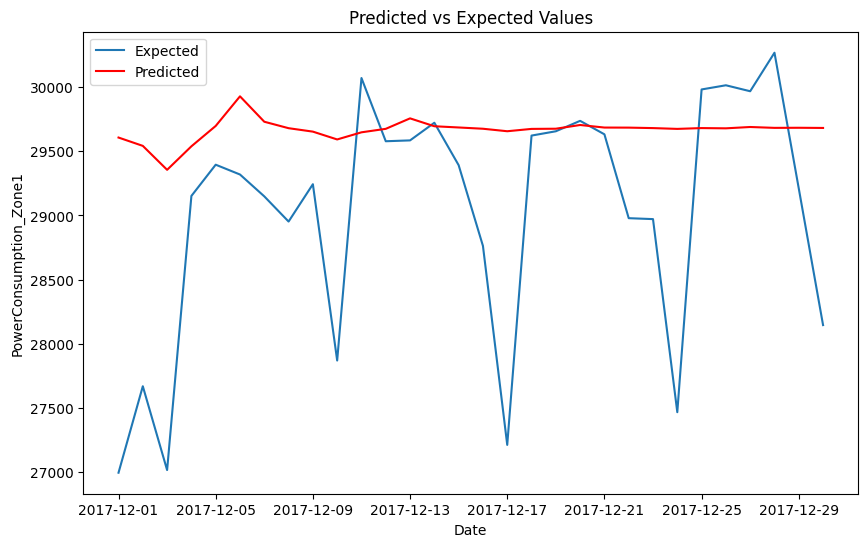

In [ ]:
# Make predictions using the fitted model
predictions = arima_fit.predict(start=len(Train), end=len(Train)+len(Test)-1, dynamic=False)

# Ensure the predictions and Test data are aligned
predictions = predictions.values

# Print predicted and expected values
for i in range(len(predictions)):
    print('predicted=%f, expected=%f' % (predictions[i], Test[column_to_model].iloc[i]))

# Plot predictions vs expected
plt.figure(figsize=(10, 6))
plt.plot(Test.index, Test[column_to_model], label='Expected')
plt.plot(Test.index, predictions, color='red', label='Predicted')
plt.xlabel('Date')
plt.ylabel(column_to_model)
plt.title('Predicted vs Expected Values')
plt.legend()
plt.show()


- The ARIMA model does not tend to capture the trend, and the variability and spikes in the data is not quite predicted as well.
- The ARIMA model may not account for the high variability in daily power consumption.


In [ ]:
# Calculate metrics for the predictions
metrics = calculate_metrics(Test[column_to_model].values, predictions)

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it does not exist
try:
    results
except NameError:
    results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['ARIMA'] = metrics_df.values[0]



In [ ]:
results

,RMSE,MAE,MAPE (%)
Model,,,
Naive,1712.072470,1188.279317,181.208019
Seasonal Naive,1825.429688,1287.102420,274.270866
Mean,1695.014795,1149.035242,100.517539
Drift,1724.262372,1204.868287,200.338491
Autoregression,930.576220,714.182250,322.091152
AR+MA,929.928855,699.429359,347.443463
ARIMA,1104.262129,773.705145,2.755310


# 5. SARIMA Model

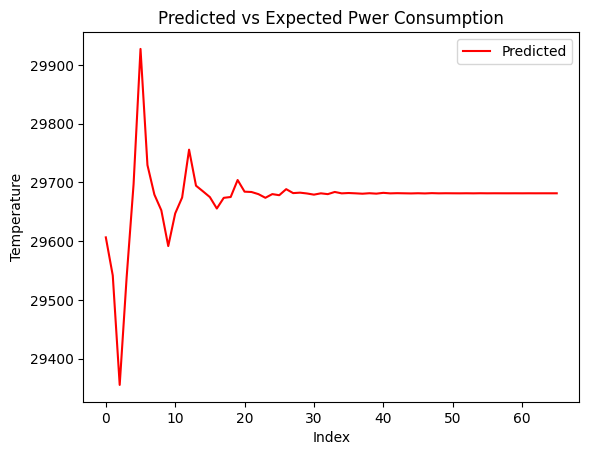

In [ ]:
# Make predictions using the fitted model
predictions = arima_fit.predict(start=len(Train), end=len(Train)+len(Test)-1+36, dynamic=False).values

# Plot predictions vs expected
plt.plot(predictions, color='red', label='Predicted')
plt.xlabel('Index')
plt.ylabel('Temperature')
plt.title('Predicted vs Expected Pwer Consumption')
plt.legend();

In [ ]:
# Downsample the data to daily frequency using mean
daily_data = data.resample('D').mean()

# Split the data into train and test sets
split_date = '2017-12-01'  # Use the appropriate date for your dataset
Train = daily_data.loc[daily_data.index < split_date]
Test = daily_data.loc[daily_data.index >= split_date]

# Fix the seed for randomness
seed = 42
np.random.seed(seed)

# Fit auto ARIMA model with seasonality
auto_sarima_model = auto_arima(Train['PowerConsumption_Zone1'], start_p=1, start_q=1,
                              max_p=30, max_q=30, m=7,  # Set m to the seasonal period (weekly seasonality for daily data)
                              seasonal=True,  # Enable seasonal ARIMA
                              d=None, trace=True,
                              error_action='ignore',
                              suppress_warnings=True,
                              stepwise=True,
                              random_state=seed)

# Print best parameters found
print("Order (p,d,q):", auto_sarima_model.order)
print("Seasonal Order (P,D,Q,m):", auto_sarima_model.seasonal_order)

# Fit SARIMA model with the best parameters
model_sarima = ARIMA(Train['PowerConsumption_Zone1'], order=auto_sarima_model.order, seasonal_order=auto_sarima_model.seasonal_order)
sarima_fit = model_sarima.fit()

# Print summary of the fitted model
print(sarima_fit.summary())


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(1,0,1)[7] intercept   : AIC=5607.224, Time=5.11 sec
 ARIMA(0,1,0)(0,0,0)[7] intercept   : AIC=5729.589, Time=0.16 sec
 ARIMA(1,1,0)(1,0,0)[7] intercept   : AIC=5663.563, Time=0.63 sec
 ARIMA(0,1,1)(0,0,1)[7] intercept   : AIC=5666.591, Time=1.17 sec
 ARIMA(0,1,0)(0,0,0)[7]             : AIC=5727.593, Time=0.07 sec
 ARIMA(1,1,1)(0,0,1)[7] intercept   : AIC=5666.494, Time=2.57 sec
 ARIMA(1,1,1)(1,0,0)[7] intercept   : AIC=5661.865, Time=2.78 sec
 ARIMA(1,1,1)(2,0,1)[7] intercept   : AIC=inf, Time=6.03 sec
 ARIMA(1,1,1)(1,0,2)[7] intercept   : AIC=inf, Time=6.41 sec
 ARIMA(1,1,1)(0,0,0)[7] intercept   : AIC=5706.857, Time=0.85 sec
 ARIMA(1,1,1)(0,0,2)[7] intercept   : AIC=5667.684, Time=3.60 sec
 ARIMA(1,1,1)(2,0,0)[7] intercept   : AIC=5656.770, Time=4.59 sec
 ARIMA(1,1,1)(2,0,2)[7] intercept   : AIC=5620.423, Time=5.25 sec
 ARIMA(0,1,1)(1,0,1)[7] intercept   : AIC=inf, Time=1.23 sec
 ARIMA(1,1,0)(1,0,1)[7] intercept   : AIC=inf, T

predicted=29414.919830, expected=26995.901986
predicted=29329.221749, expected=27669.370511
predicted=28370.702728, expected=27016.603295
predicted=29656.286380, expected=29151.626531
predicted=29820.196421, expected=29394.888044
predicted=29846.284622, expected=29318.462188
predicted=29793.528665, expected=29148.246726
predicted=29347.581670, expected=28952.091254
predicted=29253.008140, expected=29243.008027
predicted=28303.997984, expected=27869.750740
predicted=29574.368216, expected=30070.004225
predicted=29736.328332, expected=29577.566540
predicted=29762.105901, expected=29584.199409
predicted=29709.961946, expected=29721.715251
predicted=29269.198346, expected=29391.170258
predicted=29175.724086, expected=28762.526405
predicted=28237.745023, expected=27212.589776
predicted=29493.348731, expected=29621.673004
predicted=29653.426256, expected=29655.217575
predicted=29678.904192, expected=29736.459654
predicted=29627.366348, expected=29631.516688
predicted=29191.726093, expected=2

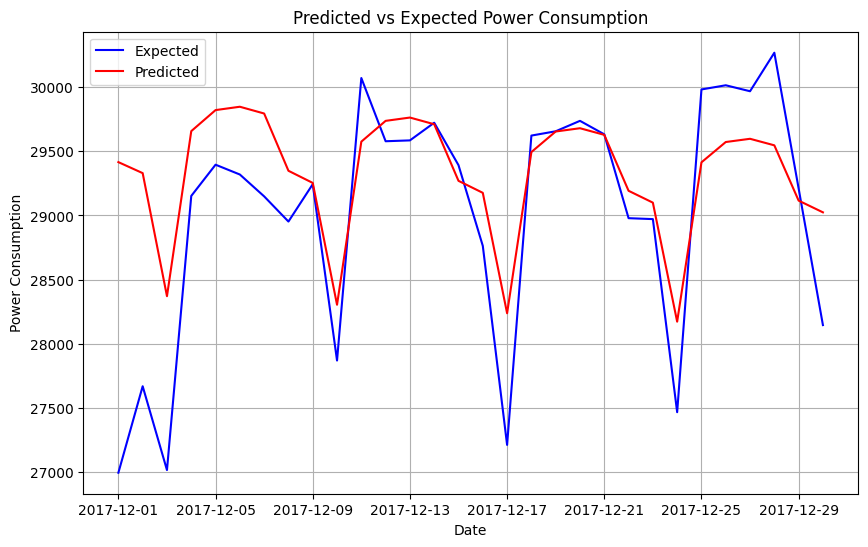

In [ ]:

predictions = sarima_fit.predict(start=len(Train), end=len(Train)+len(Test)-1, dynamic=False).values

# Print predicted and expected values
for i in range(len(predictions)):
    print('predicted=%f, expected=%f' % (predictions[i], Test['PowerConsumption_Zone1'].iloc[i]))

# Plot predictions vs expected
plt.figure(figsize=(10, 6))
plt.plot(Test.index, Test['PowerConsumption_Zone1'], label='Expected', color='blue')
plt.plot(Test.index, predictions, color='red', label='Predicted')
plt.xlabel('Date')
plt.ylabel('Power Consumption')
plt.title('Predicted vs Expected Power Consumption')
plt.legend()
plt.grid(True)
plt.show()

- The downsampling method (DAY) is used for SARIMA model.
- It was applied because data was too huge and kernel died.
- The predicted values follow the general trend of the actual values, but there is some missing of the variability seen in the actual data
- SARIMA model can get the trend and seasonality.


In [ ]:


# Calculate metrics for the predictions
metrics = calculate_metrics(Test['PowerConsumption_Zone1'].values, predictions)

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it doesn't exist
results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['SARIMA'] = metrics_df.values[0]


In [ ]:
results

,RMSE,MAE,MAPE (%)
SARIMA,730.045378,503.080572,1.779582


# 6. Hot Winters Model


- Holt-Winters method extends simple exponential smoothing by adding support for trends and seasonality. This method is used when the data has  both seasonal patterns and trends.

- Since the used data has strong seasonal patterns and some trends, the Holt-Winters predicted future accurately.

predicted=104.253384, expected=672.243347
predicted=71.017243, expected=67.934093
predicted=31.180229, expected=-483.650192
predicted=12.889551, expected=22.306718
predicted=8.055615, expected=121.673003
predicted=-3.927968, expected=-612.420785
predicted=-49.465415, expected=-1776.425858
predicted=-111.055652, expected=-3057.034222
predicted=-129.638408, expected=-3138.149557
predicted=7.390767, expected=-4049.683145
predicted=295.176929, expected=-3591.381497
predicted=605.860366, expected=-3766.793408
predicted=734.210512, expected=-2998.225603
predicted=675.449536, expected=-2508.491762
predicted=531.131251, expected=-1981.242078
predicted=386.788730, expected=-1639.543723
predicted=299.222240, expected=-1751.077310
predicted=278.109794, expected=-2479.087450
predicted=282.985293, expected=-1858.555133
predicted=304.478749, expected=-1071.736375
predicted=313.964268, expected=263.624842
predicted=275.012839, expected=305.196453
predicted=211.622393, expected=-67.934093
predicted=15

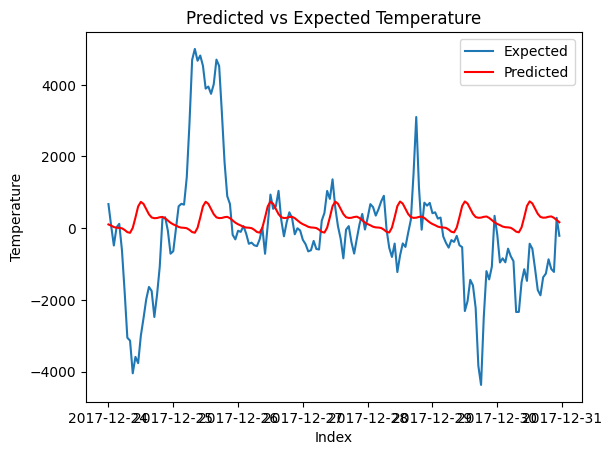

In [ ]:
# Load data
data = pd.read_csv('powerconsumption.csv', parse_dates=['Datetime'], index_col='Datetime')

# Downsample the data to an hourly frequency
hourly_data = data.resample('H').mean()

# Compute seasonal differencing of 24 hours for the 'PowerConsumption_Zone1' column
hourly_data['PowerConsumption_Zone1_diff'] = hourly_data['PowerConsumption_Zone1'].diff(24).dropna()

# Define the training and testing periods (with data points every hour)
test_period = 7 * 24  # Last week (7 days * 24 hours)
train_period = -test_period  # All data except the last week

# Split the data into training and testing sets
Train = hourly_data['PowerConsumption_Zone1_diff'][:train_period].dropna()
Test = hourly_data['PowerConsumption_Zone1_diff'][train_period:].dropna()

# Train autoregression

# Fix the seed for randomness
seed = 42
np.random.seed(seed)

# Fit Holt-Winters Seasonal Model
holt_winters_model = ExponentialSmoothing(
    Train,
    seasonal_periods=24,
    trend='add',        # 'add' for additive trend, can be 'mul' for multiplicative
    seasonal='add'      # 'add' for additive seasonality, can be 'mul' for multiplicative
).fit()

# Make predictions using the fitted model
predictions = holt_winters_model.forecast(len(Test))

# Print predicted and expected values
for i in range(len(predictions)):
    print(f'predicted={predictions.iloc[i]:.6f}, expected={Test.iloc[i]:.6f}')

# Plot predictions vs expected
plt.plot(Test.index, Test, label='Expected')
plt.plot(Test.index, predictions, color='red', label='Predicted')
plt.xlabel('Index')
plt.ylabel('Temperature')
plt.title('Predicted vs Expected Temperature')
plt.legend()
plt.show()

- The predicted values follow the trend a bit, but the model does not get any spikes.
- The model incorporates weekly seasonality, and it can help in capturing the periodic patterns in the data.


In [ ]:
# Calculate metrics for the predictions
metrics = calculate_metrics(Test, predictions)

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Holt_Winters'] = metrics_df.values[0]

In [ ]:
results

,RMSE,MAE,MAPE (%)
SARIMA,730.045378,503.080572,1.779582
Holt_Winters,1745.808867,1218.721233,202.862488


- Since downsampling and differenting are mixed in the above code, I regenerate the all values using downsampling data.
- In this table, SARIMA is the best model with the lowest RMSE, MAE, and MAPE and ARIMA is second.
- Although simple models ( naive and Seasonal naive models) were able to provide a decent baseline, SARIMA has the highest accuracy of all.
- Poor performance was the mean because simple averaging is not effective for this dataset.

# 7. MultiLayer Perceptions (MLPs) Models

1. Multivariate MLP - Multiple Input Series
- This model handles multiple time series (multivariate) data where each input series is fed into a separate MLP branch.
- Used when multiple related time series are prepared (e.g., temperature, humidity, and wind speed) and the interactions between them need to be modeled.

2. Multi-headed MLP Model
- A type of multivariate MLP but with distinct heads for different input features or series, which allows specialized feature extraction before merging.
- Suitable when different input series have significantly different characteristics and require separate preprocessing or feature extraction.

3. Multiple Parallel Series
- This involves modeling multiple time series in parallel.
- Used when there is a need to forecast several independent but related time series simultaneously.

4. Multi-output MLP Model
- A single MLP model that outputs multiple predictions for different time series.
- Useful when predicting multiple related outputs from a single set of inputs.

5. Multi-step MLP Models
- These models predict multiple future steps (time points) for a single time series.
- Used when forecasting a time series multiple steps ahead is needed.

6. Multivariate Multi-step MLP Models
- Combines multivariate inputs with multi-step outputs, and predicts multiple future steps for multiple input series.
- Suitable when there are several time series and the goal is to predict multiple future steps for each series.

7. Multiple Input Multi-step Output
- Similar to multivariate multi-step models but refers to a more generalized form where inputs can come from different sources or formats, not just multiple time series.
- Used when inputs are diverse and need to be processed differently before predicting multiple future steps.

8. Multiple Parallel Input and Multi-step Output
- Combines multiple parallel input series with multi-step outputs, forecasts multiple future steps for each parallel input.
- Suitable when there are multiple independent but related time series and the goal is to predict their future values simultaneously over multiple steps.

## 7.1 Univariate MLP Models

In [ ]:
import os
import random
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf
import matplotlib.pyplot as plt
from IPython.display import Image
from keras.layers import Dense, Input
from statsmodels.tsa.seasonal import STL
from keras.callbacks import EarlyStopping
from keras.models import Sequential, Model
from keras.layers import concatenate
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error

In [ ]:
# Load data
data = pd.read_csv('powerconsumption.csv', parse_dates=['Datetime'], index_col='Datetime')

# Downsample the data to an hourly frequency
hourly_data = data.resample('H').mean()

# Compute seasonal differencing of 24 hours for 'PowerConsumption_Zone1' column
hourly_data['PowerConsumption_Zone1_diff'] = hourly_data['PowerConsumption_Zone1'].diff(24).dropna()

# Standardize the data
scaler = StandardScaler()
hourly_data['PowerConsumption_Zone1_diff'] = scaler.fit_transform(hourly_data[['PowerConsumption_Zone1_diff']])

# Function to split the data into sequences
def split_sequence(sequence, n_steps):
    X, y = list(), list()
    for i in range(len(sequence)):
        end_ix = i + n_steps
        if end_ix > len(sequence) - 1:
            break
        seq_x, seq_y = sequence[i:end_ix], sequence[end_ix]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

In [ ]:
# Prepare the data
n_steps = 24  # Number of time steps (1 day)
X, y = split_sequence(hourly_data['PowerConsumption_Zone1_diff'].dropna().tolist(), n_steps)

# Split data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)   # 60% training, 40% temp
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)  # 20% validation, 20% test


In [ ]:
# Set the random seeds for reproducibility
seed = 42
np.random.seed(seed)
tf.random.set_seed(seed)
random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

# Define the MLP model
model = Sequential()
model.add(Dense(100, activation='relu', input_dim=n_steps))
model.add(Dense(1))

# Compile the model
model.compile(optimizer='adam', loss='mse')

# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model with EarlyStopping
history = model.fit(X_train, y_train, epochs=1000, verbose=1, validation_data=(X_val, y_val), callbacks=[early_stopping], batch_size=32)


Epoch 1/1000
163/163 [==============================] - 4s 12ms/step - loss: 0.2976 - val_loss: 0.2116
Epoch 2/1000
163/163 [==============================] - 1s 7ms/step - loss: 0.1844 - val_loss: 0.1895
Epoch 3/1000
163/163 [==============================] - 1s 7ms/step - loss: 0.1685 - val_loss: 0.1749
Epoch 4/1000
163/163 [==============================] - 1s 6ms/step - loss: 0.1620 - val_loss: 0.1774
Epoch 5/1000
163/163 [==============================] - 1s 8ms/step - loss: 0.1587 - val_loss: 0.1876
Epoch 6/1000
163/163 [==============================] - 1s 8ms/step - loss: 0.1569 - val_loss: 0.1930
Epoch 7/1000
163/163 [==============================] - 1s 7ms/step - loss: 0.1534 - val_loss: 0.1724
Epoch 8/1000
163/163 [==============================] - 1s 8ms/step - loss: 0.1532 - val_loss: 0.1721
Epoch 9/1000
163/163 [==============================] - 1s 7ms/step - loss: 0.1525 - val_loss: 0.1766
Epoch 10/1000
163/163 [==============================] - 2s 11ms/step - loss: 0.1

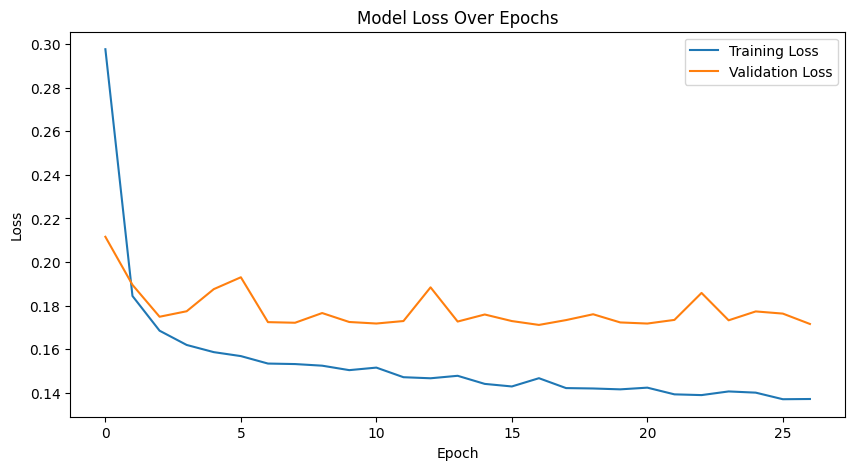

55/55 [==============================] - 0s 6ms/step


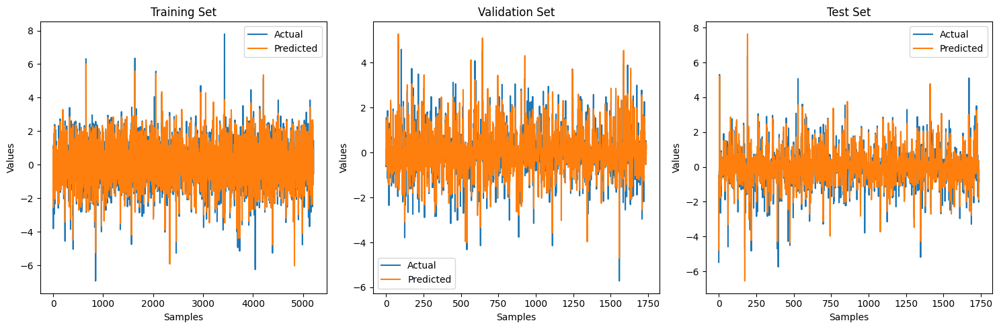

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss Over Epochs')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Predict values
y_train_pred = model.predict(X_train)
y_val_pred = model.predict(X_val)
y_test_pred = model.predict(X_test)

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y_train, label='Actual')
plt.plot(y_train_pred, label='Predicted')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y_val, label='Actual')
plt.plot(y_val_pred, label='Predicted')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y_test, label='Actual')
plt.plot(y_test_pred, label='Predicted')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
# Calculate metrics for the test predictions
def calculate_metrics(true_values, predicted_values):
    rmse = mean_squared_error(true_values, predicted_values, squared=False)
    mae = mean_absolute_error(true_values, predicted_values)
    mape = mean_absolute_percentage_error(true_values, predicted_values) * 100
    return rmse, mae, mape

test_metrics = calculate_metrics(y_test, y_test_pred)

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([test_metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it doesn't exist
results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Univariate MLP Model'] = metrics_df.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Univariate MLP Model,0.442622,0.283549,351.971483


## 7.2 Multiple Input Series


In [ ]:
# Load data
data = pd.read_csv('powerconsumption.csv', parse_dates=['Datetime'], index_col='Datetime')

# Downsample the data to an hourly frequency
hourly_data = data.resample('H').mean()

# Compute seasonal differencing of 24 hours for 'PowerConsumption_Zone1' and 'Temperature' columns
hourly_data['PowerConsumption_Zone1_diff'] = hourly_data['PowerConsumption_Zone1'].diff(24)
hourly_data['Temperature_diff'] = hourly_data['Temperature'].diff(24)

# Drop NA values
hourly_data = hourly_data.dropna()

# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(hourly_data[['PowerConsumption_Zone1_diff', 'Temperature_diff']])

# Function to split a multivariate sequence into input/output samples
def split_sequences_multistep(sequences, n_steps_in, n_steps_out):
    X, y = [], []
    for i in range(len(sequences) - n_steps_in - n_steps_out + 1):
        end_ix = i + n_steps_in
        out_end_ix = end_ix + n_steps_out
        # Extract input and output parts of the pattern
        seq_x, seq_y = sequences[i:end_ix, :], sequences[end_ix:out_end_ix, 0]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)


In [ ]:
# Choose a number of time steps for input and output
n_steps_in, n_steps_out = 24, 6  # Adjust as needed

# Split into samples
X, y = split_sequences_multistep(scaled_data, n_steps_in, n_steps_out)

# Split data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)   # 60% training, 40% temp
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)  # 20% validation, 20% test

# Set the random seeds for reproducibility
seed = 42
np.random.seed(seed)
tf.random.set_seed(seed)
random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)


In [ ]:
# Define the multi-step MLP model
model_multi_input = Sequential()
model_multi_input.add(Dense(100, activation='relu', input_shape=(n_steps_in, X_train.shape[2])))
model_multi_input.add(Flatten())
model_multi_input.add(Dense(100, activation='relu'))
model_multi_input.add(Dense(n_steps_out))
model_multi_input.compile(optimizer='adam', loss='mse')

# Fit the model
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history_multi_input = model_multi_input.fit(
    X_train, y_train,
    epochs=1000, batch_size=32, verbose=1,
    validation_data=(X_val, y_val),
    callbacks=[early_stopping]
)

Epoch 1/1000
163/163 [==============================] - 7s 26ms/step - loss: 0.5097 - val_loss: 0.4987
Epoch 2/1000
163/163 [==============================] - 4s 24ms/step - loss: 0.4358 - val_loss: 0.4705
Epoch 3/1000
163/163 [==============================] - 2s 12ms/step - loss: 0.4113 - val_loss: 0.4577
Epoch 4/1000
163/163 [==============================] - 2s 9ms/step - loss: 0.4042 - val_loss: 0.4653
Epoch 5/1000
163/163 [==============================] - 2s 11ms/step - loss: 0.3921 - val_loss: 0.4516
Epoch 6/1000
163/163 [==============================] - 2s 10ms/step - loss: 0.3768 - val_loss: 0.4416
Epoch 7/1000
163/163 [==============================] - 2s 9ms/step - loss: 0.3729 - val_loss: 0.4611
Epoch 8/1000
163/163 [==============================] - 2s 13ms/step - loss: 0.3633 - val_loss: 0.4419
Epoch 9/1000
163/163 [==============================] - 2s 15ms/step - loss: 0.3531 - val_loss: 0.4377
Epoch 10/1000
163/163 [==============================] - 2s 10ms/step - los

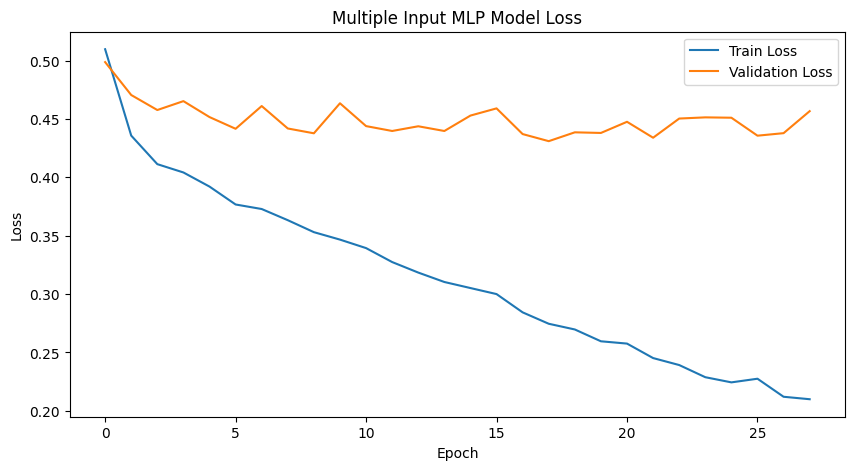

55/55 [==============================] - 0s 3ms/step


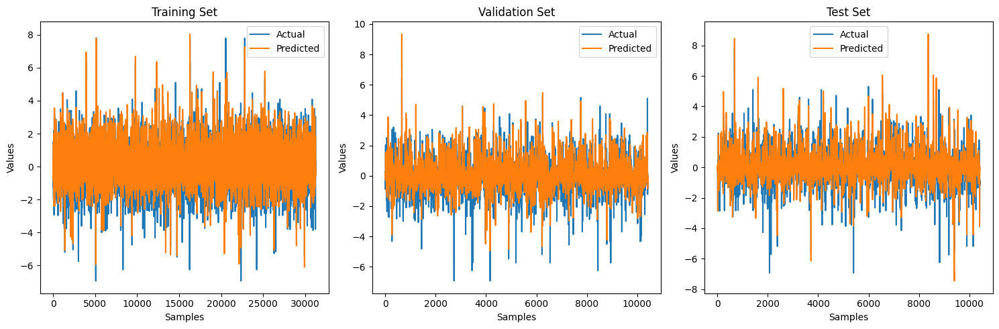

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history_multi_input.history['loss'], label='Train Loss')
plt.plot(history_multi_input.history['val_loss'], label='Validation Loss')
plt.title('Multiple Input MLP Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Predict values
y_train_pred = model_multi_input.predict(X_train)
y_val_pred = model_multi_input.predict(X_val)
y_test_pred = model_multi_input.predict(X_test)

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y_train.flatten(), label='Actual')
plt.plot(y_train_pred.flatten(), label='Predicted')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y_val.flatten(), label='Actual')
plt.plot(y_val_pred.flatten(), label='Predicted')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y_test.flatten(), label='Actual')
plt.plot(y_test_pred.flatten(), label='Predicted')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
# Calculate metrics for the test predictions
test_metrics = calculate_metrics(y_test.flatten(), y_test_pred.flatten())

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([test_metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it doesn't exist
results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Multiple Input MLP Model'] = metrics_df.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Multiple Input MLP Model,0.645531,0.436226,578.82875


### 7.2.2 Multi-headed MLP Model

In [ ]:

# Function to split a multivariate sequence into input/output samples
def split_sequences_multistep(sequences, n_steps_in, n_steps_out):
    X, y = [], []
    for i in range(len(sequences) - n_steps_in - n_steps_out + 1):
        end_ix = i + n_steps_in
        out_end_ix = end_ix + n_steps_out
        # Extract input and output parts of the pattern
        seq_x, seq_y = sequences[i:end_ix, :], sequences[end_ix:out_end_ix, 0]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

# Choose a number of time steps for input and output
n_steps_in, n_steps_out = 24, 6  # Adjust as needed

# Split into samples
X, y = split_sequences_multistep(scaled_data, n_steps_in, n_steps_out)

# Split data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)   # 60% training, 40% temp
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)  # 20% validation, 20% test

# Split data into separate input series
X1, X2 = X[:, :, 0], X[:, :, 1]

# Split data into training, validation, and test sets for each input series
X1_train, X1_temp, y_train, y_temp = train_test_split(X1, y, test_size=0.4, random_state=42)
X1_val, X1_test, y_val, y_test = train_test_split(X1_temp, y_temp, test_size=0.5, random_state=42)
X2_train, X2_temp, _, _ = train_test_split(X2, y, test_size=0.4, random_state=42)
X2_val, X2_test, _, _ = train_test_split(X2_temp, y_temp, test_size=0.5, random_state=42)

# Set the random seeds for reproducibility
seed = 42
np.random.seed(seed)
tf.random.set_seed(seed)
random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

# First input model
visible1 = Input(shape=(n_steps_in,))
dense1 = Dense(100, activation='relu')(visible1)

# Second input model
visible2 = Input(shape=(n_steps_in,))
dense2 = Dense(100, activation='relu')(visible2)

# Merge input models
merged = concatenate([dense1, dense2])
dense3 = Dense(100, activation='relu')(merged)
output = Dense(n_steps_out)(dense3)

# Create and compile the model
model_multi_headed = Model(inputs=[visible1, visible2], outputs=output)
model_multi_headed.compile(optimizer='adam', loss='mse')

# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model
history_multi_headed = model_multi_headed.fit(
    [X1_train, X2_train], y_train,
    epochs=1000, batch_size=32, verbose=1,
    validation_data=([X1_val, X2_val], y_val),
    callbacks=[early_stopping]
)

Epoch 1/1000
163/163 [==============================] - 3s 10ms/step - loss: 0.5514 - val_loss: 0.5027
Epoch 2/1000
163/163 [==============================] - 1s 8ms/step - loss: 0.4415 - val_loss: 0.4757
Epoch 3/1000
163/163 [==============================] - 1s 7ms/step - loss: 0.4120 - val_loss: 0.4618
Epoch 4/1000
163/163 [==============================] - 1s 8ms/step - loss: 0.3989 - val_loss: 0.4724
Epoch 5/1000
163/163 [==============================] - 2s 11ms/step - loss: 0.3841 - val_loss: 0.4490
Epoch 6/1000
163/163 [==============================] - 2s 11ms/step - loss: 0.3704 - val_loss: 0.4440
Epoch 7/1000
163/163 [==============================] - 1s 9ms/step - loss: 0.3623 - val_loss: 0.4620
Epoch 8/1000
163/163 [==============================] - 1s 8ms/step - loss: 0.3523 - val_loss: 0.4361
Epoch 9/1000
163/163 [==============================] - 1s 7ms/step - loss: 0.3376 - val_loss: 0.4429
Epoch 10/1000
163/163 [==============================] - 1s 8ms/step - loss: 0.

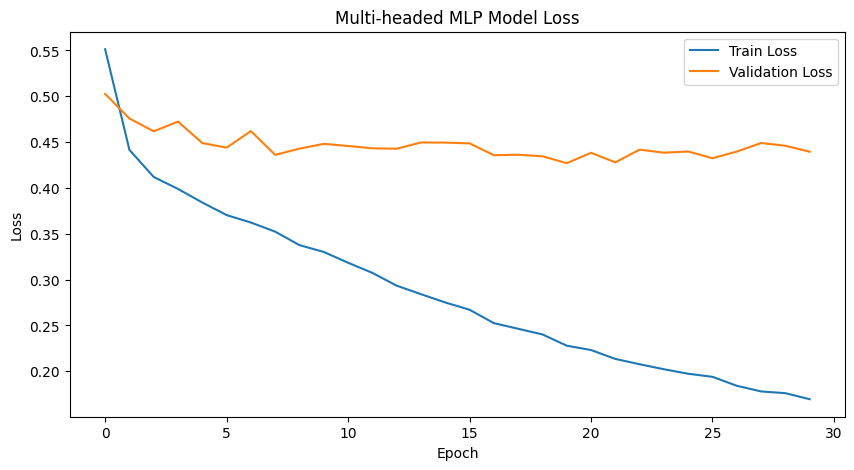

55/55 [==============================] - 0s 2ms/step


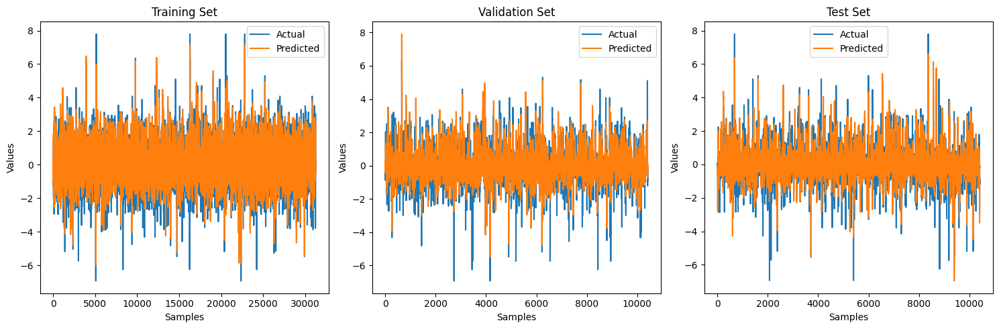

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history_multi_headed.history['loss'], label='Train Loss')
plt.plot(history_multi_headed.history['val_loss'], label='Validation Loss')
plt.title('Multi-headed MLP Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Predict values
y_train_pred = model_multi_headed.predict([X1_train, X2_train])
y_val_pred = model_multi_headed.predict([X1_val, X2_val])
y_test_pred = model_multi_headed.predict([X1_test, X2_test])

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y_train.flatten(), label='Actual')
plt.plot(y_train_pred.flatten(), label='Predicted')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y_val.flatten(), label='Actual')
plt.plot(y_val_pred.flatten(), label='Predicted')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y_test.flatten(), label='Actual')
plt.plot(y_test_pred.flatten(), label='Predicted')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()


In [ ]:
# Calculate metrics for the test predictions
def calculate_metrics(true_values, predicted_values):
    rmse = mean_squared_error(true_values, predicted_values, squared=False)
    mae = mean_absolute_error(true_values, predicted_values)
    mape = mean_absolute_percentage_error(true_values, predicted_values) * 100
    return rmse, mae, mape

test_metrics = calculate_metrics(y_test.flatten(), y_test_pred.flatten())

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([test_metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it doesn't exist
results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Multi-headed MLP Model'] = metrics_df.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Multi-headed MLP Model,0.647582,0.450972,657.418271


## 7.3 Multiple Parallel Series for MLP

In [ ]:

data = pd.read_csv('powerconsumption.csv', parse_dates=['Datetime'], index_col='Datetime')

# Downsample the data to an hourly frequency
hourly_data = data.resample('H').mean()

# Compute seasonal differencing of 24 hours for 'PowerConsumption_Zone1' and 'Temperature' columns
hourly_data['PowerConsumption_Zone1_diff'] = hourly_data['PowerConsumption_Zone1'].diff(24).dropna()
hourly_data['Temperature_diff'] = hourly_data['Temperature'].diff(24).dropna()

# Drop NA values
hourly_data = hourly_data.dropna()

# Define input sequences
in_seq1 = hourly_data['PowerConsumption_Zone1_diff'].values
in_seq2 = hourly_data['Temperature_diff'].values
out_seq = np.array([in_seq1[i] + in_seq2[i] for i in range(len(in_seq1))])

# Convert sequences to a [rows, columns] structure
in_seq1 = in_seq1.reshape((len(in_seq1), 1))
in_seq2 = in_seq2.reshape((len(in_seq2), 1))
out_seq = out_seq.reshape((len(out_seq), 1))

# Horizontally stack columns to create the dataset
dataset = np.hstack((in_seq1, in_seq2, out_seq))

# Function to split a multivariate sequence into samples
def split_sequences(sequences, n_steps):
    X, y = list(), list()
    for i in range(len(sequences) - n_steps):
        end_ix = i + n_steps
        # Extract input and output parts of the pattern
        seq_x, seq_y = sequences[i:end_ix, :], sequences[end_ix, -1]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

# Choose a number of time steps
n_steps = 24

# Convert dataset into input/output samples
X, y = split_sequences(dataset, n_steps)

# Split data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)   # 60% training, 40% temp
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)  # 20% validation, 20% test

# Print the shapes of the resulting arrays
print("Input shape:", X.shape)
print("Output shape:", y.shape)

# Summarize the data by printing each input/output pair
for i in range(len(X)):
    print('='* 20)
    print(f"X[{i}]:\n{X[i]}, \ny[{i}]:\n{y[i]}")

# Flatten input for MLP
n_input = X.shape[1] * X.shape[2]
X_train_flat = X_train.reshape((X_train.shape[0], n_input))
X_val_flat = X_val.reshape((X_val.shape[0], n_input))
X_test_flat = X_test.reshape((X_test.shape[0], n_input))

# # Ensure `y` is 2D for multiple output handling
n_output = 1  # y is already 2D, so we don't need to flatten further


Streaming output truncated to the last 5000 lines.
 [ 8.52724965e+02 -2.93500000e+00  8.49789965e+02]
 [-6.79340917e+01 -3.58833333e+00 -7.15224250e+01]
 [ 1.31812420e+02 -3.52166667e+00  1.28290753e+02]
 [-1.01393833e+00 -5.29166667e+00 -6.30560500e+00]
 [-5.87072245e+02 -6.17500000e+00 -5.93247245e+02]
 [-4.92775663e+02 -6.00333333e+00 -4.98778997e+02]
 [-2.22053235e+02 -6.24666667e+00 -2.28299902e+02]
 [-7.93916348e+02 -5.97666667e+00 -7.99893015e+02]
 [-9.36882127e+02 -5.33333333e+00 -9.42215460e+02]
 [-1.12750317e+03 -4.93833333e+00 -1.13244150e+03]
 [-2.42332065e+02 -4.44166667e+00 -2.46773732e+02]
 [ 1.35868187e+02 -3.66166667e+00  1.32206520e+02]
 [ 5.43472752e+02 -4.27000000e+00  5.39202752e+02]
 [ 1.82813688e+03 -2.41833333e+00  1.82571855e+03]], 
y[8509]:
1052.2537633333304
X[8510]:
[[-1.80988593e+03  1.02500000e+00 -1.80886093e+03]
 [-1.83624842e+03  8.28333333e-01 -1.83542008e+03]
 [-1.77338403e+03  9.76666667e-01 -1.77240736e+03]
 [-2.07756654e+03  5.38333333e-01 -2.07702

### 7.3.1 Vector-Output MLP Model

In [ ]:
np.random.seed(seed)
tf.random.set_seed(seed)
random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

# Define the model
model = Sequential()
model.add(Dense(100, activation='relu', input_dim=n_input))
model.add(Dense(n_output))
model.compile(optimizer='adam', loss='mse')

# Fit the model
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history = model.fit(X_train_flat, y_train, epochs=1000, verbose=1, validation_data=(X_val_flat, y_val), callbacks=[early_stopping])


Epoch 1/1000
163/163 [==============================] - 3s 10ms/step - loss: 1138876.2500 - val_loss: 758075.1250
Epoch 2/1000
163/163 [==============================] - 1s 8ms/step - loss: 675253.8125 - val_loss: 725451.3125
Epoch 3/1000
163/163 [==============================] - 3s 18ms/step - loss: 623648.5000 - val_loss: 686178.3750
Epoch 4/1000
163/163 [==============================] - 4s 24ms/step - loss: 605396.1250 - val_loss: 663372.5000
Epoch 5/1000
163/163 [==============================] - 2s 13ms/step - loss: 583509.6250 - val_loss: 753251.9375
Epoch 6/1000
163/163 [==============================] - 2s 12ms/step - loss: 585220.3750 - val_loss: 770464.9375
Epoch 7/1000
163/163 [==============================] - 1s 8ms/step - loss: 572115.4375 - val_loss: 654265.8750
Epoch 8/1000
163/163 [==============================] - 1s 8ms/step - loss: 561644.3125 - val_loss: 665486.6250
Epoch 9/1000
163/163 [==============================] - 2s 10ms/step - loss: 579456.8750 - val_los

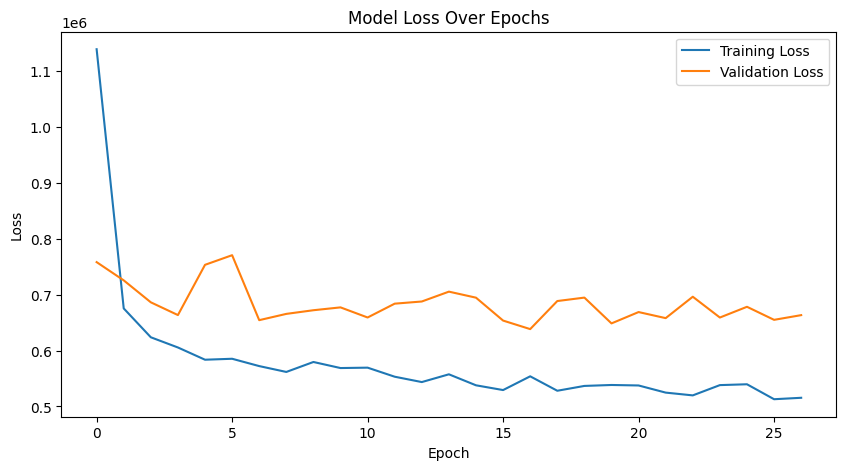

55/55 [==============================] - 0s 3ms/step


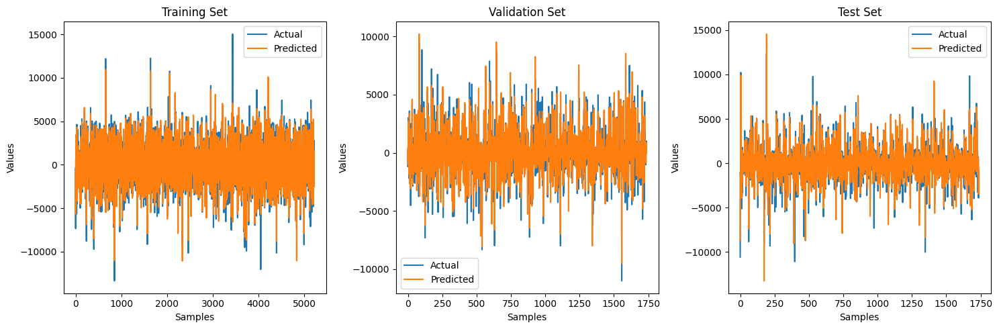

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss Over Epochs')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Predict values
y_train_pred = model.predict(X_train_flat)
y_val_pred = model.predict(X_val_flat)
y_test_pred = model.predict(X_test_flat)

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y_train, label='Actual')
plt.plot(y_train_pred, label='Predicted')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y_val, label='Actual')
plt.plot(y_val_pred, label='Predicted')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y_test, label='Actual')
plt.plot(y_test_pred, label='Predicted')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
test_metrics = calculate_metrics(y_test, y_test_pred)

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([test_metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it doesn't exist
results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Vector-Output MLP Model'] = metrics_df.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Vector-Output MLP Model,865.028608,553.934758,1020.920437


### 7.3.2 Multi-output MLP Model

In [ ]:

y1_train = y_train.reshape((y_train.shape[0], 1))
y1_val = y_val.reshape((y_val.shape[0], 1))
y1_test = y_test.reshape((y_test.shape[0], 1))

# Define model
visible = Input(shape=(n_input,))
dense = Dense(100, activation='relu')(visible)

# Define outputs
output1 = Dense(1)(dense)

# Tie together
model = Model(inputs=visible, outputs=output1)
model.compile(optimizer='adam', loss='mse')

# Fit the model
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history = model.fit(X_train_flat, y1_train, epochs=1000, verbose=1, validation_data=(X_val_flat, y1_val), callbacks=[early_stopping])


Epoch 1/1000
163/163 [==============================] - 3s 11ms/step - loss: 1128209.5000 - val_loss: 740651.1875
Epoch 2/1000
163/163 [==============================] - 2s 13ms/step - loss: 674196.3125 - val_loss: 687062.3125
Epoch 3/1000
163/163 [==============================] - 1s 8ms/step - loss: 622730.0000 - val_loss: 666128.2500
Epoch 4/1000
163/163 [==============================] - 1s 8ms/step - loss: 617110.8125 - val_loss: 634696.5000
Epoch 5/1000
163/163 [==============================] - 1s 7ms/step - loss: 597189.1250 - val_loss: 723337.4375
Epoch 6/1000
163/163 [==============================] - 2s 15ms/step - loss: 593711.8125 - val_loss: 738137.4375
Epoch 7/1000
163/163 [==============================] - 3s 20ms/step - loss: 577559.4375 - val_loss: 645680.6875
Epoch 8/1000
163/163 [==============================] - 2s 15ms/step - loss: 574364.9375 - val_loss: 638091.8750
Epoch 9/1000
163/163 [==============================] - 2s 15ms/step - loss: 585703.3125 - val_los

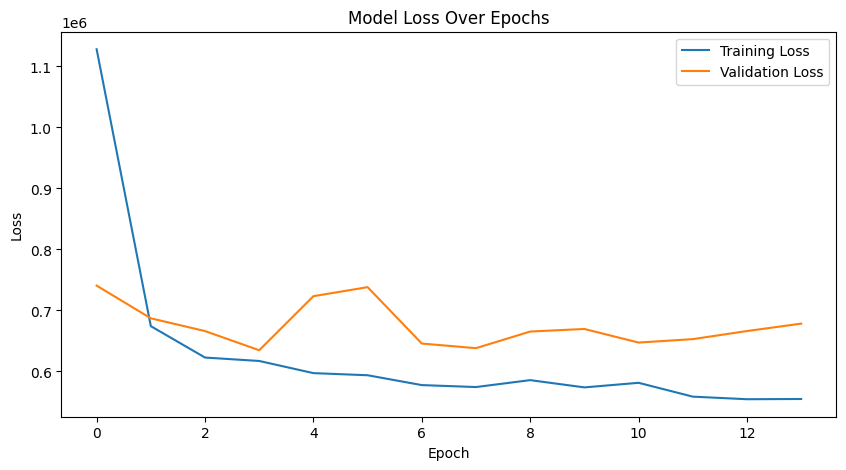

55/55 [==============================] - 0s 5ms/step


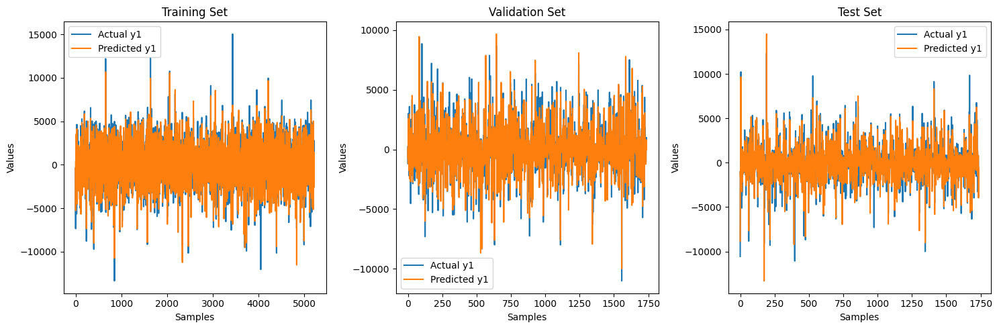

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss Over Epochs')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Predict values
y1_train_pred = model.predict(X_train_flat)
y1_val_pred = model.predict(X_val_flat)
y1_test_pred = model.predict(X_test_flat)

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y1_train, label='Actual y1')
plt.plot(y1_train_pred, label='Predicted y1')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y1_val, label='Actual y1')
plt.plot(y1_val_pred, label='Predicted y1')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y1_test, label='Actual y1')
plt.plot(y1_test_pred, label='Predicted y1')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
# Calculate metrics for the test predictions
test_metrics1 = calculate_metrics(y1_test, y1_test_pred)

# Create a DataFrame to hold the calculated metrics
metrics_df1 = pd.DataFrame([test_metrics1], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it doesn't exist
results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Multi-output MLP Model - y1'] = metrics_df1.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Multi-output MLP Model - y1,854.315724,549.168511,264.182002


## 7.4 Multi-step MLP Models

In [ ]:
# Function to split a univariate sequence into input/output samples
def split_sequence(sequence, n_steps_in, n_steps_out):
    X, y = [], []
    for i in range(len(sequence) - n_steps_in - n_steps_out + 1):
        # Define the end of the input sequence
        end_ix = i + n_steps_in
        # Define the end of the output sequence
        out_end_ix = end_ix + n_steps_out
        # Extract input and output sequences
        seq_x, seq_y = sequence[i:end_ix], sequence[end_ix:out_end_ix]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

# Define input sequences
raw_seq = hourly_data['PowerConsumption_Zone1_diff'].dropna().tolist()

# Choose a number of time steps
n_steps_in, n_steps_out = 24, 6  # Adjust as needed

# Split into samples
X, y = split_sequence(raw_seq, n_steps_in, n_steps_out)

# Split data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)   # 60% training, 40% temp
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)  # 20% validation, 20% test

# Print the shapes of the resulting arrays
print("Input shape:", X.shape)
print("Output shape:", y.shape)


Input shape: (8683, 24)
Output shape: (8683, 6)


In [ ]:
# Set the random seeds for reproducibility
np.random.seed(seed)
tf.random.set_seed(seed)
random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

# Flatten input for MLP
n_input = X.shape[1]
n_output = y.shape[1]

# Define the model
model = Sequential()
model.add(Dense(100, activation='relu', input_dim=n_input))
model.add(Dense(n_output))
model.compile(optimizer='adam', loss='mse')

# Fit the model
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history = model.fit(X_train, y_train, epochs=1000, verbose=1, validation_data=(X_val, y_val), callbacks=[early_stopping])


Epoch 1/1000
163/163 [==============================] - 3s 10ms/step - loss: 2244708.5000 - val_loss: 1961269.2500
Epoch 2/1000
163/163 [==============================] - 1s 8ms/step - loss: 1743058.3750 - val_loss: 1852645.0000
Epoch 3/1000
163/163 [==============================] - 1s 7ms/step - loss: 1654179.1250 - val_loss: 1771473.3750
Epoch 4/1000
163/163 [==============================] - 1s 8ms/step - loss: 1626463.6250 - val_loss: 1746278.8750
Epoch 5/1000
163/163 [==============================] - 1s 7ms/step - loss: 1588582.0000 - val_loss: 1735970.3750
Epoch 6/1000
163/163 [==============================] - 2s 11ms/step - loss: 1582038.1250 - val_loss: 1732460.8750
Epoch 7/1000
163/163 [==============================] - 2s 12ms/step - loss: 1562685.1250 - val_loss: 1735450.3750
Epoch 8/1000
163/163 [==============================] - 3s 17ms/step - loss: 1553931.5000 - val_loss: 1704118.6250
Epoch 9/1000
163/163 [==============================] - 1s 8ms/step - loss: 1532947.

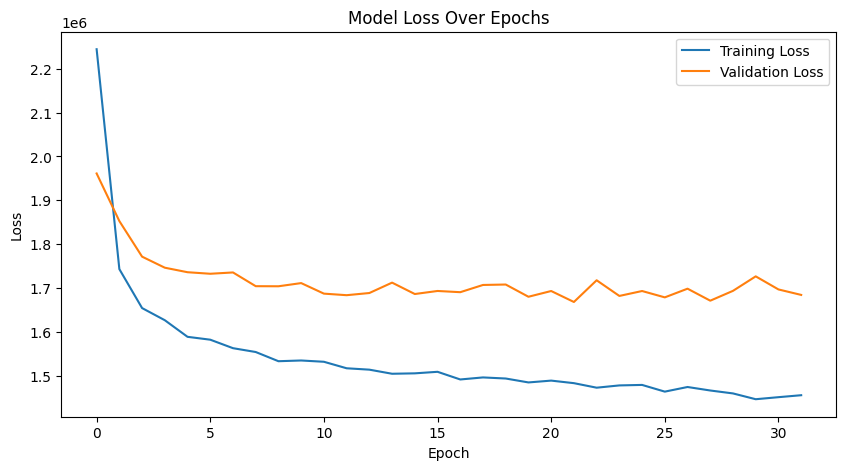

55/55 [==============================] - 0s 5ms/step


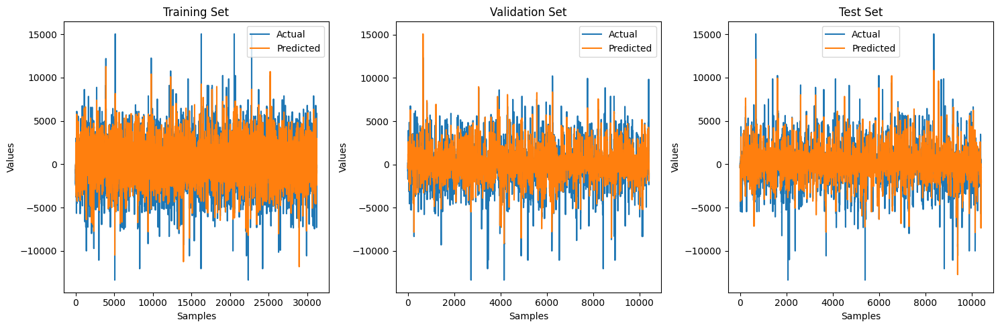

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss Over Epochs')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Predict values
y_train_pred = model.predict(X_train)
y_val_pred = model.predict(X_val)
y_test_pred = model.predict(X_test)

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y_train.flatten(), label='Actual')
plt.plot(y_train_pred.flatten(), label='Predicted')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y_val.flatten(), label='Actual')
plt.plot(y_val_pred.flatten(), label='Predicted')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y_test.flatten(), label='Actual')
plt.plot(y_test_pred.flatten(), label='Predicted')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()


In [ ]:
# Calculate metrics for the test predictions
test_metrics = calculate_metrics(y_test.flatten(), y_test_pred.flatten())

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([test_metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it doesn't exist
results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Multi-step MLP Model'] = metrics_df.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Multi-step MLP Model,1283.661656,863.067412,2.263134e+07


## 7.5 Multivariate Multi-step MLP Models

In [ ]:
def split_sequences(sequences, n_steps_in, n_steps_out):
    X, y = [], []
    for i in range(len(sequences) - n_steps_in - n_steps_out + 1):
        end_ix = i + n_steps_in
        out_end_ix = end_ix + n_steps_out
        # Extract input and output parts of the pattern
        seq_x = sequences[i:end_ix, :-1]
        seq_y = sequences[end_ix:out_end_ix, -1]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

# Define the number of time steps for input and output
n_steps_in, n_steps_out = 24, 6

# Convert dataset into input/output samples
X, y = split_sequences(dataset, n_steps_in, n_steps_out)

# Split data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)   # 60% training, 40% temp
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)  # 20% validation, 20% test

# Print the shapes of the resulting arrays
print("Input shape:", X.shape)
print("Output shape:", y.shape)

# Summarize the data by printing each input/output pair
for i in range(len(X)):
    print('='* 20)
    print(f"X[{i}]:\n{X[i]}, \ny[{i}]:\n{y[i]}")

# Flatten input for MLP
n_input = X.shape[1] * X.shape[2]
X_train_flat = X_train.reshape((X_train.shape[0], n_input))
X_val_flat = X_val.reshape((X_val.shape[0], n_input))
X_test_flat = X_test.reshape((X_test.shape[0], n_input))

# Flatten output
n_output = y.shape[1]
y_train_flat = y_train.reshape((y_train.shape[0], n_output))
y_val_flat = y_val.reshape((y_val.shape[0], n_output))
y_test_flat = y_test.reshape((y_test.shape[0], n_output))

Streaming output truncated to the last 5000 lines.
 [-2.22053235e+02 -6.24666667e+00]
 [-7.93916348e+02 -5.97666667e+00]
 [-9.36882127e+02 -5.33333333e+00]
 [-1.12750317e+03 -4.93833333e+00]
 [-2.42332065e+02 -4.44166667e+00]
 [ 1.35868187e+02 -3.66166667e+00]
 [ 5.43472752e+02 -4.27000000e+00]
 [ 1.82813688e+03 -2.41833333e+00]
 [ 1.05348543e+03 -1.23166667e+00]], 
y[8510]:
[ 874.67229333   56.41134167 -644.450705    141.21911     339.89502
  696.83249833]
X[8511]:
[[-1.83624842e+03  8.28333333e-01]
 [-1.77338403e+03  9.76666667e-01]
 [-2.07756654e+03  5.38333333e-01]
 [-1.65880862e+03 -4.30000000e-01]
 [-1.73789607e+03 -1.41666667e+00]
 [-8.44613435e+02 -2.36166667e+00]
 [-2.89987323e+02 -3.14166667e+00]
 [ 1.39923950e+02 -3.51500000e+00]
 [ 8.52724965e+02 -2.93500000e+00]
 [-6.79340917e+01 -3.58833333e+00]
 [ 1.31812420e+02 -3.52166667e+00]
 [-1.01393833e+00 -5.29166667e+00]
 [-5.87072245e+02 -6.17500000e+00]
 [-4.92775663e+02 -6.00333333e+00]
 [-2.22053235e+02 -6.24666667e+00]
 [-7

### 7.5.1 Multiple Input Multi-step Output Model

In [ ]:
# Set the random seeds for reproducibility
np.random.seed(seed)
tf.random.set_seed(seed)
random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

# Flatten input for MLP
n_input = X.shape[1] * X.shape[2]
X_train_flat = X_train.reshape((X_train.shape[0], n_input))
X_val_flat = X_val.reshape((X_val.shape[0], n_input))
X_test_flat = X_test.reshape((X_test.shape[0], n_input))

# Define the model
model = Sequential()
model.add(Dense(100, activation='relu', input_dim=n_input))
model.add(Dense(n_steps_out))
model.compile(optimizer='adam', loss='mse')

# Fit the model
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history = model.fit(X_train_flat, y_train, epochs=1000, verbose=1, validation_data=(X_val_flat, y_val), callbacks=[early_stopping])


Epoch 1/1000
163/163 [==============================] - 4s 16ms/step - loss: 2300702.0000 - val_loss: 2004969.7500
Epoch 2/1000
163/163 [==============================] - 2s 11ms/step - loss: 1761373.1250 - val_loss: 1881618.6250
Epoch 3/1000
163/163 [==============================] - 1s 7ms/step - loss: 1665964.2500 - val_loss: 1780216.6250
Epoch 4/1000
163/163 [==============================] - 1s 4ms/step - loss: 1636463.3750 - val_loss: 1752128.8750
Epoch 5/1000
163/163 [==============================] - 1s 6ms/step - loss: 1592199.2500 - val_loss: 1747756.2500
Epoch 6/1000
163/163 [==============================] - 1s 4ms/step - loss: 1581528.5000 - val_loss: 1734699.5000
Epoch 7/1000
163/163 [==============================] - 1s 4ms/step - loss: 1565824.1250 - val_loss: 1735980.6250
Epoch 8/1000
163/163 [==============================] - 1s 4ms/step - loss: 1559866.6250 - val_loss: 1707940.5000
Epoch 9/1000
163/163 [==============================] - 1s 4ms/step - loss: 1535095.25

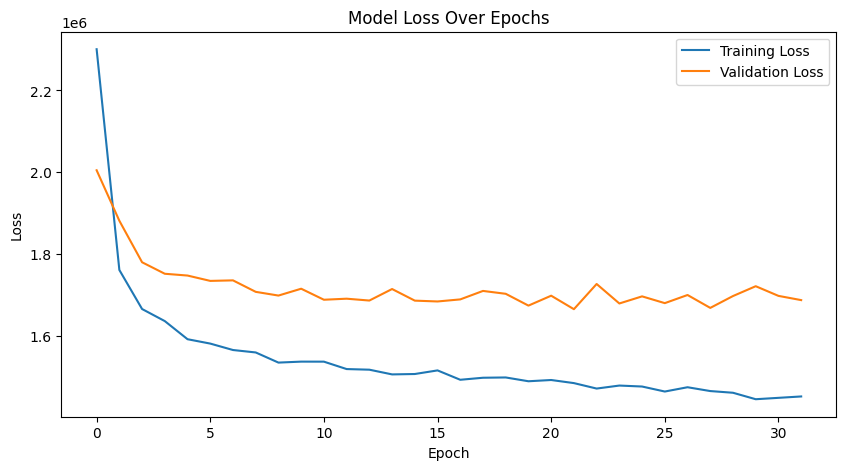

55/55 [==============================] - 0s 6ms/step


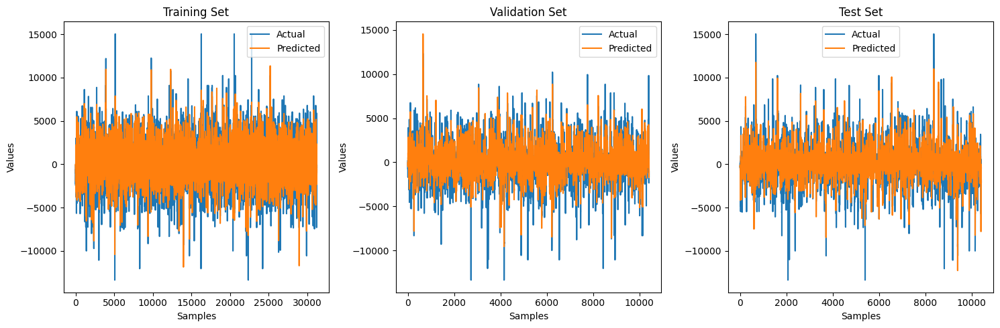

In [ ]:

# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss Over Epochs')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Predict values
y_train_pred = model.predict(X_train_flat)
y_val_pred = model.predict(X_val_flat)
y_test_pred = model.predict(X_test_flat)

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y_train.flatten(), label='Actual')
plt.plot(y_train_pred.flatten(), label='Predicted')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y_val.flatten(), label='Actual')
plt.plot(y_val_pred.flatten(), label='Predicted')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y_test.flatten(), label='Actual')
plt.plot(y_test_pred.flatten(), label='Predicted')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
# Calculate metrics for the test predictions
test_metrics = calculate_metrics(y_test.flatten(), y_test_pred.flatten())

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([test_metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it doesn't exist
results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Multiple Input Multi-step Output Model'] = metrics_df.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Multiple Input Multi-step Output Model,1277.96804,859.385412,519.999118


### 7.5.2 Multiple Parallel Input and Multi-step Output Model

In [ ]:
# Set the random seeds for reproducibility
seed = 42
np.random.seed(seed)
tf.random.set_seed(seed)
random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

# Define the model
model = Sequential()
model.add(Dense(100, activation='relu', input_dim=n_input))
model.add(Dense(n_output))
model.compile(optimizer='adam', loss='mse')

# Fit the model
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history = model.fit(X_train_flat, y_train_flat, epochs=1000, verbose=1, validation_data=(X_val_flat, y_val_flat), callbacks=[early_stopping])


Epoch 1/1000
163/163 [==============================] - 3s 10ms/step - loss: 2300702.0000 - val_loss: 2004969.7500
Epoch 2/1000
163/163 [==============================] - 1s 7ms/step - loss: 1761373.1250 - val_loss: 1881618.6250
Epoch 3/1000
163/163 [==============================] - 1s 7ms/step - loss: 1665964.2500 - val_loss: 1780216.6250
Epoch 4/1000
163/163 [==============================] - 1s 7ms/step - loss: 1636463.3750 - val_loss: 1752128.8750
Epoch 5/1000
163/163 [==============================] - 1s 7ms/step - loss: 1592199.2500 - val_loss: 1747756.2500
Epoch 6/1000
163/163 [==============================] - 1s 8ms/step - loss: 1581528.5000 - val_loss: 1734699.5000
Epoch 7/1000
163/163 [==============================] - 1s 7ms/step - loss: 1565824.1250 - val_loss: 1735980.6250
Epoch 8/1000
163/163 [==============================] - 2s 11ms/step - loss: 1559866.6250 - val_loss: 1707940.5000
Epoch 9/1000
163/163 [==============================] - 2s 12ms/step - loss: 1535095.2

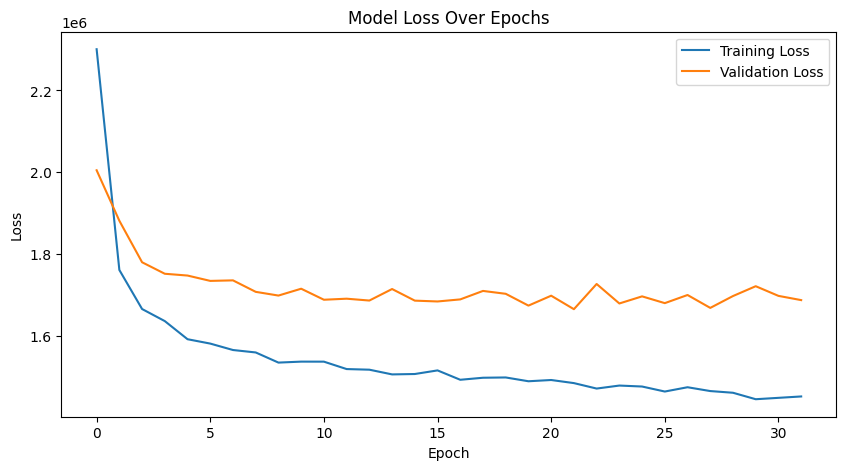

55/55 [==============================] - 0s 4ms/step


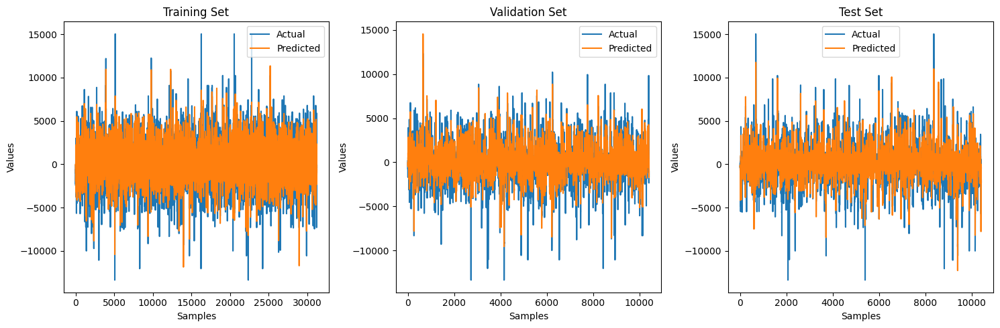

In [ ]:

# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss Over Epochs')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Predict values
y_train_pred = model.predict(X_train_flat)
y_val_pred = model.predict(X_val_flat)
y_test_pred = model.predict(X_test_flat)

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y_train_flat.flatten(), label='Actual')
plt.plot(y_train_pred.flatten(), label='Predicted')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y_val_flat.flatten(), label='Actual')
plt.plot(y_val_pred.flatten(), label='Predicted')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y_test_flat.flatten(), label='Actual')
plt.plot(y_test_pred.flatten(), label='Predicted')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
test_metrics = calculate_metrics(y_test_flat.flatten(), y_test_pred.flatten())

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([test_metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it doesn't exist
results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Multiple Parallel Input and Multi-step Output Model'] = metrics_df.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Multiple Parallel Input and Multi-step Output Model,1277.96804,859.385412,519.999118


# 8. A Convolutional Neural Network (CNNs) Models

**1. Multivariate CNN - Multiple Input Series**
- This model handles multiple time series (multivariate) data where each input series is fed into a separate CNN branch.
- When multiple related time series are prepared (e.g., temperature, humidity, and wind speed in my project case) and want to model their interactions.

**2. Multi-headed CNN Model**
- Multivariate CNNs but with distinct heads for different input features or series, which allows specialized feature extraction before merging.
- When different input series have significantly different characteristics and require separate preprocessing or feature extraction.

**3. Multiple Parallel Series**
- This involves modeling multiple time series in parallel, and it treats each as an independent input to the CNN.
- When forecasting several independent but related time series simultaneously is needed.

**4. Multi-output CNN Model**
- A single CNN model that outputs multiple predictions for different time series.
- When predicting multiple related outputs from a single set of inputs is needed.

**5. Multi-step CNN Models**
- These models predict multiple future steps (time points) for a single time series.
- When forecasting a time series multiple steps ahead is needed.

**6. Multivariate Multi-step CNN Models**
- Combines multivariate inputs with multi-step outputs, predicting multiple future steps for multiple input series.
- When there are several time series and need to predict multiple future steps for each series.

**7. Multiple Input Multi-step Output**
- It is like multivariate multi-step models but may refer to a more generalized form where inputs can come from different sources or formats, not just multiple time series.
- When inputs are diverse and need to be processed differently before predicting multiple future steps.

**8. Multiple Parallel Input and Multi-step Output**
- Combines multiple parallel input series with multi-step outputs, and it forcusts multiple future steps for each parallel input.
- When there are multiple independent but related time series and needed to be  predicted their future values simultaneously over multiple steps.


In [ ]:
df = pd.read_csv('powerconsumption.csv')
df = df.set_index('Datetime')
df.index = pd.to_datetime(df.index)
df.head()

,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3
Datetime,,,,,,,,
2017-01-01 00:00:00,6.559,73.8,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386
2017-01-01 00:10:00,6.414,74.5,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434
2017-01-01 00:20:00,6.313,74.5,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373
2017-01-01 00:30:00,6.121,75.0,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711
2017-01-01 00:40:00,5.921,75.7,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964


In [ ]:
df.head()

,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3
Datetime,,,,,,,,
2017-01-01 00:00:00,6.559,73.8,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386
2017-01-01 00:10:00,6.414,74.5,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434
2017-01-01 00:20:00,6.313,74.5,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373
2017-01-01 00:30:00,6.121,75.0,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711
2017-01-01 00:40:00,5.921,75.7,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964


In [ ]:
df_daily = df.PowerConsumption_Zone1.resample('D').sum()


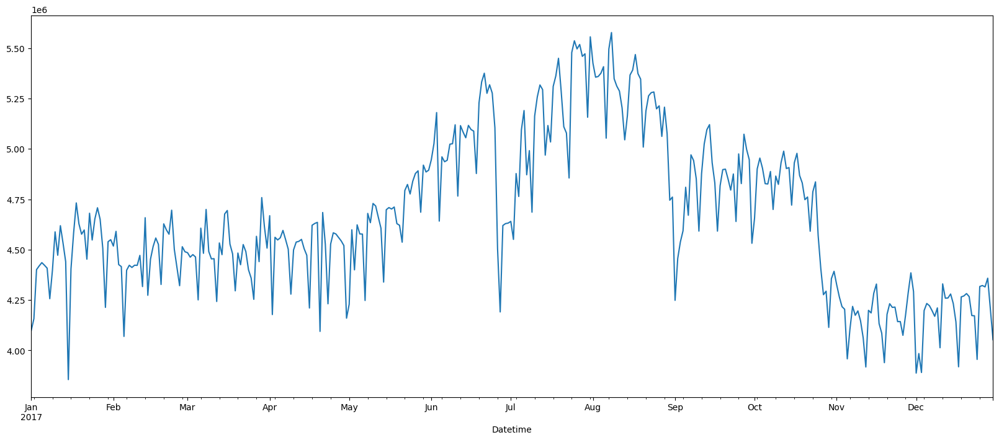

In [ ]:
df_daily.plot(figsize=(20, 8));

In [ ]:
def feature_engineering(dataframe):
    """
    Create time-based features from the datetime index of the DataFrame.

    Parameters:
    dataframe (DataFrame): The input DataFrame with a datetime index.

    Returns:
    DataFrame: A new DataFrame with additional time-based features.
    """
    new_df = dataframe.copy()  # Create a copy of the DataFrame to avoid modifying the original
    new_df['dayofweek'] = dataframe.index.dayofweek
    new_df['quarter'] = dataframe.index.quarter
    new_df['month'] = dataframe.index.month
    new_df['year'] = dataframe.index.year
    new_df['dayofyear'] = dataframe.index.dayofyear
    return new_df

# Apply the feature creation function to the DataFrame
df_eng = feature_engineering(df_daily.to_frame())

In [ ]:
df_eng

,PowerConsumption_Zone1,dayofweek,quarter,month,year,dayofyear
Datetime,,,,,,
2017-01-01,4.098993e+06,6,1,1,2017,1
2017-01-02,4.157207e+06,0,1,1,2017,2
2017-01-03,4.400992e+06,1,1,1,2017,3
2017-01-04,4.419336e+06,2,1,1,2017,4
2017-01-05,4.435619e+06,3,1,1,2017,5
...,...,...,...,...,...,...
2017-12-26,4.321941e+06,1,4,12,2017,360
2017-12-27,4.315243e+06,2,4,12,2017,361
2017-12-28,4.358449e+06,3,4,12,2017,362


In [ ]:
from sklearn.preprocessing import StandardScaler

# Load data
data = pd.read_csv('powerconsumption.csv', parse_dates=['Datetime'], index_col='Datetime')

# Downsample the data to an hourly frequency
hourly_data = data.resample('H').mean()

# Compute seasonal differencing of 24 hours for 'PowerConsumption_Zone1' and 'Temperature' columns
hourly_data['PowerConsumption_Zone1_diff'] = hourly_data['PowerConsumption_Zone1'].diff(24)
hourly_data['Temperature_diff'] = hourly_data['Temperature'].diff(24)

# Drop NA values
hourly_data = hourly_data.dropna()

# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(hourly_data[['PowerConsumption_Zone1_diff', 'Temperature_diff']])

# Function to split the data into sequences
def create_multivariate_data(scaled_data, window_size, target_index):
    X, y = [], []
    for i in range(len(scaled_data) - window_size):
        X.append(scaled_data[i:i + window_size])
        y.append(scaled_data[i + window_size][target_index])
    return np.array(X), np.array(y)

# Define the target column index
target_index = 0  # Index for 'PowerConsumption_Zone1_diff'

# Create multivariate data
window_size = 24  # Using 24 hours as the window size
X, y = create_multivariate_data(scaled_data, window_size, target_index)

# Split the data into training, validation, and test sets (60% train, 20% val, 20% test)
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Reshape for Conv1D
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], X_train.shape[2]))
X_val = X_val.reshape((X_val.shape[0], X_val.shape[1], X_val.shape[2]))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], X_test.shape[2]))

# Print the shapes after reshaping
print("Shapes after reshaping:")
print("X_train:", X_train.shape)
print("X_val:", X_val.shape)
print("X_test:", X_test.shape)


Shapes after reshaping:
X_train: (5212, 24, 2)
X_val: (1738, 24, 2)
X_test: (1738, 24, 2)


## 8.1 Univariate Convolutional Neural Network Models

In [ ]:
# Set the random seeds for reproducibility
seed = 42
np.random.seed(seed)
tf.random.set_seed(seed)
random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

# Define the univariate CNN model
model_uni_cnn = Sequential()
model_uni_cnn.add(Conv1D(filters=64, kernel_size=2, activation='relu', input_shape=(window_size, 1)))
model_uni_cnn.add(Flatten())
model_uni_cnn.add(Dense(100, activation='relu'))
model_uni_cnn.add(Dense(1))
model_uni_cnn.compile(optimizer='adam', loss='mse')

# Fit the model
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history_uni_cnn = model_uni_cnn.fit(X_train[:, :, 0].reshape(-1, window_size, 1), y_train, epochs=1000, verbose=1, validation_data=(X_val[:, :, 0].reshape(-1, window_size, 1), y_val), callbacks=[early_stopping])


Epoch 1/1000
163/163 [==============================] - 5s 22ms/step - loss: 0.2408 - val_loss: 0.1834
Epoch 2/1000
163/163 [==============================] - 3s 19ms/step - loss: 0.1652 - val_loss: 0.1933
Epoch 3/1000
163/163 [==============================] - 3s 16ms/step - loss: 0.1584 - val_loss: 0.1738
Epoch 4/1000
163/163 [==============================] - 2s 14ms/step - loss: 0.1565 - val_loss: 0.1721
Epoch 5/1000
163/163 [==============================] - 2s 14ms/step - loss: 0.1514 - val_loss: 0.1799
Epoch 6/1000
163/163 [==============================] - 2s 14ms/step - loss: 0.1501 - val_loss: 0.1989
Epoch 7/1000
163/163 [==============================] - 3s 19ms/step - loss: 0.1438 - val_loss: 0.1753
Epoch 8/1000
163/163 [==============================] - 3s 20ms/step - loss: 0.1402 - val_loss: 0.1729
Epoch 9/1000
163/163 [==============================] - 2s 14ms/step - loss: 0.1403 - val_loss: 0.1766
Epoch 10/1000
163/163 [==============================] - 2s 9ms/step - lo

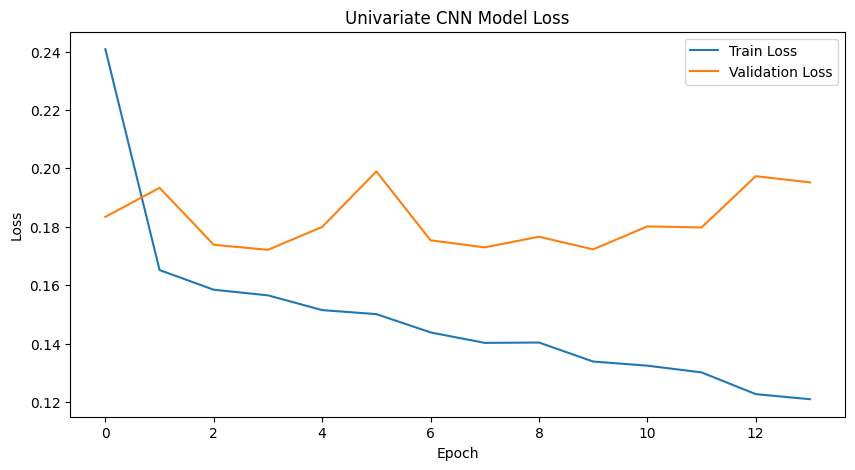

55/55 [==============================] - 0s 6ms/step


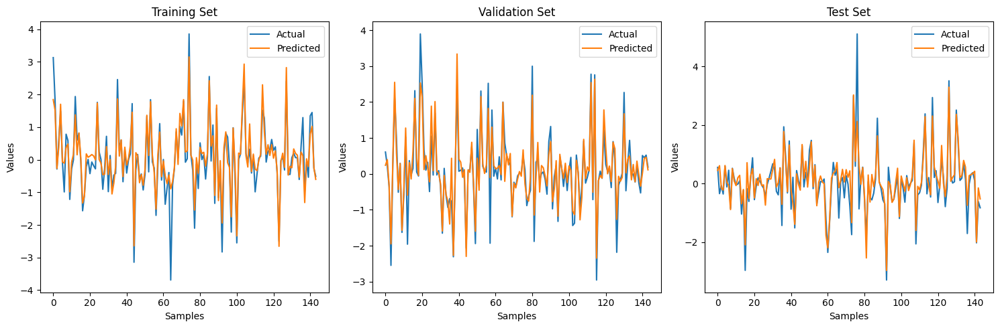

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history_uni_cnn.history['loss'], label='Train Loss')
plt.plot(history_uni_cnn.history['val_loss'], label='Validation Loss')
plt.title('Univariate CNN Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Predict values
y_train_pred = model_uni_cnn.predict(X_train[:, :, 0].reshape(-1, window_size, 1))
y_val_pred = model_uni_cnn.predict(X_val[:, :, 0].reshape(-1, window_size, 1))
y_test_pred = model_uni_cnn.predict(X_test[:, :, 0].reshape(-1, window_size, 1))

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y_train[-6*24:], label='Actual')
plt.plot(y_train_pred[-6*24:], label='Predicted')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y_val[-6*24:], label='Actual')
plt.plot(y_val_pred[-6*24:], label='Predicted')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y_test[-6*24:], label='Actual')
plt.plot(y_test_pred[-6*24:], label='Predicted')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
test_metrics = calculate_metrics(y_test, y_test_pred)

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([test_metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it doesn't exist
results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Univariate CNN Model'] = metrics_df.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Univariate CNN Model,0.438312,0.280174,1405.579463


## 8.2 Multivariate CNN Models

### 8.2.1 Multiple Input Series
Multi-headed CNN Model

In [ ]:
# Extract different feature columns for multi-headed CNN
X1 = X[:, :, 0].reshape(-1, window_size, 1)
X2 = X[:, :, 1].reshape(-1, window_size, 1)

# Split data into training, validation, and test sets (60% training, 20% validation, 20% testing)
X1_train, X1_temp, y_train, y_temp = train_test_split(X1, y, test_size=0.4, random_state=seed)
X1_val, X1_test, y_val, y_test = train_test_split(X1_temp, y_temp, test_size=0.5, random_state=seed)

X2_train, X2_temp, _, _ = train_test_split(X2, y, test_size=0.4, random_state=seed)
X2_val, X2_test, _, _ = train_test_split(X2_temp, y_temp, test_size=0.5, random_state=seed)

# First input model
visible1 = Input(shape=(window_size, 1))
conv1 = Conv1D(filters=64, kernel_size=2, activation='relu')(visible1)
flat1 = Flatten()(conv1)

# Second input model
visible2 = Input(shape=(window_size, 1))
conv2 = Conv1D(filters=64, kernel_size=2, activation='relu')(visible2)
flat2 = Flatten()(conv2)

# Merge input models
merged = concatenate([flat1, flat2])
dense1 = Dense(100, activation='relu')(merged)
output = Dense(1)(dense1)

# Create and compile the model
model_multi_head = Model(inputs=[visible1, visible2], outputs=output)
model_multi_head.compile(optimizer='adam', loss='mse')

# Fit the model
history_multi_head = model_multi_head.fit([X1_train, X2_train], y_train, epochs=1000, verbose=1, validation_data=([X1_val, X2_val], y_val), callbacks=[early_stopping])


Epoch 1/1000
163/163 [==============================] - 8s 23ms/step - loss: 0.2612 - val_loss: 0.1813
Epoch 2/1000
163/163 [==============================] - 4s 26ms/step - loss: 0.1654 - val_loss: 0.2087
Epoch 3/1000
163/163 [==============================] - 4s 25ms/step - loss: 0.1573 - val_loss: 0.1745
Epoch 4/1000
163/163 [==============================] - 4s 23ms/step - loss: 0.1514 - val_loss: 0.1729
Epoch 5/1000
163/163 [==============================] - 3s 19ms/step - loss: 0.1440 - val_loss: 0.1827
Epoch 6/1000
163/163 [==============================] - 2s 13ms/step - loss: 0.1419 - val_loss: 0.1989
Epoch 7/1000
163/163 [==============================] - 2s 11ms/step - loss: 0.1336 - val_loss: 0.1822
Epoch 8/1000
163/163 [==============================] - 2s 12ms/step - loss: 0.1288 - val_loss: 0.1850
Epoch 9/1000
163/163 [==============================] - 3s 18ms/step - loss: 0.1290 - val_loss: 0.1854
Epoch 10/1000
163/163 [==============================] - 2s 15ms/step - l

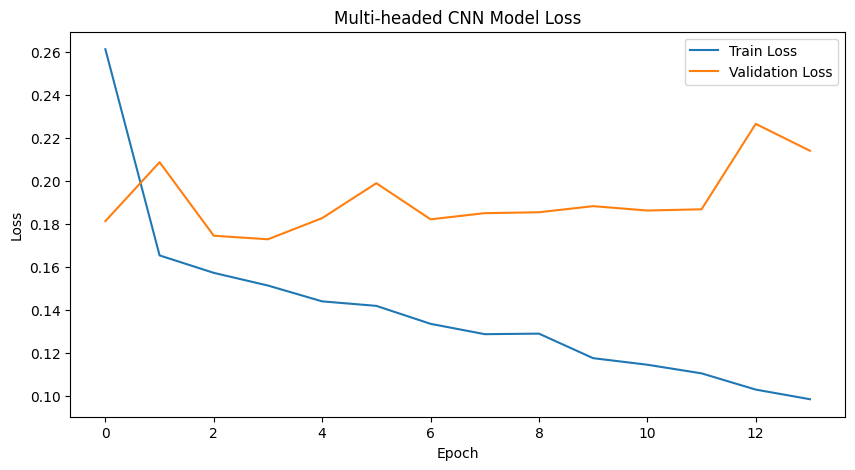

55/55 [==============================] - 0s 7ms/step


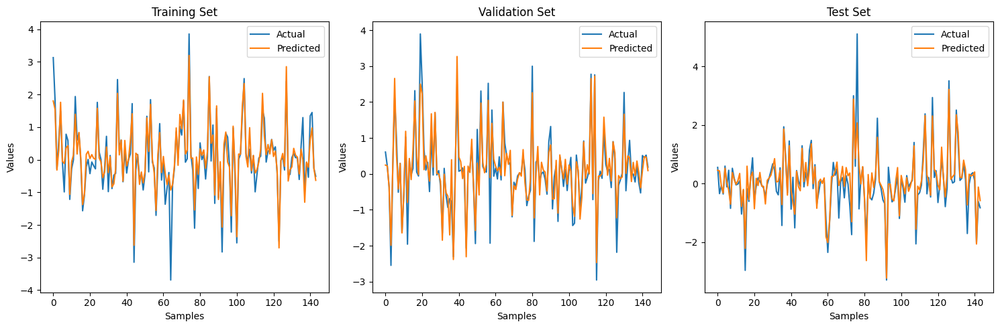

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history_multi_head.history['loss'], label='Train Loss')
plt.plot(history_multi_head.history['val_loss'], label='Validation Loss')
plt.title('Multi-headed CNN Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Predict values
y_train_pred = model_multi_head.predict([X1_train, X2_train])
y_val_pred = model_multi_head.predict([X1_val, X2_val])
y_test_pred = model_multi_head.predict([X1_test, X2_test])

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y_train[-6*24:], label='Actual')
plt.plot(y_train_pred[-6*24:], label='Predicted')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y_val[-6*24:], label='Actual')
plt.plot(y_val_pred[-6*24:], label='Predicted')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y_test[-6*24:], label='Actual')
plt.plot(y_test_pred[-6*24:], label='Predicted')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()


In [ ]:

# Calculate metrics for the test predictions
test_metrics = calculate_metrics(y_test, y_test_pred)

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([test_metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Multi-headed CNN Model'] = metrics_df.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Univariate CNN Model,0.438312,0.280174,1405.579463
Multi-headed CNN Model,0.439883,0.281694,1409.133437


### 8.2.2 Multiple Parallel Series
Multi-output CNN Model

In [ ]:
# Function to split the data into sequences
def create_multivariate_data(scaled_data, window_size, target_index):
    X, y = [], []
    for i in range(len(scaled_data) - window_size):
        X.append(scaled_data[i:i + window_size])
        y.append(scaled_data[i + window_size][target_index])
    return np.array(X), np.array(y)

# Define the target column index
target_index = 0  # Index for 'PowerConsumption_Zone1_diff'

# Create multivariate data
window_size = 24  # Using 24 hours as the window size
X, y = create_multivariate_data(scaled_data, window_size, target_index)

# Split the data into training, validation, and test sets (60% train, 20% val, 20% test)
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Reshape for Conv1D
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], X_train.shape[2]))
X_val = X_val.reshape((X_val.shape[0], X_val.shape[1], X_val.shape[2]))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], X_test.shape[2]))

# Print the shapes after reshaping
print("Shapes after reshaping:")
print("X_train:", X_train.shape)
print("X_val:", X_val.shape)
print("X_test:", X_test.shape)

# Define the multi-output CNN model
model_multi_output = Sequential()
model_multi_output.add(Conv1D(filters=64, kernel_size=2, activation='relu', input_shape=(window_size, X_train.shape[2])))
model_multi_output.add(Flatten())
model_multi_output.add(Dense(100, activation='relu'))
model_multi_output.add(Dense(1))  # Output layer with 1 neuron for the target value
model_multi_output.compile(optimizer='adam', loss='mse')

# Fit the model
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history_multi_output = model_multi_output.fit(X_train, y_train, epochs=1000, verbose=1, validation_data=(X_val, y_val), callbacks=[early_stopping])

Shapes after reshaping:
X_train: (5212, 24, 2)
X_val: (1738, 24, 2)
X_test: (1738, 24, 2)
Epoch 1/1000
163/163 [==============================] - 4s 16ms/step - loss: 0.2966 - val_loss: 0.2161
Epoch 2/1000
163/163 [==============================] - 4s 24ms/step - loss: 0.1729 - val_loss: 0.1881
Epoch 3/1000
163/163 [==============================] - 3s 20ms/step - loss: 0.1609 - val_loss: 0.1807
Epoch 4/1000
163/163 [==============================] - 4s 23ms/step - loss: 0.1550 - val_loss: 0.1725
Epoch 5/1000
163/163 [==============================] - 3s 21ms/step - loss: 0.1477 - val_loss: 0.1886
Epoch 6/1000
163/163 [==============================] - 3s 16ms/step - loss: 0.1463 - val_loss: 0.1989
Epoch 7/1000
163/163 [==============================] - 4s 23ms/step - loss: 0.1409 - val_loss: 0.1804
Epoch 8/1000
163/163 [==============================] - 4s 24ms/step - loss: 0.1362 - val_loss: 0.1844
Epoch 9/1000
163/163 [==============================] - 2s 14ms/step - loss: 0.1332 - 

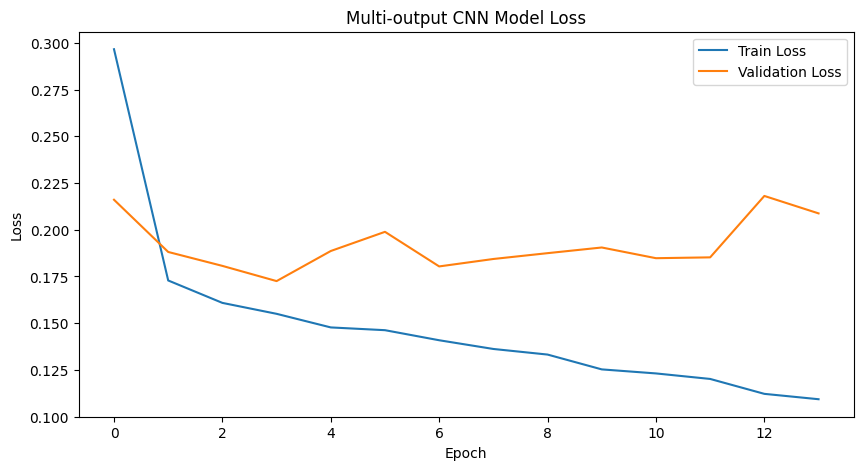

55/55 [==============================] - 0s 7ms/step


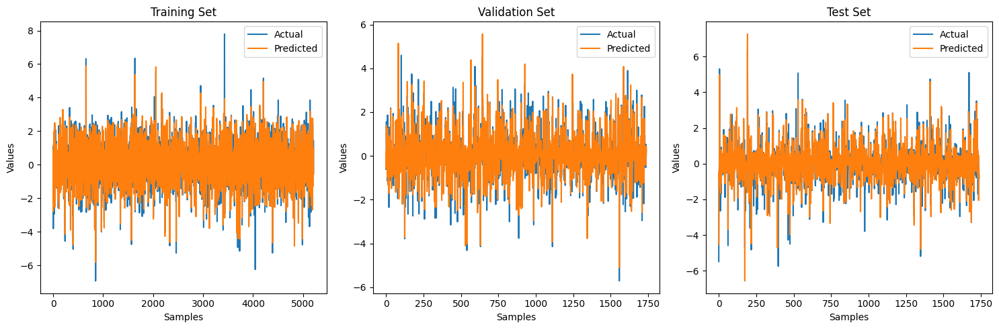

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history_multi_output.history['loss'], label='Train Loss')
plt.plot(history_multi_output.history['val_loss'], label='Validation Loss')
plt.title('Multi-output CNN Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Predict values
y_train_pred = model_multi_output.predict(X_train)
y_val_pred = model_multi_output.predict(X_val)
y_test_pred = model_multi_output.predict(X_test)

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y_train.flatten(), label='Actual')
plt.plot(y_train_pred.flatten(), label='Predicted')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y_val.flatten(), label='Actual')
plt.plot(y_val_pred.flatten(), label='Predicted')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y_test.flatten(), label='Actual')
plt.plot(y_test_pred.flatten(), label='Predicted')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:

# Calculate metrics for the test predictions
test_metrics = calculate_metrics(y_test, y_test_pred)

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([test_metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Multi-output CNN Model'] = metrics_df.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Univariate CNN Model,0.438312,0.280174,1405.579463
Multi-headed CNN Model,0.439883,0.281694,1409.133437
Multi-output CNN Model,0.438991,0.279101,1418.606299


## 8.3 Multi-step CNN Models

In [ ]:
# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(hourly_data[['PowerConsumption_Zone1_diff']])

# Function to split a univariate sequence into input/output samples
def split_sequence(sequence, n_steps_in, n_steps_out):
    X, y = [], []
    for i in range(len(sequence) - n_steps_in - n_steps_out + 1):
        # Define the end of the input sequence
        end_ix = i + n_steps_in
        # Define the end of the output sequence
        out_end_ix = end_ix + n_steps_out
        # Extract input and output sequences
        seq_x, seq_y = sequence[i:end_ix], sequence[end_ix:out_end_ix]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

# Define input sequences
raw_seq = scaled_data[:, 0].tolist()

# Choose a number of time steps
n_steps_in, n_steps_out = 24, 6  # Adjust as needed

# Split into samples
X, y = split_sequence(raw_seq, n_steps_in, n_steps_out)

# Split data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)   # 60% training, 40% temp
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)  # 20% validation, 20% test

# Print the shapes of the resulting arrays
print("Input shape:", X.shape)
print("Output shape:", y.shape)

Input shape: (8683, 24)
Output shape: (8683, 6)


In [ ]:
# Set the random seeds for reproducibility
np.random.seed(seed)
tf.random.set_seed(seed)
random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

# Define the multi-step CNN model
model_multi_step = Sequential()
model_multi_step.add(Conv1D(filters=64, kernel_size=2, activation='relu', input_shape=(n_steps_in, 1)))
model_multi_step.add(Flatten())
model_multi_step.add(Dense(100, activation='relu'))
model_multi_step.add(Dense(n_steps_out))
model_multi_step.compile(optimizer='adam', loss='mse')

# Fit the model
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history_multi_step = model_multi_step.fit(X_train.reshape(-1, n_steps_in, 1), y_train, epochs=1000, verbose=1, validation_data=(X_val.reshape(-1, n_steps_in, 1), y_val), callbacks=[early_stopping])


Epoch 1/1000
163/163 [==============================] - 2s 9ms/step - loss: 0.5022 - val_loss: 0.4794
Epoch 2/1000
163/163 [==============================] - 1s 9ms/step - loss: 0.4316 - val_loss: 0.4579
Epoch 3/1000
163/163 [==============================] - 2s 12ms/step - loss: 0.4099 - val_loss: 0.4463
Epoch 4/1000
163/163 [==============================] - 2s 14ms/step - loss: 0.4076 - val_loss: 0.4538
Epoch 5/1000
163/163 [==============================] - 3s 21ms/step - loss: 0.3941 - val_loss: 0.4377
Epoch 6/1000
163/163 [==============================] - 3s 21ms/step - loss: 0.3827 - val_loss: 0.4300
Epoch 7/1000
163/163 [==============================] - 3s 19ms/step - loss: 0.3737 - val_loss: 0.4394
Epoch 8/1000
163/163 [==============================] - 2s 14ms/step - loss: 0.3711 - val_loss: 0.4352
Epoch 9/1000
163/163 [==============================] - 3s 18ms/step - loss: 0.3578 - val_loss: 0.4292
Epoch 10/1000
163/163 [==============================] - 2s 10ms/step - los

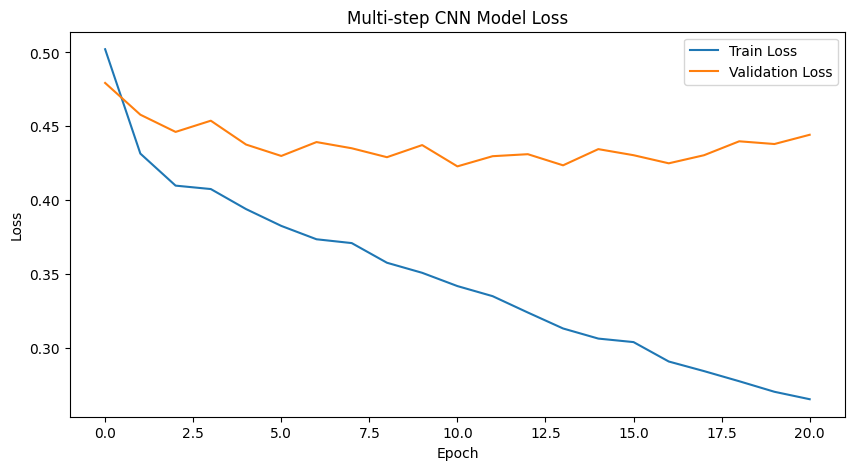

55/55 [==============================] - 0s 6ms/step


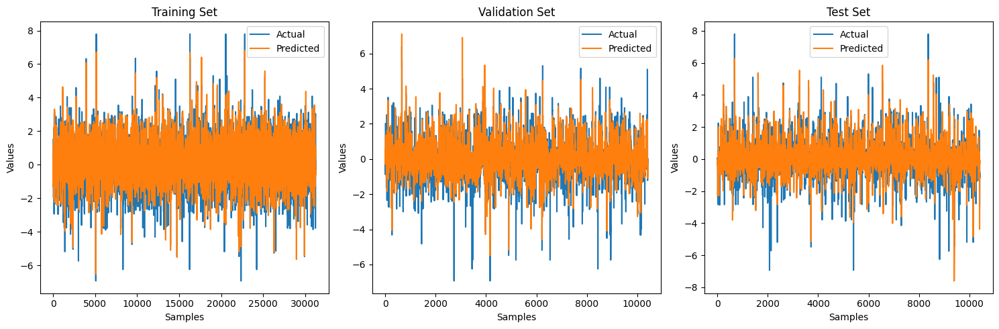

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history_multi_step.history['loss'], label='Train Loss')
plt.plot(history_multi_step.history['val_loss'], label='Validation Loss')
plt.title('Multi-step CNN Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Predict values
y_train_pred = model_multi_step.predict(X_train.reshape(-1, n_steps_in, 1))
y_val_pred = model_multi_step.predict(X_val.reshape(-1, n_steps_in, 1))
y_test_pred = model_multi_step.predict(X_test.reshape(-1, n_steps_in, 1))

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y_train.flatten(), label='Actual')
plt.plot(y_train_pred.flatten(), label='Predicted')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y_val.flatten(), label='Actual')
plt.plot(y_val_pred.flatten(), label='Predicted')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y_test.flatten(), label='Actual')
plt.plot(y_test_pred.flatten(), label='Predicted')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
# Calculate metrics for the test predictions
test_metrics = calculate_metrics(y_test.flatten(), y_test_pred.flatten())

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([test_metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it doesn't exist
results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Multi-step CNN Model'] = metrics_df.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Multi-step CNN Model,0.65302,0.434081,518.582231


## 8.4 Multivariate Multi-step CNN Models

### 8.4.1 Multiple Input Multi-step Output

In [ ]:
# Load data
data = pd.read_csv('powerconsumption.csv', parse_dates=['Datetime'], index_col='Datetime')

# Downsample the data to an hourly frequency
hourly_data = data.resample('H').mean()

# Compute seasonal differencing of 24 hours for 'PowerConsumption_Zone1' and 'Temperature' columns
hourly_data['PowerConsumption_Zone1_diff'] = hourly_data['PowerConsumption_Zone1'].diff(24)
hourly_data['Temperature_diff'] = hourly_data['Temperature'].diff(24)

# Drop NA values
hourly_data = hourly_data.dropna()

# Standardize the data
scaler_X = StandardScaler()
scaler_y = StandardScaler()

scaled_X = scaler_X.fit_transform(hourly_data[['PowerConsumption_Zone1_diff', 'Temperature_diff']])
scaled_y = scaler_y.fit_transform(hourly_data[['PowerConsumption_Zone1_diff']])

# Function to split a multivariate sequence into input/output samples
def split_sequences_multistep(sequences_X, sequences_y, n_steps_in, n_steps_out):
    X, y = [], []
    for i in range(len(sequences_X) - n_steps_in - n_steps_out + 1):
        end_ix = i + n_steps_in
        out_end_ix = end_ix + n_steps_out
        # Extract input and output parts of the pattern
        seq_x, seq_y = sequences_X[i:end_ix, :], sequences_y[end_ix:out_end_ix]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

# Choose a number of time steps for input and output
n_steps_in, n_steps_out = 24, 6  # Adjust as needed

# Split into samples
X, y = split_sequences_multistep(scaled_X, scaled_y, n_steps_in, n_steps_out)

# Split data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)   # 60% training, 40% temp
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)  # 20% validation, 20% test

# Print the shapes of the resulting arrays
print("Input shape:", X.shape)
print("Output shape:", y.shape)

Input shape: (8683, 24, 2)
Output shape: (8683, 6, 1)


In [ ]:
# Set the random seeds for reproducibility
seed = 42
np.random.seed(seed)
tf.random.set_seed(seed)
random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

# Define the multi-step CNN model
model_multi_parallel_step = Sequential()
model_multi_parallel_step.add(Conv1D(filters=64, kernel_size=2, activation='relu', input_shape=(n_steps_in, X_train.shape[2])))
model_multi_parallel_step.add(Conv1D(filters=64, kernel_size=2, activation='relu'))
model_multi_parallel_step.add(Flatten())
model_multi_parallel_step.add(Dense(100, activation='relu'))
model_multi_parallel_step.add(Dense(n_steps_out))  # Ensure this matches the shape of y
model_multi_parallel_step.compile(optimizer='adam', loss='mse')

# Fit the model
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history_multi_parallel_step = model_multi_parallel_step.fit(
    X_train, y_train,
    epochs=1000, batch_size=32, verbose=1,
    validation_data=(X_val, y_val),
    callbacks=[early_stopping]
)

Epoch 1/1000
163/163 [==============================] - 5s 21ms/step - loss: 0.5333 - val_loss: 0.5019
Epoch 2/1000
163/163 [==============================] - 4s 26ms/step - loss: 0.4337 - val_loss: 0.4702
Epoch 3/1000
163/163 [==============================] - 4s 25ms/step - loss: 0.4018 - val_loss: 0.4535
Epoch 4/1000
163/163 [==============================] - 3s 20ms/step - loss: 0.3864 - val_loss: 0.4503
Epoch 5/1000
163/163 [==============================] - 3s 20ms/step - loss: 0.3711 - val_loss: 0.4369
Epoch 6/1000
163/163 [==============================] - 3s 20ms/step - loss: 0.3475 - val_loss: 0.4319
Epoch 7/1000
163/163 [==============================] - 4s 25ms/step - loss: 0.3316 - val_loss: 0.4440
Epoch 8/1000
163/163 [==============================] - 4s 27ms/step - loss: 0.3159 - val_loss: 0.4366
Epoch 9/1000
163/163 [==============================] - 4s 22ms/step - loss: 0.2952 - val_loss: 0.4323
Epoch 10/1000
163/163 [==============================] - 3s 21ms/step - l

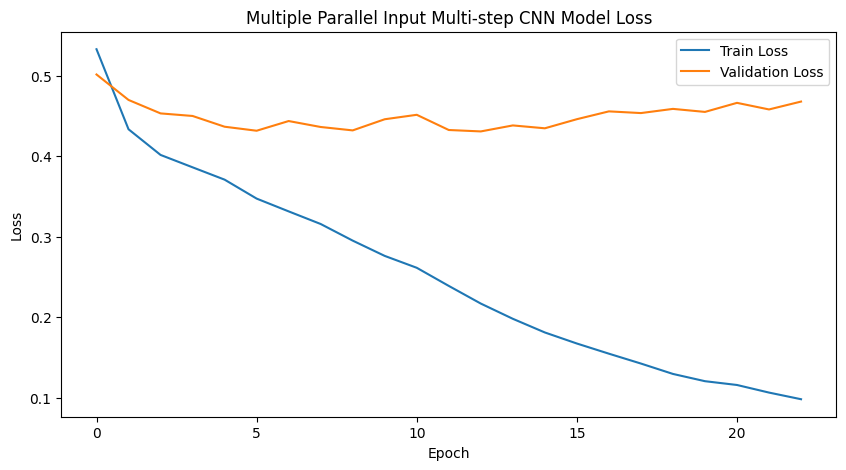

55/55 [==============================] - 0s 7ms/step


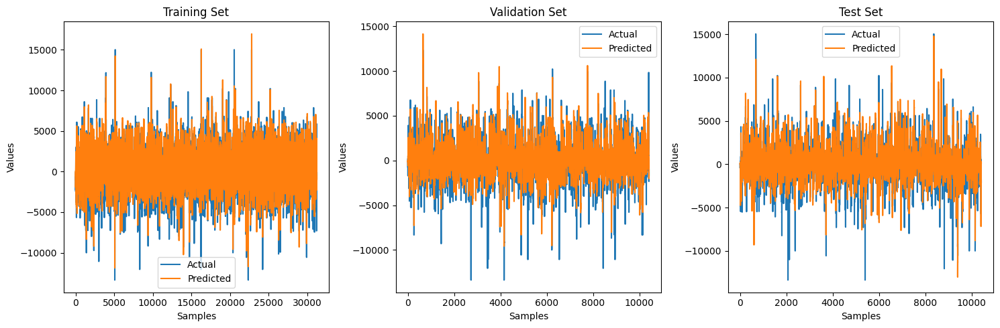

In [ ]:

# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history_multi_parallel_step.history['loss'], label='Train Loss')
plt.plot(history_multi_parallel_step.history['val_loss'], label='Validation Loss')
plt.title('Multiple Parallel Input Multi-step CNN Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()
# Predict values
y_train_pred = model_multi_parallel_step.predict(X_train)
y_val_pred = model_multi_parallel_step.predict(X_val)
y_test_pred = model_multi_parallel_step.predict(X_test)

# Reshape the predictions to match the shape of y
y_train_pred = y_train_pred.reshape(y_train.shape)
y_val_pred = y_val_pred.reshape(y_val.shape)
y_test_pred = y_test_pred.reshape(y_test.shape)

# Inverse transform the predictions and actual values to their original scale
y_train = scaler_y.inverse_transform(y_train.reshape(-1, 1)).reshape(y_train.shape)
y_train_pred = scaler_y.inverse_transform(y_train_pred.reshape(-1, 1)).reshape(y_train_pred.shape)
y_val = scaler_y.inverse_transform(y_val.reshape(-1, 1)).reshape(y_val.shape)
y_val_pred = scaler_y.inverse_transform(y_val_pred.reshape(-1, 1)).reshape(y_val_pred.shape)
y_test = scaler_y.inverse_transform(y_test.reshape(-1, 1)).reshape(y_test.shape)
y_test_pred = scaler_y.inverse_transform(y_test_pred.reshape(-1, 1)).reshape(y_test_pred.shape)

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y_train.flatten(), label='Actual')
plt.plot(y_train_pred.flatten(), label='Predicted')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y_val.flatten(), label='Actual')
plt.plot(y_val_pred.flatten(), label='Predicted')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y_test.flatten(), label='Actual')
plt.plot(y_test_pred.flatten(), label='Predicted')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
# Calculate metrics for the test predictions
def calculate_metrics(true_values, predicted_values):
    rmse = mean_squared_error(true_values, predicted_values, squared=False)
    mae = mean_absolute_error(true_values, predicted_values)
    mape = mean_absolute_percentage_error(true_values, predicted_values) * 100
    return rmse, mae, mape

test_metrics = calculate_metrics(y_test.flatten(), y_test_pred.flatten())

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([test_metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it doesn't exist
results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Multiple Parallel Input Multi-step CNN Model'] = metrics_df.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Multiple Parallel Input Multi-step CNN Model,1253.856698,856.769151,5.033151e+06


### 8.4.2 Multiple Parallel Input and Multi-step Output

In [ ]:
# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(hourly_data[['PowerConsumption_Zone1_diff', 'Temperature_diff']])

# Function to split a multivariate sequence into input/output samples
def split_sequences_multistep(sequences, n_steps_in, n_steps_out):
    X, y = [], []
    for i in range(len(sequences) - n_steps_in - n_steps_out + 1):
        end_ix = i + n_steps_in
        out_end_ix = end_ix + n_steps_out
        # Extract input and output parts of the pattern
        seq_x, seq_y = sequences[i:end_ix, :], sequences[end_ix:out_end_ix, :]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

# Choose a number of time steps for input and output
n_steps_in, n_steps_out = 24, 6  # Adjust as needed

# Split into samples
X, y = split_sequences_multistep(scaled_data, n_steps_in, n_steps_out)

# Split data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)   # 60% training, 40% temp
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)  # 20% validation, 20% test

# Print the shapes of the resulting arrays
print("Input shape:", X.shape)
print("Output shape:", y.shape)

Input shape: (8683, 24, 2)
Output shape: (8683, 6, 2)


In [ ]:
# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(hourly_data[['PowerConsumption_Zone1_diff', 'Temperature_diff']])

# Function to split a multivariate sequence into input/output samples
def split_sequences_multistep(sequences, n_steps_in, n_steps_out):
    X, y = [], []
    for i in range(len(sequences) - n_steps_in - n_steps_out + 1):
        end_ix = i + n_steps_in
        out_end_ix = end_ix + n_steps_out
        # Extract input and output parts of the pattern
        seq_x, seq_y = sequences[i:end_ix, :], sequences[end_ix:out_end_ix, :]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

# Choose a number of time steps for input and output
n_steps_in, n_steps_out = 24, 6  # Adjust as needed

# Split into samples
X, y = split_sequences_multistep(scaled_data, n_steps_in, n_steps_out)

# Split data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)   # 60% training, 40% temp
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)  # 20% validation, 20% test

# Print the shapes of the resulting arrays
print("Input shape:", X.shape)
print("Output shape:", y.shape)

Input shape: (8683, 24, 2)
Output shape: (8683, 6, 2)


In [ ]:
# Set the random seeds for reproducibility
seed = 42
np.random.seed(seed)
tf.random.set_seed(seed)
random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

# Define the multi-step CNN model
model_multi_parallel_step = Sequential()
model_multi_parallel_step.add(Conv1D(filters=64, kernel_size=2, activation='relu', input_shape=(n_steps_in, X_train.shape[2])))
model_multi_parallel_step.add(Flatten())
model_multi_parallel_step.add(Dense(100, activation='relu'))
model_multi_parallel_step.add(Dense(n_steps_out * X_train.shape[2]))
model_multi_parallel_step.compile(optimizer='adam', loss='mse')

# Fit the model
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history_multi_parallel_step = model_multi_parallel_step.fit(X_train, y_train.reshape((y_train.shape[0], -1)), epochs=1000, verbose=1, validation_data=(X_val, y_val.reshape((y_val.shape[0], -1))), callbacks=[early_stopping])


Epoch 1/1000
163/163 [==============================] - 7s 16ms/step - loss: 0.5511 - val_loss: 0.5084
Epoch 2/1000
163/163 [==============================] - 3s 17ms/step - loss: 0.4346 - val_loss: 0.4695
Epoch 3/1000
163/163 [==============================] - 3s 20ms/step - loss: 0.4113 - val_loss: 0.4527
Epoch 4/1000
163/163 [==============================] - 3s 16ms/step - loss: 0.4032 - val_loss: 0.4526
Epoch 5/1000
163/163 [==============================] - 2s 15ms/step - loss: 0.3870 - val_loss: 0.4372
Epoch 6/1000
163/163 [==============================] - 2s 14ms/step - loss: 0.3771 - val_loss: 0.4366
Epoch 7/1000
163/163 [==============================] - 2s 14ms/step - loss: 0.3735 - val_loss: 0.4414
Epoch 8/1000
163/163 [==============================] - 3s 19ms/step - loss: 0.3606 - val_loss: 0.4387
Epoch 9/1000
163/163 [==============================] - 3s 21ms/step - loss: 0.3543 - val_loss: 0.4314
Epoch 10/1000
163/163 [==============================] - 2s 15ms/step - l

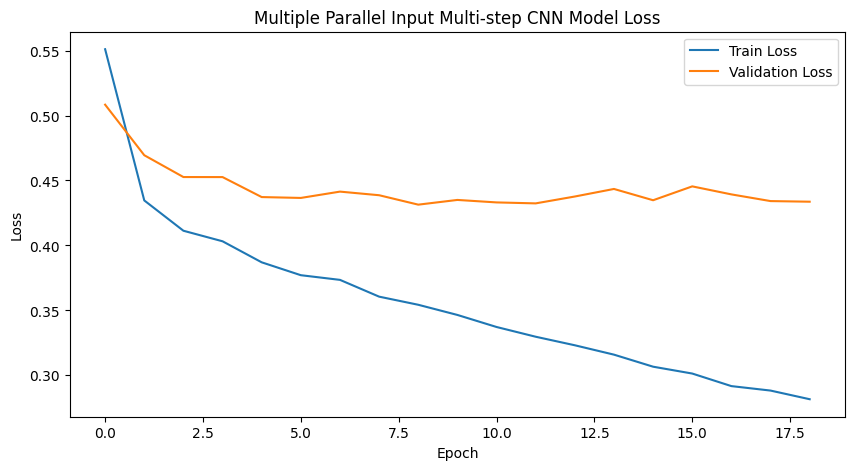

55/55 [==============================] - 0s 5ms/step


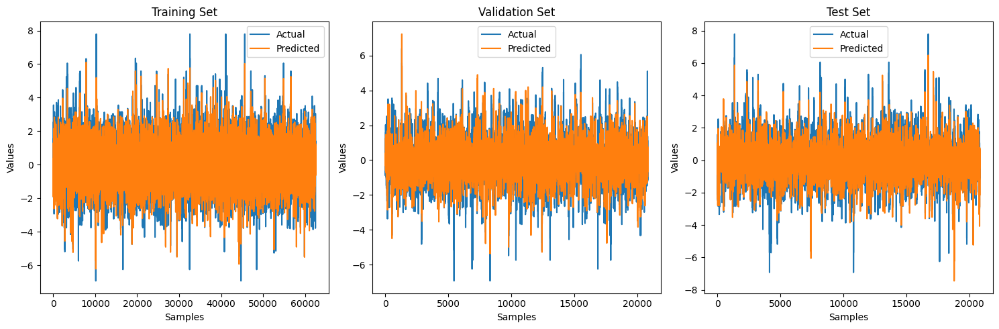

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(history_multi_parallel_step.history['loss'], label='Train Loss')
plt.plot(history_multi_parallel_step.history['val_loss'], label='Validation Loss')
plt.title('Multiple Parallel Input Multi-step CNN Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()

# Predict values
y_train_pred = model_multi_parallel_step.predict(X_train)
y_val_pred = model_multi_parallel_step.predict(X_val)
y_test_pred = model_multi_parallel_step.predict(X_test)

# Reshape the predictions to match the shape of y
y_train_pred = y_train_pred.reshape(y_train.shape)
y_val_pred = y_val_pred.reshape(y_val.shape)
y_test_pred = y_test_pred.reshape(y_test.shape)

# Plot predictions vs actual values
plt.figure(figsize=(15, 5))

# Training set
plt.subplot(1, 3, 1)
plt.plot(y_train.flatten(), label='Actual')
plt.plot(y_train_pred.flatten(), label='Predicted')
plt.title('Training Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Validation set
plt.subplot(1, 3, 2)
plt.plot(y_val.flatten(), label='Actual')
plt.plot(y_val_pred.flatten(), label='Predicted')
plt.title('Validation Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

# Test set
plt.subplot(1, 3, 3)
plt.plot(y_test.flatten(), label='Actual')
plt.plot(y_test_pred.flatten(), label='Predicted')
plt.title('Test Set')
plt.xlabel('Samples')
plt.ylabel('Values')
plt.legend()

plt.tight_layout()
plt.show()


In [ ]:
# Calculate metrics for the test predictions
def calculate_metrics(true_values, predicted_values):
    rmse = mean_squared_error(true_values, predicted_values, squared=False)
    mae = mean_absolute_error(true_values, predicted_values)
    mape = (abs((true_values - predicted_values) / true_values).mean()) * 100
    return rmse, mae, mape

test_metrics = calculate_metrics(y_test.flatten(), y_test_pred.flatten())

# Create a DataFrame to hold the calculated metrics
metrics_df = pd.DataFrame([test_metrics], columns=['RMSE', 'MAE', 'MAPE (%)'])

# Initialize the results DataFrame if it doesn't exist
results = pd.DataFrame(columns=['RMSE', 'MAE', 'MAPE (%)'])

# Add the calculated metrics as a row to the results DataFrame
results.loc['Multiple Parallel Input Multi-step CNN Model'] = metrics_df.values[0]

# Print the results DataFrame
results

,RMSE,MAE,MAPE (%)
Multiple Parallel Input Multi-step CNN Model,0.651181,0.458573,516.863341


# 9. Long Short-Term Memory Networks (LSTMs) Models

## 9.1 Univariate LSTM Models:

### **An Overview of the Differences**
Use cases and Model Types:
1. Vanilla LSTM
- The structure of vanilla is basic.
- Basic time series without intricate relationships are appropriate for it.
2. Stacked LSTM
- To capture intricate patterns, several layers are used.
- When the time series exhibits more complex temporal connections, it is helpful.
3. Bidirectional LSTM
- This model accepts input and processes it both ways.
- It catches patterns where previous and future states interact with one another.
4. CNN-LSTM
- This is an LSTM and CNN combination.
- Prior to processing sequences with LSTM, local features are extracted using CNN.
- For series with prominent local patterns, this works well.
5. ConvLSTM
- Convolution procedures are carried out by LSTM units.
- For spatiotemporal data with spatial dependencies, it is appropriate.


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, Bidirectional, Conv1D, MaxPooling1D, Flatten, RepeatVector, TimeDistributed, ConvLSTM2D
from tensorflow.keras.callbacks import EarlyStopping

# Load the data
data = pd.read_csv('powerconsumption.csv', parse_dates=['Datetime'], index_col='Datetime')

# Downsample the data to an hourly frequency
hourly_data = data.resample('H').mean()

# Compute seasonal differencing of 24 hours for 'PowerConsumption_Zone1' and 'Temperature' columns
hourly_data['PowerConsumption_Zone1_diff'] = hourly_data['PowerConsumption_Zone1'].diff(24)
hourly_data['Temperature_diff'] = hourly_data['Temperature'].diff(24)

# Drop NA values
hourly_data = hourly_data.dropna()

# Normalize the data
scaler = MinMaxScaler(feature_range=(0, 1))
scaled_data = scaler.fit_transform(hourly_data[['PowerConsumption_Zone1_diff', 'Temperature_diff']])

# Prepare the data for LSTM
def create_dataset(data, time_steps=144):
    X, y = [], []
    for i in range(time_steps, len(data)):
        X.append(data[i-time_steps:i, :])
        y.append(data[i, 0])  # Predicting PowerConsumption_Zone1_diff
    return np.array(X), np.array(y)

time_steps = 144
X, y = create_dataset(scaled_data, time_steps)

# Reshape X for LSTM [samples, time_steps, features]
X = X.reshape(X.shape[0], X.shape[1], X.shape[2])

# Split into training and testing sets
split = int(0.8 * len(X))
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]


### 9.1.1 Vanilla LSTM

In [ ]:
# Vanilla LSTM Model
model_vanilla = Sequential()
model_vanilla.add(LSTM(units=50, return_sequences=False, input_shape=(time_steps, X_train.shape[2])))
model_vanilla.add(Dense(1))

model_vanilla.compile(optimizer='adam', loss='mean_squared_error')
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history_vanilla = model_vanilla.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test), callbacks=[early_stopping], verbose=1)

# Make predictions using the trained model
predictions_vanilla = model_vanilla.predict(X_test)
predictions_vanilla = scaler.inverse_transform(np.hstack((predictions_vanilla, np.zeros((predictions_vanilla.shape[0], 1)))))[:, 0]


Epoch 1/100
215/215 [==============================] - 33s 132ms/step - loss: 0.0118 - val_loss: 0.0018
Epoch 2/100
215/215 [==============================] - 18s 84ms/step - loss: 0.0029 - val_loss: 0.0013
Epoch 3/100
215/215 [==============================] - 26s 119ms/step - loss: 0.0023 - val_loss: 0.0012
Epoch 4/100
215/215 [==============================] - 33s 155ms/step - loss: 0.0019 - val_loss: 9.2481e-04
Epoch 5/100
215/215 [==============================] - 28s 128ms/step - loss: 0.0016 - val_loss: 8.7936e-04
Epoch 6/100
215/215 [==============================] - 34s 160ms/step - loss: 0.0014 - val_loss: 6.9196e-04
Epoch 7/100
215/215 [==============================] - 32s 148ms/step - loss: 0.0012 - val_loss: 6.6215e-04
Epoch 8/100
215/215 [==============================] - 36s 168ms/step - loss: 0.0011 - val_loss: 5.7991e-04
Epoch 9/100
215/215 [==============================] - 35s 161ms/step - loss: 0.0010 - val_loss: 5.7833e-04
Epoch 10/100
215/215 [===================

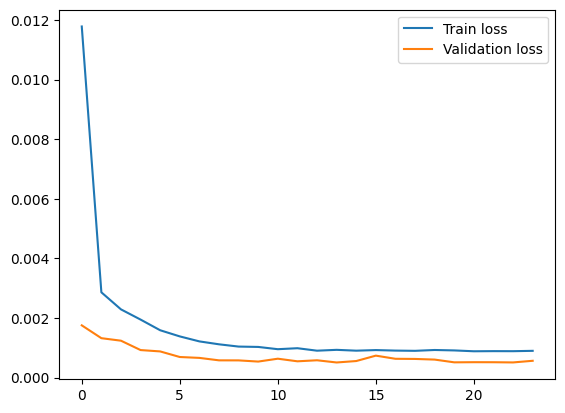

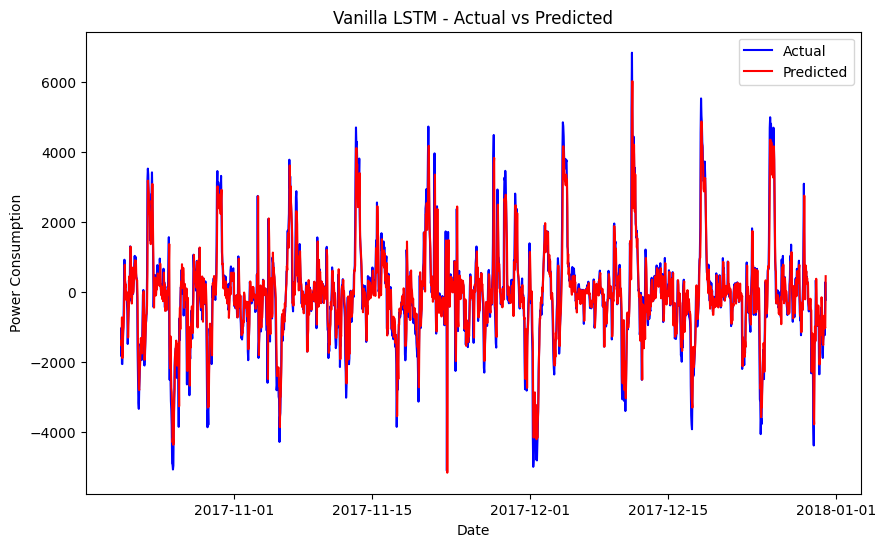

In [ ]:
# Plot training & validation loss
plt.plot(history_vanilla.history['loss'], label='Train loss')
plt.plot(history_vanilla.history['val_loss'], label='Validation loss')
plt.legend()
plt.show()

# Plot actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(hourly_data.index[-len(y_test):], scaler.inverse_transform(np.hstack((y_test.reshape(-1, 1), np.zeros((y_test.shape[0], 1)))))[:, 0], color='blue', label='Actual')
plt.plot(hourly_data.index[-len(y_test):], predictions_vanilla, color='red', label='Predicted')
plt.title('Vanilla LSTM - Actual vs Predicted')
plt.xlabel('Date')
plt.ylabel('Power Consumption')
plt.legend()
plt.show()

### 9.1.2 Stacked LSTM Model

In [ ]:
# Stacked LSTM Model
model_stacked = Sequential()
model_stacked.add(LSTM(units=50, return_sequences=True, input_shape=(time_steps, X_train.shape[2])))
model_stacked.add(LSTM(units=50, return_sequences=False))
model_stacked.add(Dense(1))

model_stacked.compile(optimizer='adam', loss='mean_squared_error')
history_stacked = model_stacked.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test), callbacks=[early_stopping], verbose=1)

# Make predictions using the trained model
predictions_stacked = model_stacked.predict(X_test)
predictions_stacked = scaler.inverse_transform(np.hstack((predictions_stacked, np.zeros((predictions_stacked.shape[0], 1)))))[:, 0]


Epoch 1/100
215/215 [==============================] - 69s 275ms/step - loss: 0.0053 - val_loss: 0.0017
Epoch 2/100
215/215 [==============================] - 69s 321ms/step - loss: 0.0025 - val_loss: 0.0012
Epoch 3/100
215/215 [==============================] - 50s 231ms/step - loss: 0.0021 - val_loss: 0.0011
Epoch 4/100
215/215 [==============================] - 38s 176ms/step - loss: 0.0018 - val_loss: 7.6324e-04
Epoch 5/100
215/215 [==============================] - 37s 174ms/step - loss: 0.0012 - val_loss: 5.9443e-04
Epoch 6/100
215/215 [==============================] - 39s 182ms/step - loss: 0.0011 - val_loss: 5.3688e-04
Epoch 7/100
215/215 [==============================] - 43s 198ms/step - loss: 9.6829e-04 - val_loss: 6.2351e-04
Epoch 8/100
215/215 [==============================] - 36s 168ms/step - loss: 9.4739e-04 - val_loss: 5.2050e-04
Epoch 9/100
215/215 [==============================] - 38s 178ms/step - loss: 9.1674e-04 - val_loss: 5.3341e-04
Epoch 10/100
215/215 [======

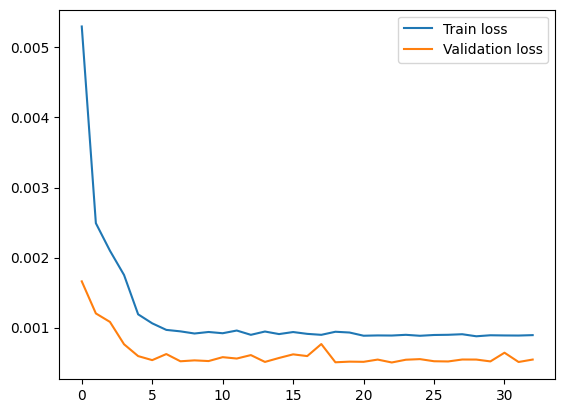

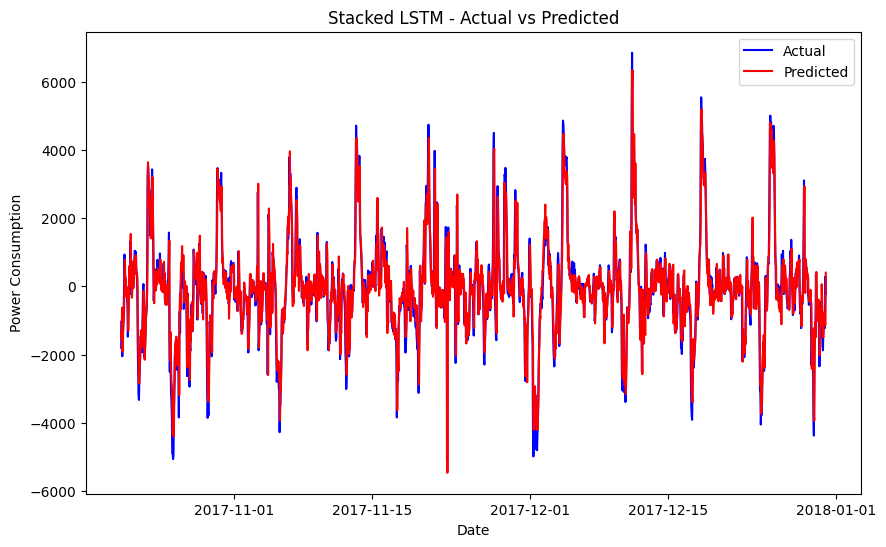

In [ ]:
# Plot training & validation loss
plt.plot(history_stacked.history['loss'], label='Train loss')
plt.plot(history_stacked.history['val_loss'], label='Validation loss')
plt.legend()
plt.show()

# Plot actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(hourly_data.index[-len(y_test):], scaler.inverse_transform(np.hstack((y_test.reshape(-1, 1), np.zeros((y_test.shape[0], 1)))))[:, 0], color='blue', label='Actual')
plt.plot(hourly_data.index[-len(y_test):], predictions_stacked, color='red', label='Predicted')
plt.title('Stacked LSTM - Actual vs Predicted')
plt.xlabel('Date')
plt.ylabel('Power Consumption')
plt.legend()
plt.show()

### 9.1.3 Bidirectional LSTM Model

In [ ]:
# Bidirectional LSTM Model
model_bidirectional = Sequential()
model_bidirectional.add(Bidirectional(LSTM(units=50, return_sequences=False), input_shape=(time_steps, X_train.shape[2])))
model_bidirectional.add(Dense(1))

model_bidirectional.compile(optimizer='adam', loss='mean_squared_error')
history_bidirectional = model_bidirectional.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test), callbacks=[early_stopping], verbose=1)

# Make predictions using the trained model
predictions_bidirectional = model_bidirectional.predict(X_test)
predictions_bidirectional = scaler.inverse_transform(np.hstack((predictions_bidirectional, np.zeros((predictions_bidirectional.shape[0], 1)))))[:, 0]


Epoch 1/100
215/215 [==============================] - 39s 149ms/step - loss: 0.0061 - val_loss: 0.0015
Epoch 2/100
215/215 [==============================] - 29s 137ms/step - loss: 0.0024 - val_loss: 0.0011
Epoch 3/100
215/215 [==============================] - 29s 136ms/step - loss: 0.0020 - val_loss: 9.8074e-04
Epoch 4/100
215/215 [==============================] - 32s 148ms/step - loss: 0.0016 - val_loss: 7.9097e-04
Epoch 5/100
215/215 [==============================] - 29s 137ms/step - loss: 0.0013 - val_loss: 7.5531e-04
Epoch 6/100
215/215 [==============================] - 30s 140ms/step - loss: 0.0012 - val_loss: 6.3160e-04
Epoch 7/100
215/215 [==============================] - 32s 148ms/step - loss: 0.0011 - val_loss: 6.0828e-04
Epoch 8/100
215/215 [==============================] - 29s 133ms/step - loss: 0.0010 - val_loss: 5.6870e-04
Epoch 9/100
215/215 [==============================] - 29s 134ms/step - loss: 9.8742e-04 - val_loss: 5.5386e-04
Epoch 10/100
215/215 [==========

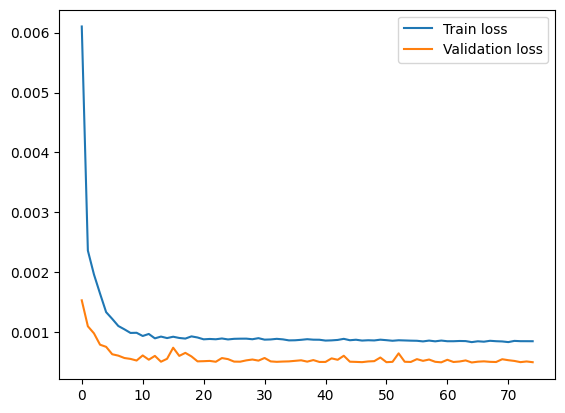

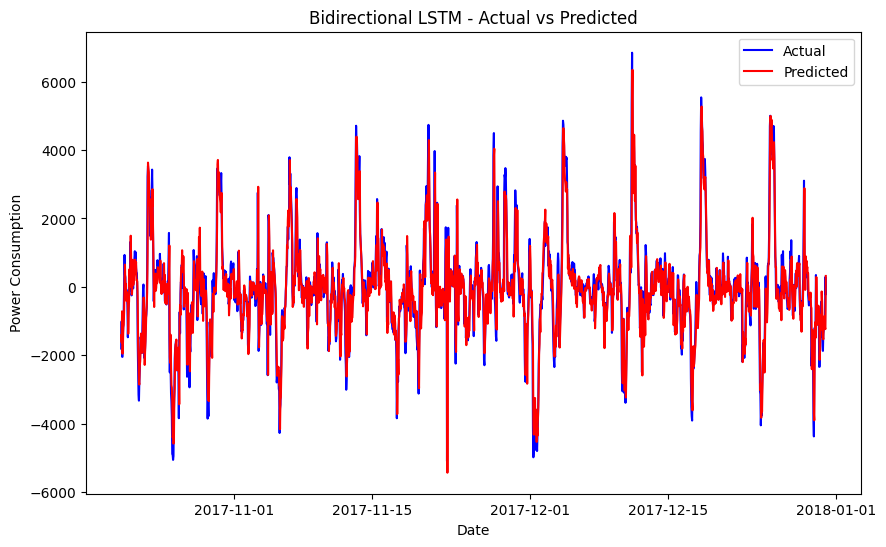

In [ ]:
# Plot training & validation loss
plt.plot(history_bidirectional.history['loss'], label='Train loss')
plt.plot(history_bidirectional.history['val_loss'], label='Validation loss')
plt.legend()
plt.show()

# Plot actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(hourly_data.index[-len(y_test):], scaler.inverse_transform(np.hstack((y_test.reshape(-1, 1), np.zeros((y_test.shape[0], 1)))))[:, 0], color='blue', label='Actual')
plt.plot(hourly_data.index[-len(y_test):], predictions_bidirectional, color='red', label='Predicted')
plt.title('Bidirectional LSTM - Actual vs Predicted')
plt.xlabel('Date')
plt.ylabel('Power Consumption')
plt.legend()
plt.show()

### 9.1.4 CNN-LSTM Model

In [ ]:
# CNN-LSTM Model
model_cnn_lstm = Sequential()
model_cnn_lstm.add(Conv1D(filters=64, kernel_size=2, activation='relu', input_shape=(time_steps, X_train.shape[2])))
model_cnn_lstm.add(MaxPooling1D(pool_size=2))
model_cnn_lstm.add(Flatten())
model_cnn_lstm.add(RepeatVector(time_steps))
model_cnn_lstm.add(LSTM(50, return_sequences=False))
model_cnn_lstm.add(Dense(1))

model_cnn_lstm.compile(optimizer='adam', loss='mean_squared_error')
history_cnn_lstm = model_cnn_lstm.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test), callbacks=[early_stopping], verbose=1)

# Make predictions using the trained model
predictions_cnn_lstm = model_cnn_lstm.predict(X_test)
predictions_cnn_lstm = scaler.inverse_transform(np.hstack((predictions_cnn_lstm, np.zeros((predictions_cnn_lstm.shape[0], 1)))))[:, 0]


In [ ]:
# Plot training & validation loss
plt.plot(history_cnn_lstm.history['loss'], label='Train loss')
plt.plot(history_cnn_lstm.history['val_loss'], label='Validation loss')
plt.legend()
plt.show()

# Plot actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(hourly_data.index[-len(y_test):], scaler.inverse_transform(np.hstack((y_test.reshape(-1, 1), np.zeros((y_test.shape[0], 1)))))[:, 0], color='blue', label='Actual')
plt.plot(hourly_data.index[-len(y_test):], predictions_cnn_lstm, color='red', label='Predicted')
plt.title('CNN-LSTM - Actual vs Predicted')
plt.xlabel('Date')
plt.ylabel('Power Consumption')
plt.legend()
plt.show()

### 9.1.5 ConvLSTM Model

In [ ]:
# Function to create 4D dataset for ConvLSTM
def create_4d_dataset(data, time_steps=144):
    X, y = [], []
    for i in range(time_steps, len(data)):
        X.append(data[i-time_steps:i, :].reshape((time_steps, 1, data.shape[1], 1)))
        y.append(data[i, 0])
    return np.array(X), np.array(y)

time_steps = 144
X_4d, y_4d = create_4d_dataset(scaled_data, time_steps)

# Split into training and testing sets
split = int(0.8 * len(X_4d))
X_train_4d, X_test_4d = X_4d[:split], X_4d[split:]
y_train_4d, y_test_4d = y_4d[:split], y_4d[split:]

# ConvLSTM Model
model_convlstm = Sequential()
model_convlstm.add(ConvLSTM2D(filters=64, kernel_size=(1, 2), activation='relu', input_shape=(time_steps, 1, 2, 1)))
model_convlstm.add(Flatten())
model_convlstm.add(Dense(1))

model_convlstm.compile(optimizer='adam', loss='mean_squared_error')

# Early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model
history_convlstm = model_convlstm.fit(X_train_4d, y_train_4d, epochs=100, batch_size=32, validation_data=(X_test_4d, y_test_4d), callbacks=[early_stopping], verbose=1)

# Make predictions using the trained model
predictions_convlstm = model_convlstm.predict(X_test_4d)
predictions_convlstm = scaler.inverse_transform(np.hstack((predictions_convlstm, np.zeros((predictions_convlstm.shape[0], 1)))))[:, 0]


Epoch 1/100
215/215 [==============================] - 95s 413ms/step - loss: 0.0130 - val_loss: 0.0015
Epoch 2/100
215/215 [==============================] - 59s 273ms/step - loss: 0.0024 - val_loss: 0.0011
Epoch 3/100
215/215 [==============================] - 57s 268ms/step - loss: 0.0019 - val_loss: 0.0010
Epoch 4/100
215/215 [==============================] - 58s 271ms/step - loss: 0.0017 - val_loss: 7.9756e-04
Epoch 5/100
215/215 [==============================] - 58s 272ms/step - loss: 0.0014 - val_loss: 7.1285e-04
Epoch 6/100
215/215 [==============================] - 57s 265ms/step - loss: 0.0012 - val_loss: 6.6949e-04
Epoch 7/100
215/215 [==============================] - 53s 249ms/step - loss: 0.0011 - val_loss: 7.3099e-04
Epoch 8/100
215/215 [==============================] - 61s 285ms/step - loss: 0.0011 - val_loss: 5.7264e-04
Epoch 9/100
215/215 [==============================] - 58s 268ms/step - loss: 0.0010 - val_loss: 5.8496e-04
Epoch 10/100
215/215 [==================

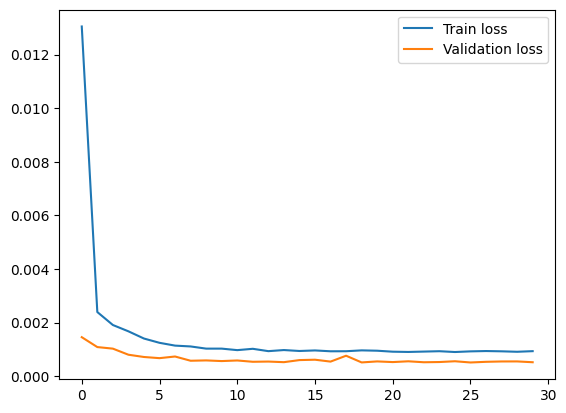

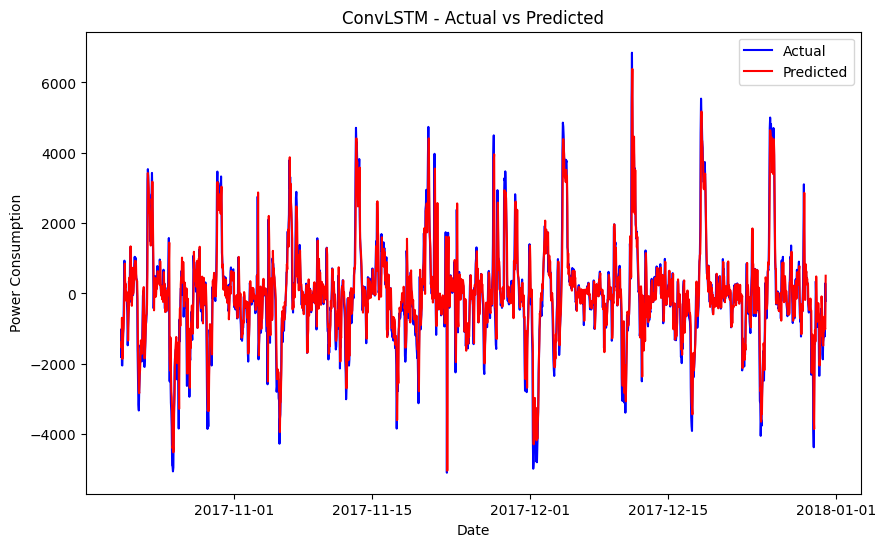

In [ ]:

# Plot training & validation loss
plt.plot(history_convlstm.history['loss'], label='Train loss')
plt.plot(history_convlstm.history['val_loss'], label='Validation loss')
plt.legend()
plt.show()

# Plot actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(hourly_data.index[-len(y_test_4d):], scaler.inverse_transform(np.hstack((y_test_4d.reshape(-1, 1), np.zeros((y_test_4d.shape[0], 1)))))[:, 0], color='blue', label='Actual')
plt.plot(hourly_data.index[-len(y_test_4d):], predictions_convlstm, color='red', label='Predicted')
plt.title('ConvLSTM - Actual vs Predicted')
plt.xlabel('Date')
plt.ylabel('Power Consumption')
plt.legend()
plt.show()

## 9.2 Multivariate LSTM Models

### 9.2.1 Multiple Input Series

In [ ]:
# Separate input series
X1 = X[:, :, 0]  # PowerConsumption_Zone1_diff
X2 = X[:, :, 1]  # Temperature_diff

# Split data into training and testing sets for each input series
X1_train, X1_test, X2_train, X2_test = X1[:split], X1[split:], X2[:split], X2[split:]

# Define model
input1 = Input(shape=(time_steps,))
input2 = Input(shape=(time_steps,))
dense1 = Dense(100, activation='relu')(input1)
dense2 = Dense(100, activation='relu')(input2)
merged = concatenate([dense1, dense2])
output = Dense(1)(merged)

model_multi_input = Model(inputs=[input1, input2], outputs=output)
model_multi_input.compile(optimizer='adam', loss='mean_squared_error')

# Early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model
history_multi_input = model_multi_input.fit([X1_train, X2_train], y_train, epochs=100, batch_size=32, validation_data=([X1_test, X2_test], y_test), callbacks=[early_stopping], verbose=1)

# Predict values
predictions_multi_input = model_multi_input.predict([X1_test, X2_test])
predictions_multi_input = scaler.inverse_transform(np.hstack((predictions_multi_input, np.zeros((predictions_multi_input.shape[0], 1)))))[:, 0]


Epoch 1/100
215/215 [==============================] - 2s 6ms/step - loss: 0.0134 - val_loss: 0.0043
Epoch 2/100
215/215 [==============================] - 1s 5ms/step - loss: 0.0040 - val_loss: 0.0021
Epoch 3/100
215/215 [==============================] - 1s 7ms/step - loss: 0.0028 - val_loss: 0.0020
Epoch 4/100
215/215 [==============================] - 2s 7ms/step - loss: 0.0024 - val_loss: 0.0013
Epoch 5/100
215/215 [==============================] - 1s 6ms/step - loss: 0.0022 - val_loss: 0.0036
Epoch 6/100
215/215 [==============================] - 1s 4ms/step - loss: 0.0019 - val_loss: 0.0015
Epoch 7/100
215/215 [==============================] - 1s 5ms/step - loss: 0.0017 - val_loss: 0.0017
Epoch 8/100
215/215 [==============================] - 1s 5ms/step - loss: 0.0018 - val_loss: 0.0020
Epoch 9/100
215/215 [==============================] - 1s 4ms/step - loss: 0.0016 - val_loss: 8.7506e-04
Epoch 10/100
215/215 [==============================] - 1s 5ms/step - loss: 0.0016 - va

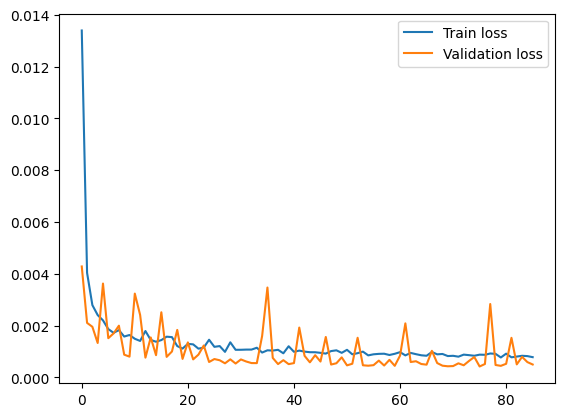

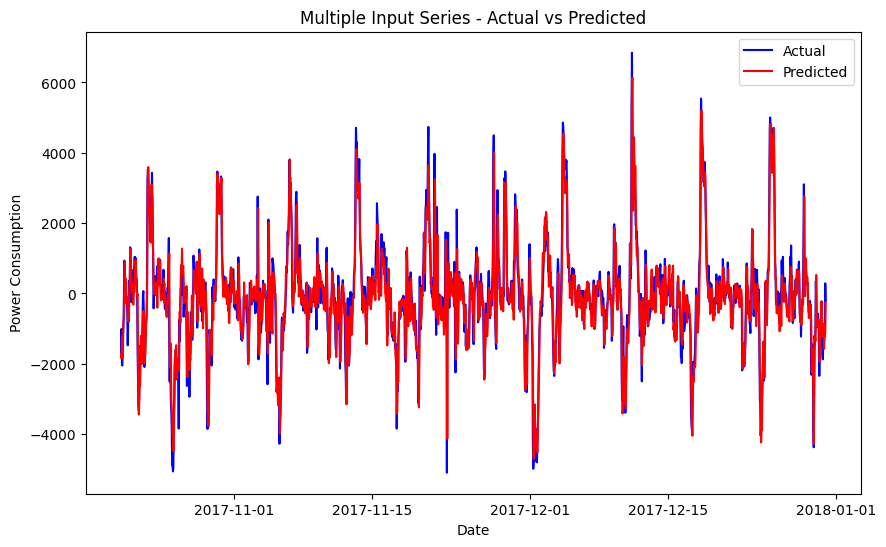

In [ ]:
# Plot training & validation loss
plt.plot(history_multi_input.history['loss'], label='Train loss')
plt.plot(history_multi_input.history['val_loss'], label='Validation loss')
plt.legend()
plt.show()

# Plot actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(hourly_data.index[-len(y_test):], scaler.inverse_transform(np.hstack((y_test.reshape(-1, 1), np.zeros((y_test.shape[0], 1)))))[:, 0], color='blue', label='Actual')
plt.plot(hourly_data.index[-len(y_test):], predictions_multi_input, color='red', label='Predicted')
plt.title('Multiple Input Series - Actual vs Predicted')
plt.xlabel('Date')
plt.ylabel('Power Consumption')
plt.legend()
plt.show()

### 9.2.2 Multiple Parallel Series

In [ ]:
# Define model
input1 = Input(shape=(time_steps, 1))
input2 = Input(shape=(time_steps, 1))
lstm1 = LSTM(50, activation='relu')(input1)
lstm2 = LSTM(50, activation='relu')(input2)
merged = concatenate([lstm1, lstm2])
output = Dense(1)(merged)

model_multi_parallel = Model(inputs=[input1, input2], outputs=output)
model_multi_parallel.compile(optimizer='adam', loss='mean_squared_error')

# Early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model
history_multi_parallel = model_multi_parallel.fit([X1_train.reshape(-1, time_steps, 1), X2_train.reshape(-1, time_steps, 1)], y_train, epochs=100, batch_size=32, validation_data=([X1_test.reshape(-1, time_steps, 1), X2_test.reshape(-1, time_steps, 1)], y_test), callbacks=[early_stopping], verbose=1)

# Predict values
predictions_multi_parallel = model_multi_parallel.predict([X1_test.reshape(-1, time_steps, 1), X2_test.reshape(-1, time_steps, 1)])
predictions_multi_parallel = scaler.inverse_transform(np.hstack((predictions_multi_parallel, np.zeros((predictions_multi_parallel.shape[0], 1)))))[:, 0]


Epoch 1/100
215/215 [==============================] - 35s 144ms/step - loss: 0.0235 - val_loss: 0.0017
Epoch 2/100
215/215 [==============================] - 29s 133ms/step - loss: 0.0025 - val_loss: 0.0012
Epoch 3/100
215/215 [==============================] - 30s 140ms/step - loss: 0.0022 - val_loss: 0.0011
Epoch 4/100
215/215 [==============================] - 29s 133ms/step - loss: 0.0019 - val_loss: 9.3533e-04
Epoch 5/100
215/215 [==============================] - 28s 129ms/step - loss: 0.0084 - val_loss: 0.0019
Epoch 6/100
215/215 [==============================] - 31s 142ms/step - loss: 0.0024 - val_loss: 0.0011
Epoch 7/100
215/215 [==============================] - 30s 139ms/step - loss: 0.0020 - val_loss: 0.0010
Epoch 8/100
215/215 [==============================] - 28s 132ms/step - loss: 0.0018 - val_loss: 8.6435e-04
Epoch 9/100
215/215 [==============================] - 30s 140ms/step - loss: 0.0016 - val_loss: 8.3490e-04
Epoch 10/100
215/215 [==============================

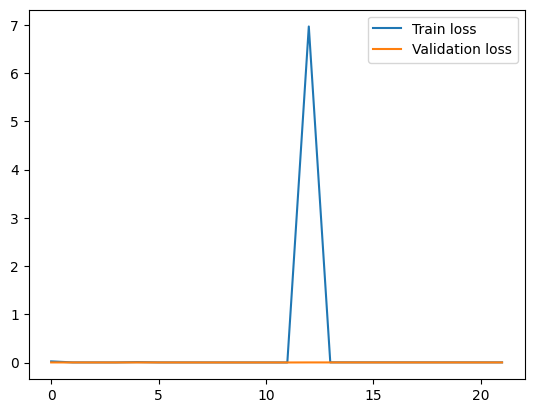

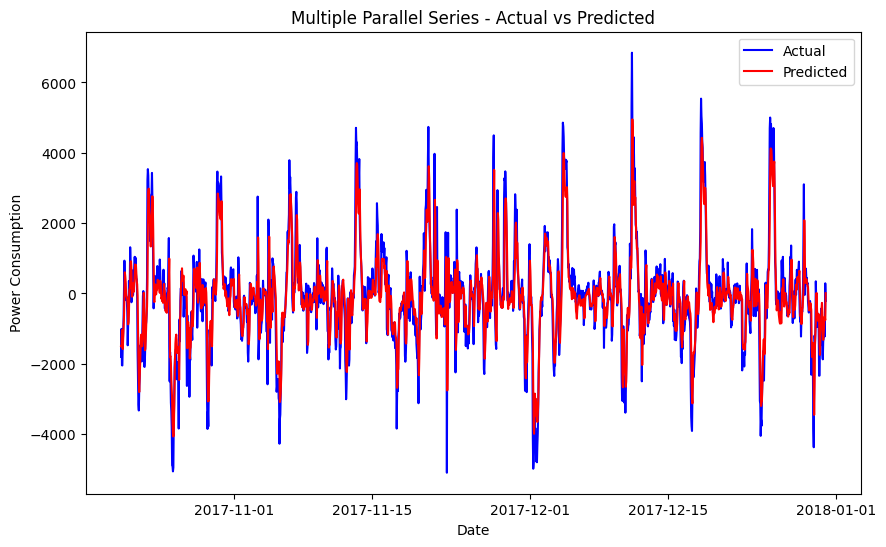

In [ ]:
# Plot training & validation loss
plt.plot(history_multi_parallel.history['loss'], label='Train loss')
plt.plot(history_multi_parallel.history['val_loss'], label='Validation loss')
plt.legend()
plt.show()

# Plot actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(hourly_data.index[-len(y_test):], scaler.inverse_transform(np.hstack((y_test.reshape(-1, 1), np.zeros((y_test.shape[0], 1)))))[:, 0], color='blue', label='Actual')
plt.plot(hourly_data.index[-len(y_test):], predictions_multi_parallel, color='red', label='Predicted')
plt.title('Multiple Parallel Series - Actual vs Predicted')
plt.xlabel('Date')
plt.ylabel('Power Consumption')
plt.legend()
plt.show()

## 9.3 Multi-step LSTM Models

### 9.3.1 Vector Output Model

In [ ]:
# Function to split a sequence into samples for multi-step forecasting
def create_multistep_dataset(data, time_steps_in=24, time_steps_out=6):
    X, y = [], []
    for i in range(len(data) - time_steps_in - time_steps_out + 1):
        X.append(data[i:i + time_steps_in, :])
        y.append(data[i + time_steps_in:i + time_steps_in + time_steps_out, 0])
    return np.array(X), np.array(y)

time_steps_in = 24
time_steps_out = 6

# Split data
X, y = create_multistep_dataset(data_scaled, time_steps_in, time_steps_out)
split = int(0.8 * len(X))
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]

# Define model
model_vector_output = Sequential()
model_vector_output.add(LSTM(50, activation='relu', input_shape=(time_steps_in, X_train.shape[2])))
model_vector_output.add(Dense(time_steps_out))
model_vector_output.compile(optimizer='adam', loss='mean_squared_error')

# Early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model
history_vector_output = model_vector_output.fit(
    X_train, y_train,
    epochs=100, batch_size=32,
    validation_data=(X_test, y_test),
    callbacks=[early_stopping], verbose=1
)

# Predict values
predictions_vector_output = model_vector_output.predict(X_test)

# Prepare the inverse transformation
n_features = data_scaled.shape[1]
predictions_vector_output_reshaped = predictions_vector_output.reshape(predictions_vector_output.shape[0] * time_steps_out, 1)
predictions_vector_output_scaled = np.hstack((predictions_vector_output_reshaped, np.zeros((predictions_vector_output_reshaped.shape[0], n_features - 1))))

# Inverse transform the predictions
predictions_vector_output_inversed = scaler.inverse_transform(predictions_vector_output_scaled)[:, 0]

# Reshape the test values for inverse transformation
y_test_reshaped = y_test.reshape(y_test.shape[0] * y_test.shape[1], 1)
y_test_scaled = np.hstack((y_test_reshaped, np.zeros((y_test_reshaped.shape[0], n_features - 1))))

# Inverse transform the actual values
y_test_inversed = scaler.inverse_transform(y_test_scaled)[:, 0]


Epoch 1/100
218/218 [==============================] - 16s 57ms/step - loss: 0.0351 - val_loss: 0.0110
Epoch 2/100
218/218 [==============================] - 9s 40ms/step - loss: 0.0142 - val_loss: 0.0100
Epoch 3/100
218/218 [==============================] - 11s 52ms/step - loss: 0.0130 - val_loss: 0.0095
Epoch 4/100
218/218 [==============================] - 10s 44ms/step - loss: 0.0125 - val_loss: 0.0094
Epoch 5/100
218/218 [==============================] - 9s 42ms/step - loss: 0.0122 - val_loss: 0.0093
Epoch 6/100
218/218 [==============================] - 8s 38ms/step - loss: 0.0120 - val_loss: 0.0089
Epoch 7/100
218/218 [==============================] - 7s 32ms/step - loss: 0.0114 - val_loss: 0.0084
Epoch 8/100
218/218 [==============================] - 10s 44ms/step - loss: 0.0096 - val_loss: 0.0071
Epoch 9/100
218/218 [==============================] - 8s 36ms/step - loss: 0.0078 - val_loss: 0.0064
Epoch 10/100
218/218 [==============================] - 8s 38ms/step - loss: 0

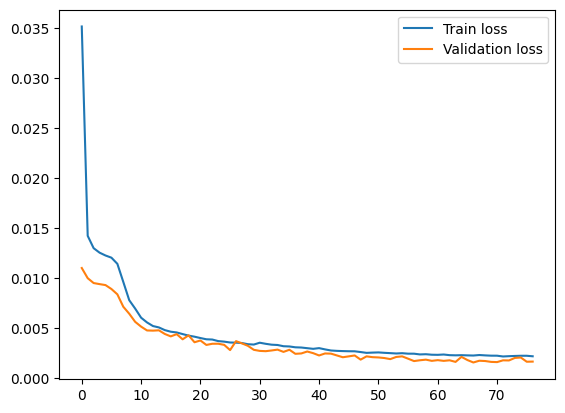

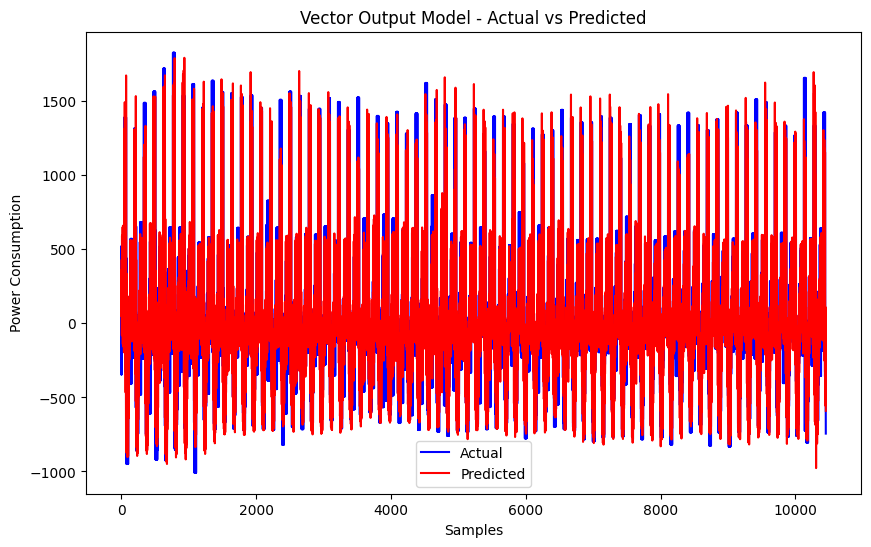

In [ ]:
# Plot training & validation loss
plt.plot(history_vector_output.history['loss'], label='Train loss')
plt.plot(history_vector_output.history['val_loss'], label='Validation loss')
plt.legend()
plt.show()

# Plot actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(y_test_inversed, color='blue', label='Actual')
plt.plot(predictions_vector_output_inversed, color='red', label='Predicted')
plt.title('Vector Output Model - Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Power Consumption')
plt.legend()
plt.show()

### 9.3.2 Encoder-Decoder Model

In [ ]:
# Function to split a sequence into samples for multi-step forecasting
def create_multistep_dataset(data, time_steps_in=144, time_steps_out=6):
    X, y = [], []
    for i in range(len(data) - time_steps_in - time_steps_out + 1):
        X.append(data[i:i + time_steps_in, :])
        y.append(data[i + time_steps_in:i + time_steps_in + time_steps_out, 0])
    return np.array(X), np.array(y)

time_steps_in = 24
time_steps_out = 6

# Split data
X, y = create_multistep_dataset(data_scaled, time_steps_in, time_steps_out)
split = int(0.8 * len(X))
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]

# Define the Encoder-Decoder LSTM model
model_encoder_decoder = Sequential()
model_encoder_decoder.add(LSTM(50, activation='relu', input_shape=(time_steps_in, X_train.shape[2])))
model_encoder_decoder.add(RepeatVector(time_steps_out))
model_encoder_decoder.add(LSTM(50, activation='relu', return_sequences=True))
model_encoder_decoder.add(TimeDistributed(Dense(1)))
model_encoder_decoder.compile(optimizer='adam', loss='mean_squared_error')

# Early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model
history_encoder_decoder = model_encoder_decoder.fit(
    X_train, y_train.reshape(y_train.shape[0], y_train.shape[1], 1),
    epochs=100, batch_size=32,
    validation_data=(X_test, y_test.reshape(y_test.shape[0], y_test.shape[1], 1)),
    callbacks=[early_stopping], verbose=1
)

# Predict values
predictions_encoder_decoder = model_encoder_decoder.predict(X_test)
predictions_encoder_decoder = predictions_encoder_decoder.reshape(predictions_encoder_decoder.shape[0] * predictions_encoder_decoder.shape[1], 1)

# Prepare the inverse transformation
n_features = data_scaled.shape[1]
predictions_encoder_decoder_scaled = np.hstack((predictions_encoder_decoder, np.zeros((predictions_encoder_decoder.shape[0], n_features - 1))))

# Inverse transform the predictions
predictions_encoder_decoder_inversed = scaler.inverse_transform(predictions_encoder_decoder_scaled)[:, 0]

# Reshape the test values for inverse transformation
y_test_reshaped = y_test.reshape(y_test.shape[0] * y_test.shape[1], 1)
y_test_scaled = np.hstack((y_test_reshaped, np.zeros((y_test_reshaped.shape[0], n_features - 1))))

# Inverse transform the actual values
y_test_inversed = scaler.inverse_transform(y_test_scaled)[:, 0]


Epoch 1/100
218/218 [==============================] - 11s 36ms/step - loss: 0.0481 - val_loss: 0.0126
Epoch 2/100
218/218 [==============================] - 5s 21ms/step - loss: 0.0139 - val_loss: 0.0155
Epoch 3/100
218/218 [==============================] - 5s 23ms/step - loss: 0.0132 - val_loss: 0.0089
Epoch 4/100
218/218 [==============================] - 8s 35ms/step - loss: 0.0115 - val_loss: 0.0088
Epoch 5/100
218/218 [==============================] - 6s 26ms/step - loss: 0.0108 - val_loss: 0.0087
Epoch 6/100
218/218 [==============================] - 7s 31ms/step - loss: 0.0103 - val_loss: 0.0082
Epoch 7/100
218/218 [==============================] - 5s 23ms/step - loss: 0.0098 - val_loss: 0.0080
Epoch 8/100
218/218 [==============================] - 5s 25ms/step - loss: 0.0094 - val_loss: 0.0079
Epoch 9/100
218/218 [==============================] - 6s 28ms/step - loss: 0.0087 - val_loss: 0.0070
Epoch 10/100
218/218 [==============================] - 5s 24ms/step - loss: 0.00

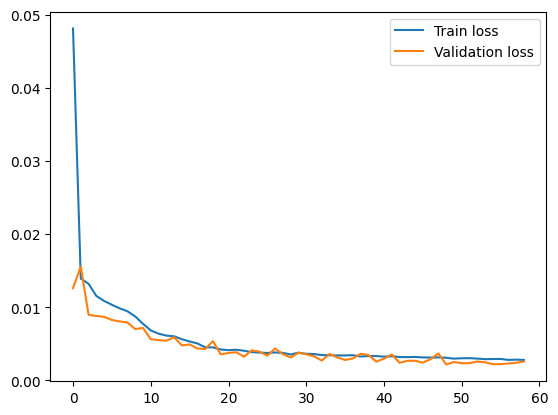

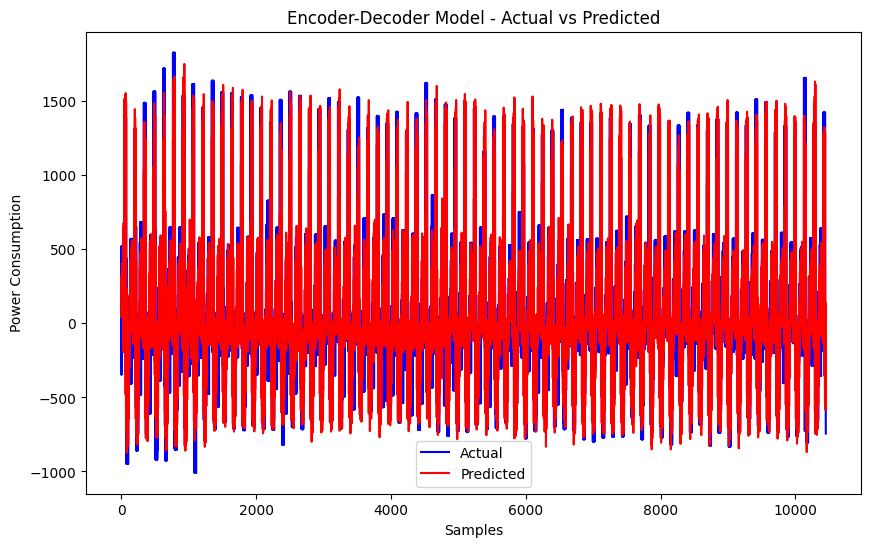

In [ ]:

# Plot training & validation loss
plt.plot(history_encoder_decoder.history['loss'], label='Train loss')
plt.plot(history_encoder_decoder.history['val_loss'], label='Validation loss')
plt.legend()
plt.show()

# Plot actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(y_test_inversed, color='blue', label='Actual')
plt.plot(predictions_encoder_decoder_inversed, color='red', label='Predicted')
plt.title('Encoder-Decoder Model - Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Power Consumption')
plt.legend()
plt.show()

## 9.4 Multivariate Multi-step LSTM Models

### 9.4.1 Multiple Input Multi-step Output Model

In [ ]:
# Function to split a sequence into samples for multi-step forecasting
def create_multistep_dataset(data, time_steps_in=144, time_steps_out=6):
    X, y = [], []
    for i in range(len(data) - time_steps_in - time_steps_out + 1):
        X.append(data[i:i + time_steps_in, :])
        y.append(data[i + time_steps_in:i + time_steps_in + time_steps_out, 0])
    return np.array(X), np.array(y)

time_steps_in = 24
time_steps_out = 6

# Split data
X, y = create_multistep_dataset(data_scaled, time_steps_in, time_steps_out)
split = int(0.8 * len(X))
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]

# Separate input series
X1_train, X2_train = X_train[:, :, 0], X_train[:, :, 1]
X1_test, X2_test = X_test[:, :, 0], X_test[:, :, 1]

# Define model
input1 = Input(shape=(time_steps_in,))
input2 = Input(shape=(time_steps_in,))
dense1 = Dense(100, activation='relu')(input1)
dense2 = Dense(100, activation='relu')(input2)
merged = concatenate([dense1, dense2])
dense3 = Dense(100, activation='relu')(merged)
output = Dense(time_steps_out)(dense3)

model_multi_input_multistep = Model(inputs=[input1, input2], outputs=output)
model_multi_input_multistep.compile(optimizer='adam', loss='mean_squared_error')

# Early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model
history_multi_input_multistep = model_multi_input_multistep.fit(
    [X1_train, X2_train], y_train,
    epochs=100, batch_size=32,
    validation_data=([X1_test, X2_test], y_test),
    callbacks=[early_stopping], verbose=1
)

# Predict values
predictions_multi_input_multistep = model_multi_input_multistep.predict([X1_test, X2_test])
predictions_multi_input_multistep_scaled = np.hstack((
    predictions_multi_input_multistep.reshape(-1, 1),
    np.zeros((predictions_multi_input_multistep.shape[0] * time_steps_out, data_scaled.shape[1] - 1))
))

# Inverse transform the predictions
predictions_multi_input_multistep_inversed = scaler.inverse_transform(predictions_multi_input_multistep_scaled)[:, 0]

# Inverse transform the actual values for comparison
y_test_reshaped = y_test.reshape(y_test.shape[0] * y_test.shape[1], 1)
y_test_scaled = np.hstack((y_test_reshaped, np.zeros((y_test_reshaped.shape[0], data_scaled.shape[1] - 1))))
y_test_inversed = scaler.inverse_transform(y_test_scaled)[:, 0]


Epoch 1/100
218/218 [==============================] - 7s 11ms/step - loss: 0.0095 - val_loss: 0.0030
Epoch 2/100
218/218 [==============================] - 2s 10ms/step - loss: 0.0028 - val_loss: 0.0019
Epoch 3/100
218/218 [==============================] - 2s 9ms/step - loss: 0.0023 - val_loss: 0.0016
Epoch 4/100
218/218 [==============================] - 2s 9ms/step - loss: 0.0022 - val_loss: 0.0018
Epoch 5/100
218/218 [==============================] - 2s 9ms/step - loss: 0.0022 - val_loss: 0.0015
Epoch 6/100
218/218 [==============================] - 3s 14ms/step - loss: 0.0021 - val_loss: 0.0015
Epoch 7/100
218/218 [==============================] - 3s 12ms/step - loss: 0.0021 - val_loss: 0.0014
Epoch 8/100
218/218 [==============================] - 2s 10ms/step - loss: 0.0020 - val_loss: 0.0014
Epoch 9/100
218/218 [==============================] - 2s 11ms/step - loss: 0.0021 - val_loss: 0.0014
Epoch 10/100
218/218 [==============================] - 3s 15ms/step - loss: 0.0020 -

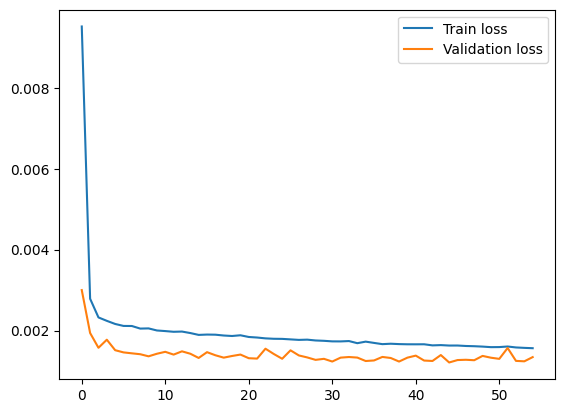

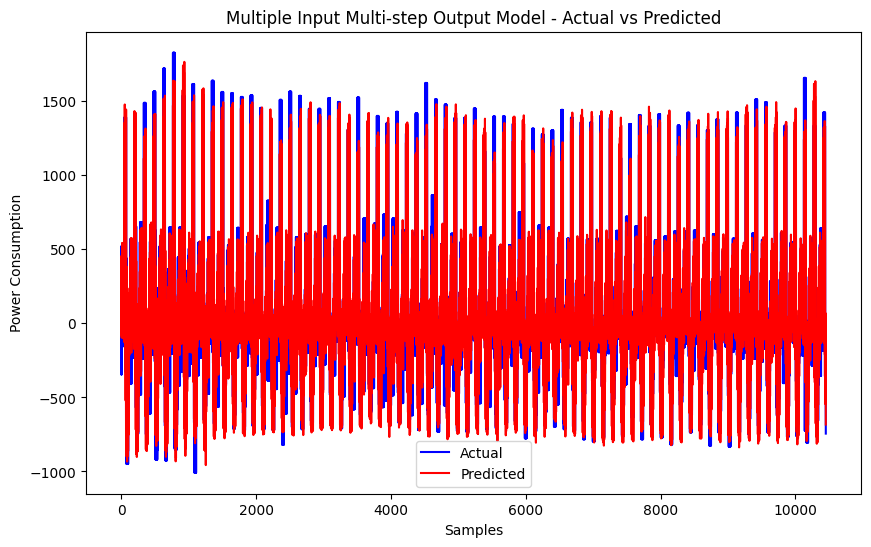

In [ ]:
# Plot training & validation loss
plt.plot(history_multi_input_multistep.history['loss'], label='Train loss')
plt.plot(history_multi_input_multistep.history['val_loss'], label='Validation loss')
plt.legend()
plt.show()

# Plot actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(y_test_inversed, color='blue', label='Actual')
plt.plot(predictions_multi_input_multistep_inversed, color='red', label='Predicted')
plt.title('Multiple Input Multi-step Output Model - Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Power Consumption')
plt.legend()
plt.show()

### 9.4.2 Multiple Parallel Input and Multi-step Output Model

In [ ]:
# Function to split a sequence into samples for multi-step forecasting
def create_multistep_dataset(data, time_steps_in=24, time_steps_out=6):
    X, y = [], []
    for i in range(len(data) - time_steps_in - time_steps_out + 1):
        X.append(data[i:i + time_steps_in, :])
        y.append(data[i + time_steps_in:i + time_steps_in + time_steps_out, 0])
    return np.array(X), np.array(y)

time_steps_in = 24
time_steps_out = 6

# Split data
X, y = create_multistep_dataset(data_scaled, time_steps_in, time_steps_out)
split = int(0.8 * len(X))
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]

# Define model
model_multi_parallel_multistep = Sequential()
model_multi_parallel_multistep.add(LSTM(50, activation='relu', input_shape=(time_steps_in, X_train.shape[2])))
model_multi_parallel_multistep.add(RepeatVector(time_steps_out))
model_multi_parallel_multistep.add(LSTM(50, activation='relu', return_sequences=True))
model_multi_parallel_multistep.add(TimeDistributed(Dense(1)))
model_multi_parallel_multistep.compile(optimizer='adam', loss='mean_squared_error')

# Early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model
history_multi_parallel_multistep = model_multi_parallel_multistep.fit(
    X_train, y_train.reshape(y_train.shape[0], y_train.shape[1], 1),
    epochs=100, batch_size=32,
    validation_data=(X_test, y_test.reshape(y_test.shape[0], y_test.shape[1], 1)),
    callbacks=[early_stopping], verbose=1
)

# Predict values
predictions_multi_parallel_multistep = model_multi_parallel_multistep.predict(X_test)

# Prepare the inverse transformation
n_features = data_scaled.shape[1]
predictions_multi_parallel_multistep_reshaped = predictions_multi_parallel_multistep.reshape(predictions_multi_parallel_multistep.shape[0] * time_steps_out, 1)
predictions_multi_parallel_multistep_scaled = np.hstack((predictions_multi_parallel_multistep_reshaped, np.zeros((predictions_multi_parallel_multistep_reshaped.shape[0], n_features - 1))))

# Inverse transform the predictions
predictions_multi_parallel_multistep_inversed = scaler.inverse_transform(predictions_multi_parallel_multistep_scaled)[:, 0]

# Reshape the test values for inverse transformation
y_test_reshaped = y_test.reshape(y_test.shape[0] * y_test.shape[1], 1)
y_test_scaled = np.hstack((y_test_reshaped, np.zeros((y_test_reshaped.shape[0], n_features - 1))))

# Inverse transform the actual values
y_test_inversed = scaler.inverse_transform(y_test_scaled)[:, 0]

Epoch 1/100
218/218 [==============================] - 22s 63ms/step - loss: 0.0406 - val_loss: 0.0106
Epoch 2/100
218/218 [==============================] - 12s 57ms/step - loss: 0.0136 - val_loss: 0.0098
Epoch 3/100
218/218 [==============================] - 11s 51ms/step - loss: 0.0131 - val_loss: 0.0095
Epoch 4/100
218/218 [==============================] - 10s 44ms/step - loss: 0.0112 - val_loss: 0.0089
Epoch 5/100
218/218 [==============================] - 8s 37ms/step - loss: 0.0113 - val_loss: 0.0080
Epoch 6/100
218/218 [==============================] - 7s 33ms/step - loss: 0.0098 - val_loss: 0.0079
Epoch 7/100
218/218 [==============================] - 5s 23ms/step - loss: 0.0090 - val_loss: 0.0072
Epoch 8/100
218/218 [==============================] - 6s 27ms/step - loss: 0.0082 - val_loss: 0.0069
Epoch 9/100
218/218 [==============================] - 6s 27ms/step - loss: 0.0075 - val_loss: 0.0066
Epoch 10/100
218/218 [==============================] - 5s 22ms/step - loss: 0

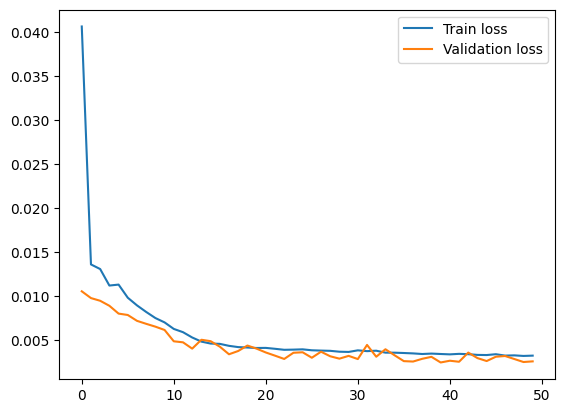

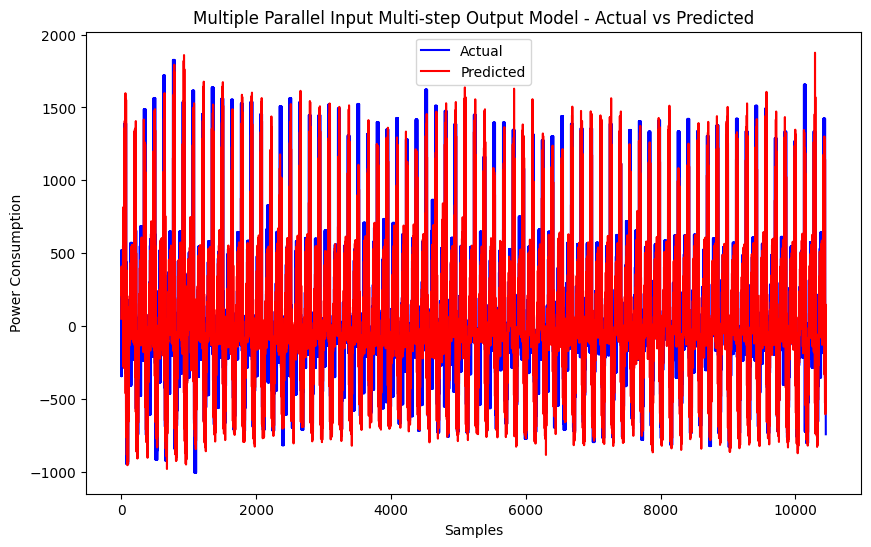

In [ ]:
# Plot training & validation loss
plt.plot(history_multi_parallel_multistep.history['loss'], label='Train loss')
plt.plot(history_multi_parallel_multistep.history['val_loss'], label='Validation loss')
plt.legend()
plt.show()

# Plot actual vs predicted values
plt.figure(figsize=(10, 6))
plt.plot(y_test_inversed, color='blue', label='Actual')
plt.plot(predictions_multi_parallel_multistep_inversed, color='red', label='Predicted')
plt.title('Multiple Parallel Input Multi-step Output Model - Actual vs Predicted')
plt.xlabel('Samples')
plt.ylabel('Power Consumption')
plt.legend()
plt.show()

# 10. RMSE, MAE, MAPE Analysis for time series forecasting models introduced so far

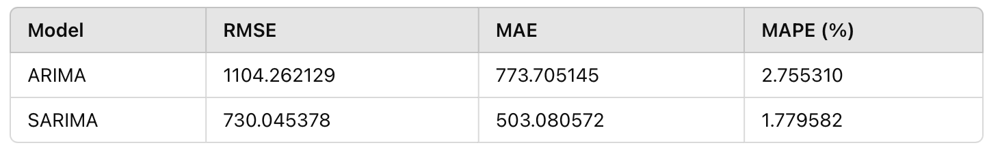

Analysis:
- Since it's important to note that these models use daily downsampling due to the exceeding file capacity, these models MAPE/RMSE/MAE cannot be compared to models using hourly downsampling.
- The SARIMA model is the best model and outperforms the ARIMA model across all metrics, which means its ability to better capture the seasonal patterns inherent in the data.
- However, Both ARIMA and SARIMA models have very low MAPE values, so both of these models have a high relative accuracy in forecasting energy consumption.


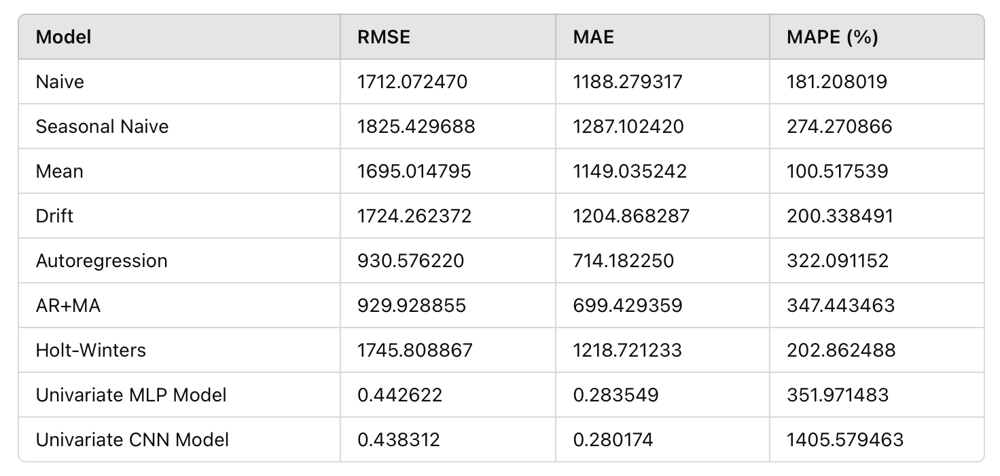

Analysis:

- The Naive, Seasonal Naive, Mean, and Drift models show relatively high RMSE, MAE, and MAPE values because they are simple models and limited predictive power.
- The Autoregression and AR+MA models show lower RMSE and MAE values compared to baseline models because incorporating autoregressive components can capture past dependencies well.
- The Univariate MLP and CNN models have remarkably low RMSE and MAE values, indicating their ability to fit the training data well. However, their high MAPE values suggest issues with relative accuracy, likely due to overfitting or poor generalization to unseen data.
- The Holt-Winters model does not perform as well as the ARIMA and SARIMA models because of seasonality and trend.


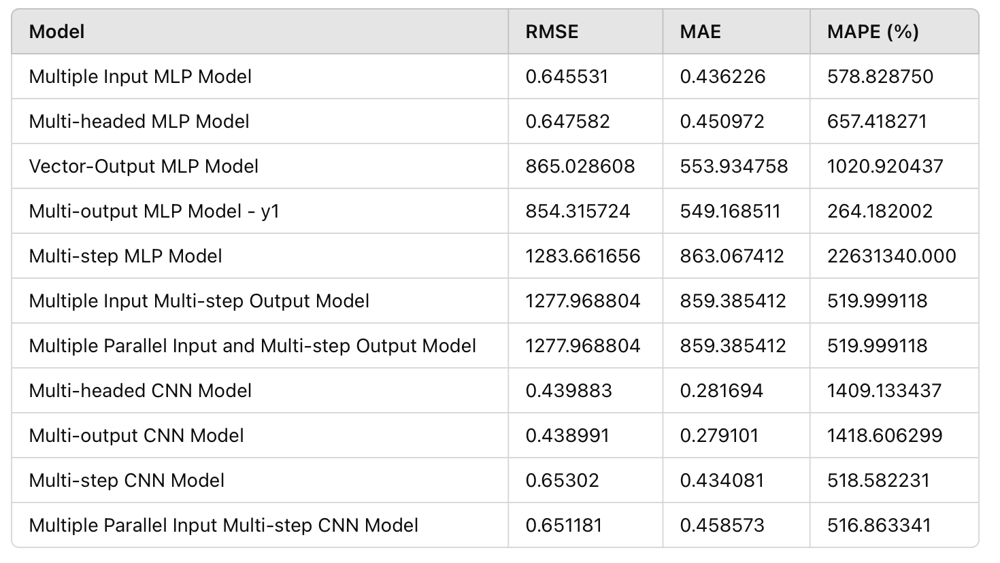

Analysis:

- **MLP Models:**
- The Multiple Input MLP and Multi-headed MLP models perform similarly with low RMSE and MAE values but have high MAPE values.
- The Vector-Output and Multi-output MLP models show higher RMSE, MAE, and MAPE values, which means they are poor performance in handling multiple outputs or steps.
-  The Multi-step MLP models show the highest error metrics, which means it is difficult to  capture multi-step dependencies accurately.
- **CNN Models:**
- The Multi-headed CNN and Multi-output CNN models show similar performance with low RMSE and MAE values but high MAPE values, similar to their univariate counterparts.
- The Multi-step CNN and Multiple Parallel Input Multi-step CNN models show higher RMSE and MAE compared to the univariate and multi-headed CNN models but lower MAPE values, which means they are better performance.
- The inclusion of additional inputs (temperature) and more complex architectures (multi-headed and multi-step models) improves RMSE and MAE but often struggles with MAPE probably because of the overfitting or challenges in generalizing to new data.


# 11. Grid Search Deep Learning Models for Univariate Forecasting

## An Overview of Grid Search
- Systematic method for tuning hyperparameters to find the optimal model configuration
- Hyperparameters are the parameters of the model that are set to prior to the training process.
- The number of nodes in a layer, the number of epochs, the batch size and the differencing order are changed and compared.


## 11.1 Multilayer Perceptron (MLP) Model



**How MLP Works**
- Input Layer: Receives the input data.
- Hidden Layers: Process the data through multiple neurons.
- Output Layer: Produces the final prediction.

**Hyperparameters**
- n_input: Number of input neurons.
- n_nodes: Number of neurons in each hidden layer.
- n_epochs: Number of training epochs.
- n_batch: Batch size for training.
- n_diff: Differencing order for time series data.


In [ ]:
import numpy as np
import pandas as pd
from math import sqrt
from keras.models import Sequential
from matplotlib import pyplot as plt
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, LSTM

In [ ]:
# Load the dataset
file_path = 'powerconsumption.csv'
data = pd.read_csv(file_path)

# Convert 'Datetime' to datetime format
data['Datetime'] = pd.to_datetime(data['Datetime'])

# Set 'Datetime' as the index
data.set_index('Datetime', inplace=True)

# Resample the data to hourly frequency
hourly_data = data.resample('H').mean()

# Display the first few rows of the hourly resampled data
hourly_data.head()

/tmp/ipykernel_4048549/3691298954.py:12: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  hourly_data = data.resample('H').mean()


,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3
Datetime,,,,,,,,
2017-01-01 00:00:00,6.196833,75.066667,0.081833,0.063500,0.098833,29197.974683,18026.747720,19252.048193
2017-01-01 01:00:00,5.548833,77.583333,0.082000,0.056833,0.112500,24657.215190,16078.419453,17042.891567
2017-01-01 02:00:00,5.054333,78.933333,0.082333,0.063000,0.129167,22083.037973,14330.699088,15676.144578
2017-01-01 03:00:00,5.004333,77.083333,0.082833,0.059833,0.141000,20811.139240,13219.452887,14883.855422
2017-01-01 04:00:00,5.097667,74.050000,0.082333,0.058000,0.122833,20475.949367,12921.580547,14317.108433


In [ ]:
# Function to create supervised learning data
def series_to_supervised(data, n_in, n_out=1):
    df = pd.DataFrame(data)
    cols = []
    # Create input sequence (t-n, ..., t-1)
    cols += [df.shift(i) for i in range(n_in, 0, -1)]
    # Create forecast sequence (t, t+1, ..., t+n)
    cols += [df.shift(-i) for i in range(n_out)]
    # Combine all sequences and drop rows with NaN values
    agg = pd.concat(cols, axis=1).dropna()
    return agg.values



In [ ]:
# Function to apply differencing
def difference(data, order):
    return [data[i] - data[i - order] for i in range(order, len(data))]


In [ ]:

# Fit an MLP model
def model_fit(train, config):
    n_input, n_nodes, n_epochs, n_batch, n_diff = config
    if n_diff > 0:
        train = difference(train, n_diff)
    data = series_to_supervised(train, n_in=n_input)
    train_x, train_y = data[:, :-1], data[:, -1]
    model = Sequential()
    model.add(Dense(n_nodes, activation='relu', input_dim=n_input))
    model.add(Dense(1))
    model.compile(loss='mse', optimizer='adam')
    es = EarlyStopping(monitor='loss', patience=10, verbose=1)
    model.fit(train_x, train_y, epochs=n_epochs, batch_size=n_batch, verbose=0, callbacks=[es])
    return model

In [ ]:
# Forecast with the fit model
def model_predict(model, history, config):
    n_input, _, _, _, n_diff = config
    correction = history[-n_diff] if n_diff > 0 else 0.0
    history = difference(history, n_diff) if n_diff > 0 else history
    x_input = np.array(history[-n_input:]).reshape((1, n_input))
    yhat = model.predict(x_input, verbose=0)
    return correction + yhat[0]

 **Walk-Forward Validation**
- Train the model on the initial training set and make a prediction for the first test point.
- Add the actual first test point to the training set and make a prediction dor the second test point.
- Repeat these steps.

In [ ]:
# Function for walk-forward validation
def walk_forward_validation(data, n_test, cfg):
    predictions = []
    train, test = train_test_split(data, test_size=n_test)
    model = model_fit(train, cfg)
    history = list(train)
    for i in range(len(test)):
        yhat = model_predict(model, history, cfg)
        predictions.append(yhat)
        history.append(test[i])
    error = sqrt(mean_squared_error(test, predictions))
    print(' > %.3f' % error)
    return error

In [ ]:
# Function to repeat evaluation
def repeat_evaluate(data, config, n_test, n_repeats=10):
    scores = [walk_forward_validation(data, n_test, config) for _ in range(n_repeats)]
    result = np.mean(scores)
    print('> Model[%s] %.3f' % (str(config), result))
    return str(config), result


In [ ]:
# Grid search through configurations
def grid_search(data, cfg_list, n_test):
    scores = [repeat_evaluate(data, cfg, n_test) for cfg in cfg_list]
    scores.sort(key=lambda tup: tup[1])
    return scores


In [ ]:

# Create a list of model configurations to try
def model_configs():
    n_input = [12]
    n_nodes = [50, 100]
    n_epochs = [100]
    n_batch = [1, 150]
    n_diff = [0, 12]
    configs = [[i, j, k, l, m] for i in n_input for j in n_nodes for k in n_epochs for l in n_batch for m in n_diff]
    print('Total configs: %d' % len(configs))
    return configs

In [ ]:
# Define the target variable
target_series = hourly_data['PowerConsumption_Zone1'].values

# Split data for walk-forward validation
n_test = 12

# Model configurations
cfg_list = model_configs()

# Perform grid search
scores = grid_search(target_series, cfg_list, n_test)
print('done')

# List top 3 configurations
for cfg, error in scores[:3]:
    print(cfg, error)

Total configs: 8


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2024-07-13 22:02:25.534565: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-07-13 22:02:25.553027: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI

Epoch 45: early stopping
 > 8388.050


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 41: early stopping
 > 7594.382


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 63: early stopping
 > 6670.705


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 31: early stopping
 > 8841.877


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 42: early stopping
 > 8218.634


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 38: early stopping
 > 8777.650


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 48: early stopping
 > 6597.808


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 42: early stopping
 > 4683.673


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 18: early stopping
 > 7066.427


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 44: early stopping
 > 8167.910
> Model[[12, 50, 100, 1, 0]] 7500.712


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 48: early stopping
 > 10423.392


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 35: early stopping
 > 7432.108


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 31: early stopping
 > 8222.291


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 40: early stopping
 > 6855.503


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 61: early stopping
 > 9148.150


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 63: early stopping
 > 7591.270


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 47: early stopping
 > 4419.556


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 29: early stopping
 > 9772.355


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 38: early stopping
 > 8042.722


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 27: early stopping
 > 6161.148
> Model[[12, 50, 100, 1, 12]] 7806.849


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 34: early stopping
 > 7875.495


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 29: early stopping
 > 7784.638


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 35: early stopping
 > 6373.830


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 38: early stopping
 > 6791.013


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 37: early stopping
 > 7550.849


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 29: early stopping
 > 6430.818


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 37: early stopping
 > 8077.009


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 52: early stopping
 > 6527.178


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 26: early stopping
 > 7259.108


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 39: early stopping
 > 6838.130
> Model[[12, 50, 100, 150, 0]] 7150.807


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 6656.601


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 6072.015


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 10165.761


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 10367.366


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 7626.880


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 8426.185


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 7299.296


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 9224.152


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 8793.680


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 9350.924
> Model[[12, 50, 100, 150, 12]] 8398.286


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 38: early stopping
 > 8903.809


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 51: early stopping
 > 7708.990


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 26: early stopping
 > 6364.905


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 72: early stopping
 > 6838.231


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 41: early stopping
 > 6575.763


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 35: early stopping
 > 5873.693


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 36: early stopping
 > 8762.956


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 47: early stopping
 > 8434.981


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 47: early stopping
 > 4869.256


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 31: early stopping
 > 7062.355
> Model[[12, 100, 100, 1, 0]] 7139.494


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 47: early stopping
 > 8327.008


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 53: early stopping
 > 5377.016


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 33: early stopping
 > 11183.746


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 34: early stopping
 > 8988.950


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 27: early stopping
 > 8598.184


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 36: early stopping
 > 6687.006


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 55: early stopping
 > 7203.591


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 39: early stopping
 > 6276.589


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 25: early stopping
 > 10175.941


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 43: early stopping
 > 5794.797
> Model[[12, 100, 100, 1, 12]] 7861.283


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 29: early stopping
 > 6633.019


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 35: early stopping
 > 7982.526


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 27: early stopping
 > 6167.281


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 42: early stopping
 > 6190.782


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 32: early stopping
 > 8897.671


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 29: early stopping
 > 8091.399


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 26: early stopping
 > 4376.681


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 42: early stopping
 > 8699.071


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 49: early stopping
 > 7362.540


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 38: early stopping
 > 6126.454
> Model[[12, 100, 100, 150, 0]] 7052.742


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 9066.449


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 9663.988


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 9845.802


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 8223.527


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 8644.855


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 13627.714


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 10126.083


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 6560.097


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 7977.379


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 8357.918
> Model[[12, 100, 100, 150, 12]] 9209.381
done
[12, 100, 100, 150, 0] 7052.742375073378
[12, 100, 100, 1, 0] 7139.493911702984
[12, 50, 100, 150, 0] 7150.806752128689


**Discussion of the results**
- Best configuration is **[12, 100, 100, 150, 0]** with error of 7052.742375073378.
- which means: n_input = 12, n_nodes = 100, n_epochs = 100, n_batch = 150, n_diff = 0 -> No differencing applied.
- Also there are two superior conditions: [12, 100, 100, 1, 0] with an error of 7139.493911702984 and [12, 50, 100, 150, 0] with an error of 7150.806752128689.


## 11.2 Convolutional Neural Network Model

**How CNN Works**
- Convolutional Layers: Apply filters to the input data to extract features.
- Pooling Layers: Downsample the data to reduce dimensionality.
- Fully Connected Layers: Similar to MLP, they produce the final prediction.

**Hyperparameters**
- n_input: Number of time steps.
- n_filters: Number of convolutional filters.
- n_kernels: Size of the convolutional filters (kernels).
- n_epochs: Number of training epochs.
- n_batch: Batch size for training.
- n_diff: Differencing order for time series data.


In [ ]:
import numpy as np
import pandas as pd
from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense
from keras.callbacks import EarlyStopping
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from math import sqrt
import matplotlib.pyplot as plt

In [ ]:
# Fit a CNN model
def model_fit(train, config):
    n_input, n_filters, n_kernel, n_epochs, n_batch, n_diff = config
    if n_diff > 0:
        train = difference(train, n_diff)
    data = series_to_supervised(train, n_in=n_input)
    train_x, train_y = data[:, :-1], data[:, -1]
    n_features = 1
    train_x = train_x.reshape((train_x.shape[0], train_x.shape[1], n_features))
    model = Sequential([
        Conv1D(filters=n_filters, kernel_size=n_kernel, activation='relu', input_shape=(n_input, n_features)),
        MaxPooling1D(pool_size=2),
        Flatten(),
        Dense(1)
    ])
    model.compile(loss='mse', optimizer='adam')
    es = EarlyStopping(monitor='loss', patience=10, verbose=1)
    model.fit(train_x, train_y, epochs=n_epochs, batch_size=n_batch, verbose=0, callbacks=[es])
    return model

In [ ]:
# Forecast with the fit model
def model_predict(model, history, config):
    n_input, _, _, _, _, n_diff = config
    correction = history[-n_diff] if n_diff > 0 else 0.0
    history = difference(history, n_diff) if n_diff > 0 else history
    x_input = np.array(history[-n_input:]).reshape((1, n_input, 1))
    yhat = model.predict(x_input, verbose=0)
    return correction + yhat[0][0]


In [ ]:
# Function for walk-forward validation
def walk_forward_validation(data, n_test, cfg):
    predictions = []
    train, test = train_test_split(data, test_size=n_test)
    model = model_fit(train, cfg)
    history = list(train)
    for i in range(len(test)):
        yhat = model_predict(model, history, cfg)
        predictions.append(yhat)
        history.append(test[i])
    error = sqrt(mean_squared_error(test, predictions))
    print(' > %.3f' % error)
    return error

In [ ]:

# Function to repeat evaluation
def repeat_evaluate(data, config, n_test, n_repeats=10):
    scores = [walk_forward_validation(data, n_test, config) for _ in range(n_repeats)]
    result = np.mean(scores)
    print('> Model[%s] %.3f' % (str(config), result))
    return str(config), result


In [ ]:
# Grid search through configurations
def grid_search(data, cfg_list, n_test):
    scores = [repeat_evaluate(data, cfg, n_test) for cfg in cfg_list]
    scores.sort(key=lambda tup: tup[1])
    return scores

In [ ]:
# Create a list of model configurations to try
def model_configs():
    n_input = [12]
    n_filters = [32, 64]
    n_kernels = [3, 5]
    n_epochs = [100]
    n_batch = [1, 150]
    n_diff = [0, 12]
    configs = [[i, j, k, l, m, n] for i in n_input for j in n_filters for k in n_kernels for l in n_epochs for m in n_batch for n in n_diff]
    print('Total configs: %d' % len(configs))
    return configs

In [ ]:
# Define the target variable
target_series = hourly_data['PowerConsumption_Zone1'].values

# Split data for walk-forward validation
n_test = 12

# Model configurations
cfg_list = model_configs()

# Perform grid search
scores = grid_search(target_series, cfg_list, n_test)
print('done')

# List top 3 configurations
for cfg, error in scores[:3]:
    print(cfg, error)



Total configs: 16
Epoch 34: early stopping
 > 10046.694


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 34: early stopping
 > 7677.119


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 34: early stopping
 > 5800.429


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 30: early stopping
 > 9064.199


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 22: early stopping
 > 6712.987


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 28: early stopping
 > 6733.351


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 26: early stopping
 > 6815.383


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 43: early stopping
 > 7115.952


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 52: early stopping
 > 5700.315


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 17: early stopping
 > 6421.720
> Model[[12, 32, 3, 100, 1, 0]] 7208.815


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 45: early stopping
 > 6365.889


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 63: early stopping
 > 9662.656


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 22: early stopping
 > 6036.440


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 70: early stopping
 > 7601.541


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 20: early stopping
 > 11822.481


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 49: early stopping
 > 8120.653


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 41: early stopping
 > 9162.686


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 45: early stopping
 > 8302.014


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 22: early stopping
 > 9480.373


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 36: early stopping
 > 8749.019
> Model[[12, 32, 3, 100, 1, 12]] 8530.375


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 52: early stopping
 > 4772.187


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 77: early stopping
 > 7336.511


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 59: early stopping
 > 9626.511


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 75: early stopping
 > 8591.788


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 55: early stopping
 > 6092.190


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 54: early stopping
 > 7661.987


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 63: early stopping
 > 9052.759


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 67: early stopping
 > 7339.430


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 7454.648


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 56: early stopping
 > 5728.389
> Model[[12, 32, 3, 100, 150, 0]] 7365.640


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 94: early stopping
 > 10611.509


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 84: early stopping
 > 10214.795


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 79: early stopping
 > 7895.846


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 92: early stopping
 > 9549.417


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 67: early stopping
 > 8747.022


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 87: early stopping
 > 13004.731


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 69: early stopping
 > 7132.893


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 89: early stopping
 > 8260.160


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 89: early stopping
 > 6243.144


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 75: early stopping
 > 8386.273
> Model[[12, 32, 3, 100, 150, 12]] 9004.579


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 56: early stopping
 > 7763.516


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 21: early stopping
 > 7093.266


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 29: early stopping
 > 4892.097


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 21: early stopping
 > 4795.639


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 17: early stopping
 > 6077.335


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 30: early stopping
 > 6916.640


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 37: early stopping
 > 7349.839


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 32: early stopping
 > 5756.873


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 37: early stopping
 > 6621.400


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 53: early stopping
 > 8257.608
> Model[[12, 32, 5, 100, 1, 0]] 6552.421


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 23: early stopping
 > 8045.668


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 45: early stopping
 > 8948.394


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 41: early stopping
 > 8802.197


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 33: early stopping
 > 7845.013


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 37: early stopping
 > 10076.102


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 41: early stopping
 > 7382.351


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 54: early stopping
 > 6376.125


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 51: early stopping
 > 10156.980


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 38: early stopping
 > 9654.283


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 49: early stopping
 > 4194.401
> Model[[12, 32, 5, 100, 1, 12]] 8148.152


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 74: early stopping
 > 6546.354


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 68: early stopping
 > 5548.386


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 49: early stopping
 > 6617.032


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 49: early stopping
 > 8307.877


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 70: early stopping
 > 6074.007


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 60: early stopping
 > 5722.538


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 55: early stopping
 > 9517.543


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 60: early stopping
 > 5376.305


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 68: early stopping
 > 5812.560


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 48: early stopping
 > 6226.025
> Model[[12, 32, 5, 100, 150, 0]] 6574.863


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 98: early stopping
 > 11224.877


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 6532.935


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 10339.771


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 10949.585


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 6709.139


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 7907.587


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 52: early stopping
 > 10395.868


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 98: early stopping
 > 11120.838


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 83: early stopping
 > 5329.617


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 87: early stopping
 > 10664.476
> Model[[12, 32, 5, 100, 150, 12]] 9117.469


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 29: early stopping
 > 6991.867


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 37: early stopping
 > 8276.635


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 44: early stopping
 > 8065.247


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 22: early stopping
 > 7674.884


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 37: early stopping
 > 7190.270


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 43: early stopping
 > 6457.033


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 56: early stopping
 > 5955.538


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 28: early stopping
 > 9310.486


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 19: early stopping
 > 8755.481


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 34: early stopping
 > 6271.731
> Model[[12, 64, 3, 100, 1, 0]] 7494.917


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 44: early stopping
 > 8864.086


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 29: early stopping
 > 8500.004


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 56: early stopping
 > 9043.496


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 36: early stopping
 > 7675.567


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 54: early stopping
 > 9596.189


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 21: early stopping
 > 9044.477


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 29: early stopping
 > 9990.248


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 30: early stopping
 > 10531.157


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 56: early stopping
 > 8988.820


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 61: early stopping
 > 9689.026
> Model[[12, 64, 3, 100, 1, 12]] 9192.307


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 37: early stopping
 > 5817.021


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 36: early stopping
 > 5853.743


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 52: early stopping
 > 7847.170


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 56: early stopping
 > 5222.608


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 52: early stopping
 > 6982.279


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 62: early stopping
 > 7846.242


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 47: early stopping
 > 6802.598


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 36: early stopping
 > 7851.822


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 46: early stopping
 > 8595.062


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 48: early stopping
 > 8546.309
> Model[[12, 64, 3, 100, 150, 0]] 7136.485


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 99: early stopping
 > 7404.394


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 87: early stopping
 > 11996.791


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 52: early stopping
 > 10208.870


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 69: early stopping
 > 8828.234


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 59: early stopping
 > 8770.269


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 66: early stopping
 > 10227.537


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 62: early stopping
 > 7288.161


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 66: early stopping
 > 8510.773


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 70: early stopping
 > 8287.734


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 76: early stopping
 > 8374.195
> Model[[12, 64, 3, 100, 150, 12]] 8989.696


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 35: early stopping
 > 6818.398


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 24: early stopping
 > 8513.520


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 26: early stopping
 > 6792.374


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 37: early stopping
 > 7883.567


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 33: early stopping
 > 4003.590


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 28: early stopping
 > 7783.474


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 24: early stopping
 > 8874.122


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 30: early stopping
 > 5368.507


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 57: early stopping
 > 6444.883


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 22: early stopping
 > 8216.703
> Model[[12, 64, 5, 100, 1, 0]] 7069.914


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 44: early stopping
 > 8599.769


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 55: early stopping
 > 6761.122


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 36: early stopping
 > 11624.511


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 26: early stopping
 > 8823.123


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 43: early stopping
 > 8252.338


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 62: early stopping
 > 8407.014


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 44: early stopping
 > 10011.806


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 30: early stopping
 > 6960.684


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 42: early stopping
 > 8113.397


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 70: early stopping
 > 8666.173
> Model[[12, 64, 5, 100, 1, 12]] 8621.994


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 48: early stopping
 > 8254.462


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 50: early stopping
 > 8632.488


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 34: early stopping
 > 7793.995


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 66: early stopping
 > 5605.957


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 31: early stopping
 > 7318.763


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 45: early stopping
 > 9417.401


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 32: early stopping
 > 7451.191


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 49: early stopping
 > 7841.204


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 42: early stopping
 > 5926.812


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 40: early stopping
 > 5284.074
> Model[[12, 64, 5, 100, 150, 0]] 7352.635


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 6172.052


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 7303.114


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 9153.592


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 8823.966


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 9385.108


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 78: early stopping
 > 5507.138


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 9713.130


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 7765.271


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


 > 7546.145


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 71: early stopping
 > 7439.858
> Model[[12, 64, 5, 100, 150, 12]] 7880.938
done
[12, 32, 5, 100, 1, 0] 6552.421281779274
[12, 32, 5, 100, 150, 0] 6574.862780432634
[12, 64, 5, 100, 1, 0] 7069.913885772633


**Discussion of the results**
- Best configuration is **[12, 32, 5, 100, 1, 0]** with error of 6552.421281779274.
- which means: n_input = 12,
n_filters = 32,
n_kernels = 5,
n_epochs = 100,
n_batch = 1
n_diff = 0 -> No differencing applied.
- Also there are two superior conditions: [12, 32, 5, 100, 150, 0] with an error of 6574.862780432634 and [12, 64, 5, 100, 1, 0] with an error of 7069.913885772633


## 11.3 Long Short-Term Memory Network Model

**How LSTM Works**

- LSTM Cells: Contain gates to control the flow of information, making them capable of learning long-term dependencies.
- Recurrent Connections: Use the hidden state from the previous time step as part of the input for the current time step.

**Hyperparameters:**
- n_input: Number of time steps.
- n_nodes: Number of LSTM units.
- n_epochs: Number of training epochs.
- n_batch: Batch size for training.
- n_diff: Differencing order for time series data.


In [ ]:
# Fit an LSTM model
def model_fit(train, config):
    n_input, n_nodes, n_epochs, n_batch, n_diff = config
    if n_diff > 0:
        train = difference(train, n_diff)
    data = series_to_supervised(train, n_in=n_input)
    train_x, train_y = data[:, :-1], data[:, -1]
    train_x = train_x.reshape((train_x.shape[0], train_x.shape[1], 1))
    model = Sequential([
        LSTM(n_nodes, activation='relu', input_shape=(n_input, 1)),
        Dense(1)
    ])
    model.compile(loss='mse', optimizer='adam')
    es = EarlyStopping(monitor='loss', patience=10, verbose=1)
    model.fit(train_x, train_y, epochs=n_epochs, batch_size=n_batch, verbose=0, callbacks=[es])
    return model


In [ ]:
# Forecast with the fit model
def model_predict(model, history, config):
    n_input, _, _, _, n_diff = config
    correction = history[-n_diff] if n_diff > 0 else 0.0
    history = difference(history, n_diff) if n_diff > 0 else history
    x_input = np.array(history[-n_input:]).reshape((1, n_input, 1))
    yhat = model.predict(x_input, verbose=0)
    return correction + yhat[0][0]


In [ ]:
# Function for walk-forward validation
def walk_forward_validation(data, n_test, cfg):
    predictions = []
    train, test = train_test_split(data, test_size=n_test)
    model = model_fit(train, cfg)
    history = list(train)
    for i in range(len(test)):
        yhat = model_predict(model, history, cfg)
        predictions.append(yhat)
        history.append(test[i])
    error = sqrt(mean_squared_error(test, predictions))
    print(' > %.3f' % error)
    return error, test, predictions

In [ ]:
# Function to repeat evaluation
def repeat_evaluate(data, config, n_test, n_repeats=10):
    scores = []
    for _ in range(n_repeats):
        score, _, _ = walk_forward_validation(data, n_test, config)
        scores.append(score)
    result = np.mean(scores)
    print('> Model[%s] %.3f' % (str(config), result))
    return str(config), result

In [ ]:

# Grid search through configurations
def grid_search(data, cfg_list, n_test):
    scores = [repeat_evaluate(data, cfg, n_test) for cfg in cfg_list]
    scores.sort(key=lambda tup: tup[1])
    return scores

In [ ]:
# Create a list of model configurations to try
def model_configs():
    n_input = [12]
    n_nodes = [50, 100]
    n_epochs = [100]
    n_batch = [1, 150]
    n_diff = [0, 12]
    configs = [[i, j, k, l, m] for i in n_input for j in n_nodes for k in n_epochs for l in n_batch for m in n_diff]
    print('Total configs: %d' % len(configs))
    return configs

In [ ]:
# Define the target variable
target_series = hourly_data['PowerConsumption_Zone1'].values

# Split data for walk-forward validation
n_test = 12

# Model configurations
cfg_list = model_configs()

# Perform grid search
scores = grid_search(target_series, cfg_list, n_test)
print('done')

# List top 3 configurations
for cfg, error in scores[:3]:
    print(cfg, error)


Total configs: 8


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 20: early stopping
 > 7652.875


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 24: early stopping
 > 8574.848


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 31: early stopping
 > 9704.244


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 23: early stopping
 > 6622.664


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 37: early stopping
 > 6891.065


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 23: early stopping
 > 6481.858


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 27: early stopping
 > 7242.242


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 49: early stopping
 > 6466.806


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 47: early stopping
 > 7134.173


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 53: early stopping
 > 5493.849
> Model[[12, 50, 100, 1, 0]] 7226.462


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 26: early stopping
 > 5852.424


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 46: early stopping
 > 8646.605


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 42: early stopping
 > 7816.836


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 37: early stopping
 > 6906.458


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 48: early stopping
 > 6744.156


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 37: early stopping
 > 12743.017


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 52: early stopping
 > 9745.532


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 34: early stopping
 > 9236.595


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 21: early stopping
 > 12353.026


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 39: early stopping
 > 11084.687
> Model[[12, 50, 100, 1, 12]] 9112.933


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 20: early stopping
 > 7206.775


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 33: early stopping
 > 8060.639


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 47: early stopping
 > 7153.284


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 14: early stopping
 > 10318.928


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 62: early stopping
 > 7682.219


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 44: early stopping
 > 6773.981


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 74: early stopping
 > 6745.759


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 66: early stopping
 > 5966.158


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 41: early stopping
 > 7722.215


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 34: early stopping
 > 8257.740
> Model[[12, 50, 100, 150, 0]] 7588.770


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 72: early stopping
 > 7300.188


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 20: early stopping
 > 7957.690


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 25: early stopping
 > 10323.767


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 20: early stopping
 > 9573.367


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 14: early stopping
 > 6795.927


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 27: early stopping
 > 8977.588


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 29: early stopping
 > 12385.322


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 25: early stopping
 > 8053.933


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 24: early stopping
 > 9502.532


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 61: early stopping
 > 9274.248
> Model[[12, 50, 100, 150, 12]] 9014.456


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 14: early stopping
 > 6656.764


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 43: early stopping
 > 6251.582


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 33: early stopping
 > 7756.492


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 21: early stopping
 > 9001.127


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 61: early stopping
 > 8949.664


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 40: early stopping
 > 6516.206


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 43: early stopping
 > 6755.398


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 29: early stopping
 > 6366.731


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 25: early stopping
 > 8179.884


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 52: early stopping
 > 7068.691
> Model[[12, 100, 100, 1, 0]] 7350.254


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 22: early stopping
 > 6267.560


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 22: early stopping
 > 11862.722


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 22: early stopping
 > 7773.073


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 49: early stopping
 > 9382.819


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 21: early stopping
 > 8655.932


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 30: early stopping
 > 13456.632


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 45: early stopping
 > 6791.924


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 27: early stopping
 > 8507.484


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 40: early stopping
 > 9151.001


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 31: early stopping
 > 11031.477
> Model[[12, 100, 100, 1, 12]] 9288.062


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 39: early stopping
 > 5632.416


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 55: early stopping
 > 7515.243


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 37: early stopping
 > 6239.647


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 37: early stopping
 > 5856.805


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 34: early stopping
 > 7012.729


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 45: early stopping
 > 6888.747


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 30: early stopping
 > 6994.358


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 34: early stopping
 > 7876.913


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 43: early stopping
 > 6190.953


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 39: early stopping
 > 8660.906
> Model[[12, 100, 100, 150, 0]] 6886.872


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 12: early stopping
 > 8536.574


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 81: early stopping
 > 9026.882


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 47: early stopping
 > 10545.348


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 24: early stopping
 > 11265.706


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 48: early stopping
 > 10080.133


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 23: early stopping
 > 9648.873


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 29: early stopping
 > 11357.914


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 34: early stopping
 > 10730.153


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 36: early stopping
 > 11914.755


/home/e-soc-student/.pyenv/versions/3.12.3/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 15: early stopping
 > 8674.436
> Model[[12, 100, 100, 150, 12]] 10178.077
done
[12, 100, 100, 150, 0] 6886.8716571766245
[12, 50, 100, 1, 0] 7226.462406432333
[12, 100, 100, 1, 0] 7350.2538532478475


**Discussion of the results**
- Best configuration is **[12, 100, 100, 150, 0]** with an error of 6886.8716571766245.

- which means: n_input = 12, n_nodes = 100, n_epochs = 100, n_batch = 150, n_diff = 0 -> No differencing applied.
- Also there are two superior conditions: [12, 50, 100, 1, 0] with an error of 7226.462406432333 and [12, 100, 100, 1, 0] with an error of 7350.2538532478475.


## 11.4 Analysis of the results
- CNN has the best performance among all since the error is smaller than others.
- The best configuration for CNN indicates gewer filters and smaller kernel size, which means the simpler CNN architecture works well.
- LSTM is the second best performance.
- The best configuration for LSTM indicates a higher number of units and a larger batch size, which means that processing more data works well.
- MLP had the highest errors among the three.
- The error of MLP indicates that fully connected layers may not capture the dependencies in the data.

# 12. Time Series Classification

**Scenario of Classification**
- In summer, air conditioning usage increased and this leads to increased power consumption.
- In winter, heating systems usage increased and this affects power consumption.
- Thus, by including temperature as a feature, the company can predict peak loads based on temperature, optimize energy distribution, and even improve maintenance scheduling.


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix
import itertools

In [ ]:
file_path = 'powerconsumption.csv'  # Update the file path if needed
data = pd.read_csv(file_path)

# Display the column names to find the correct name for the 'power_consumption_zone_1' column
print("Column Names:", data.columns)

# Inspect the first few rows of the dataset
print("First Few Rows of Data:\n", data.head())

# Set the correct column name
column_name = 'PowerConsumption_Zone1'

# Check the descriptive statistics for the column
print(f"Descriptive Statistics for {column_name}:\n", data[column_name].describe())

# Normalize the sensor data
scaler = MinMaxScaler()
data[['Temperature', column_name]] = scaler.fit_transform(data[['Temperature', column_name]])


Column Names: Index(['Datetime', 'Temperature', 'Humidity', 'WindSpeed',
       'GeneralDiffuseFlows', 'DiffuseFlows', 'PowerConsumption_Zone1',
       'PowerConsumption_Zone2', 'PowerConsumption_Zone3'],
      dtype='object')
First Few Rows of Data:
         Datetime  Temperature  Humidity  WindSpeed  GeneralDiffuseFlows  \
0  1/1/2017 0:00        6.559      73.8      0.083                0.051   
1  1/1/2017 0:10        6.414      74.5      0.083                0.070   
2  1/1/2017 0:20        6.313      74.5      0.080                0.062   
3  1/1/2017 0:30        6.121      75.0      0.083                0.091   
4  1/1/2017 0:40        5.921      75.7      0.081                0.048   

   DiffuseFlows  PowerConsumption_Zone1  PowerConsumption_Zone2  \
0         0.119             34055.69620             16128.87538   
1         0.085             29814.68354             19375.07599   
2         0.100             29128.10127             19006.68693   
3         0.096             2

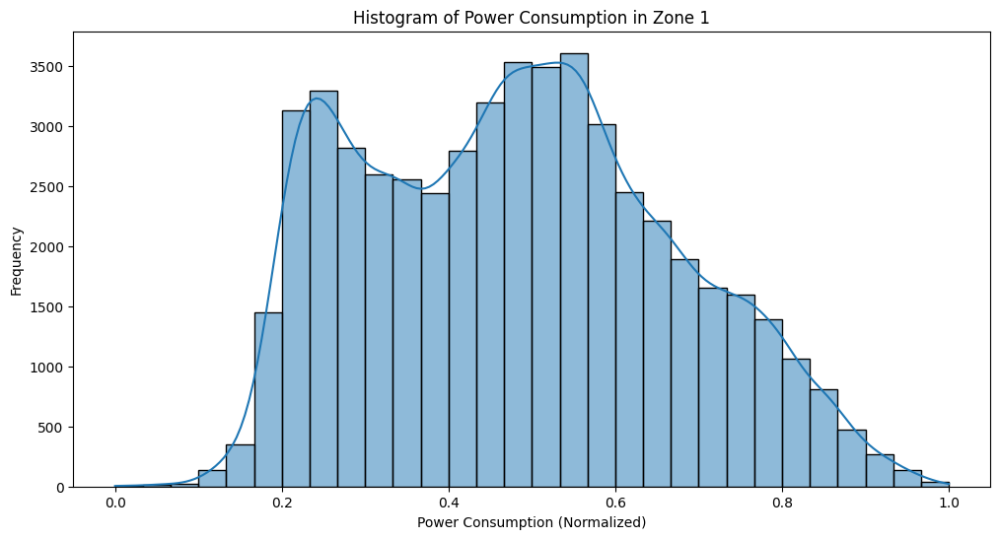

In [ ]:
# Plot the histogram of power consumption
plt.figure(figsize=(12, 6))
sns.histplot(data[column_name], bins=30, kde=True)
plt.title('Histogram of Power Consumption in Zone 1')
plt.xlabel('Power Consumption (Normalized)')
plt.ylabel('Frequency')
plt.show()

In [ ]:
# Define the target variable with five categories (0 to 4)
bins = [data[column_name].min(), data[column_name].quantile(0.2), data[column_name].quantile(0.4), data[column_name].quantile(0.6), data[column_name].quantile(0.8), data[column_name].max()]
labels = [0, 1, 2, 3, 4]
data['Target'] = pd.cut(data[column_name], bins=bins, labels=labels, include_lowest=True)

# Summarize class breakdown
def class_breakdown(data):
    counts = data.value_counts()
    total_rows = len(data)
    for class_value, count in counts.items():
        percent = count / total_rows * 100
        print(f'Class={class_value}, total={count}, percentage={percent:.3f}')

print('Dataset:')
class_breakdown(data['Target'])


Dataset:
Class=0, total=10487, percentage=20.007
Class=2, total=10483, percentage=20.000
Class=3, total=10483, percentage=20.000
Class=4, total=10483, percentage=20.000
Class=1, total=10480, percentage=19.994


- The data was equally distributed into 6 classes.
- Class 0 indicates very low power consumption.  
- Class 1 indicates fairly low power consumption.
- Class 2 indicates modelate power consumption.
- Class 3 indicates fairly high power consumption.
- Class 4 indicates very high power consumption.

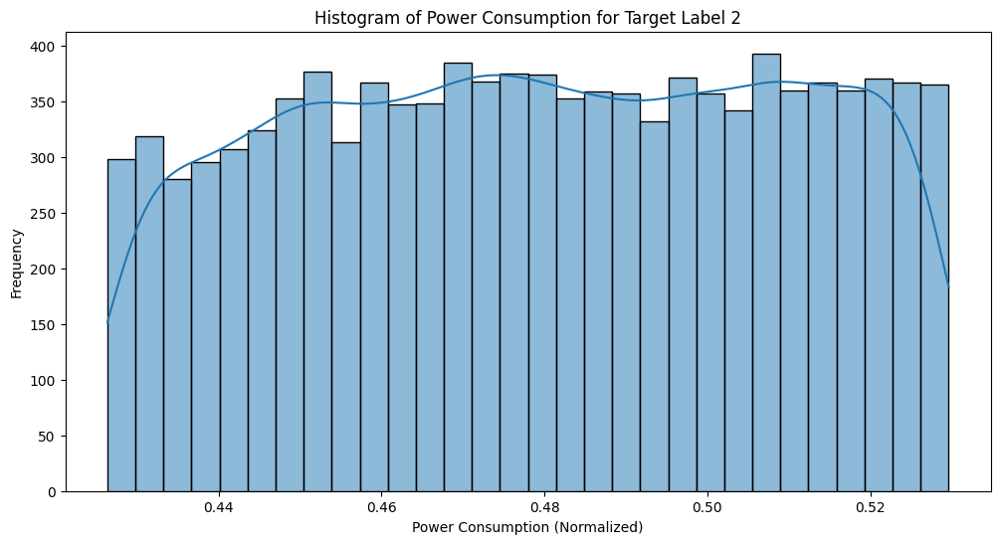

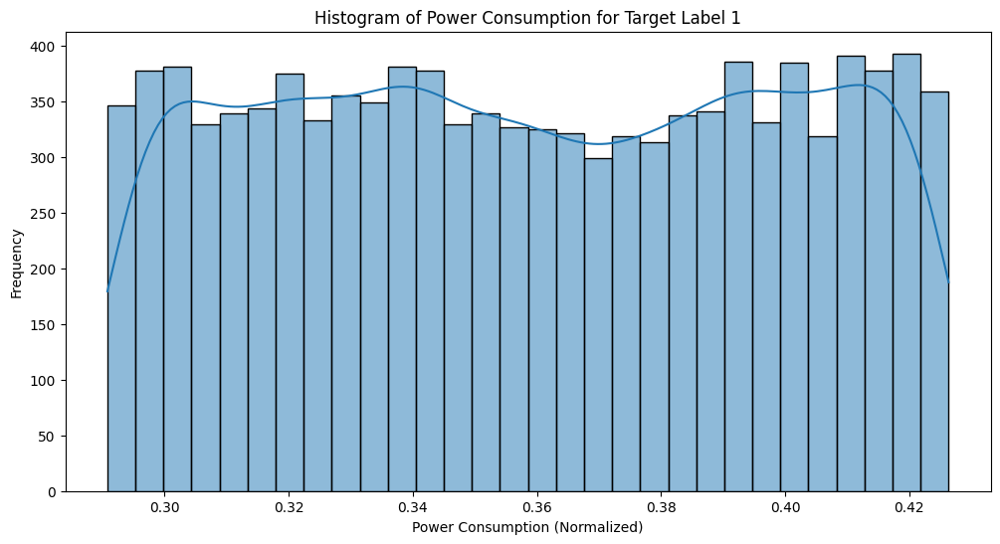

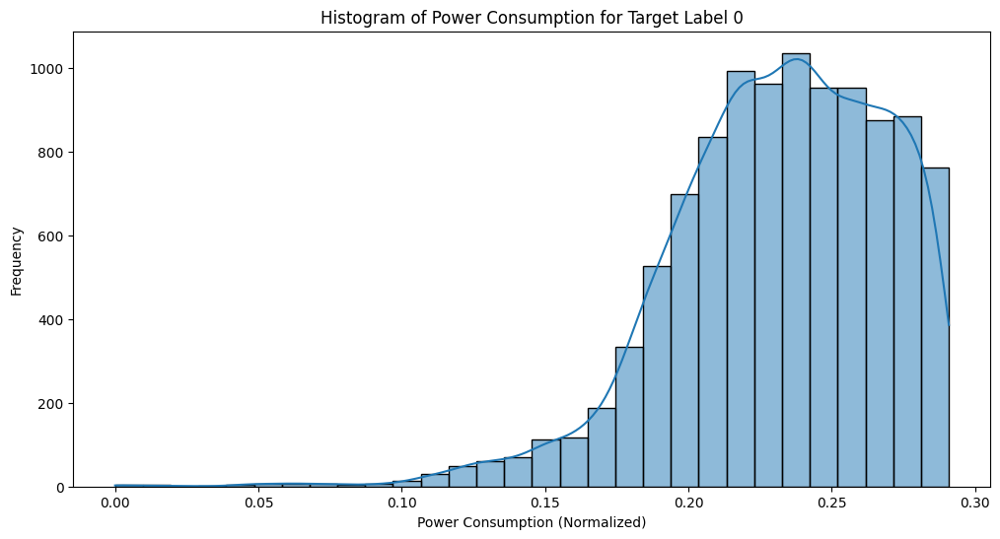

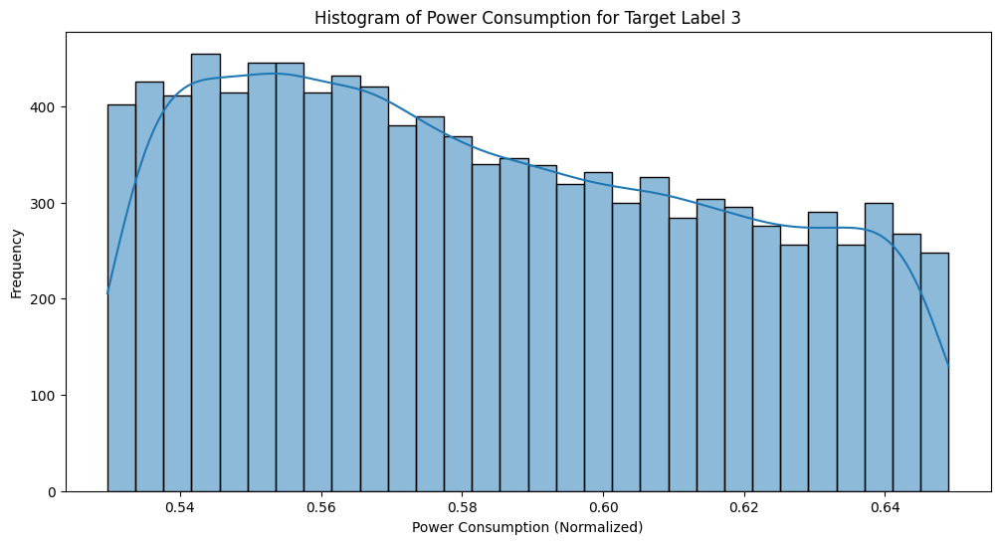

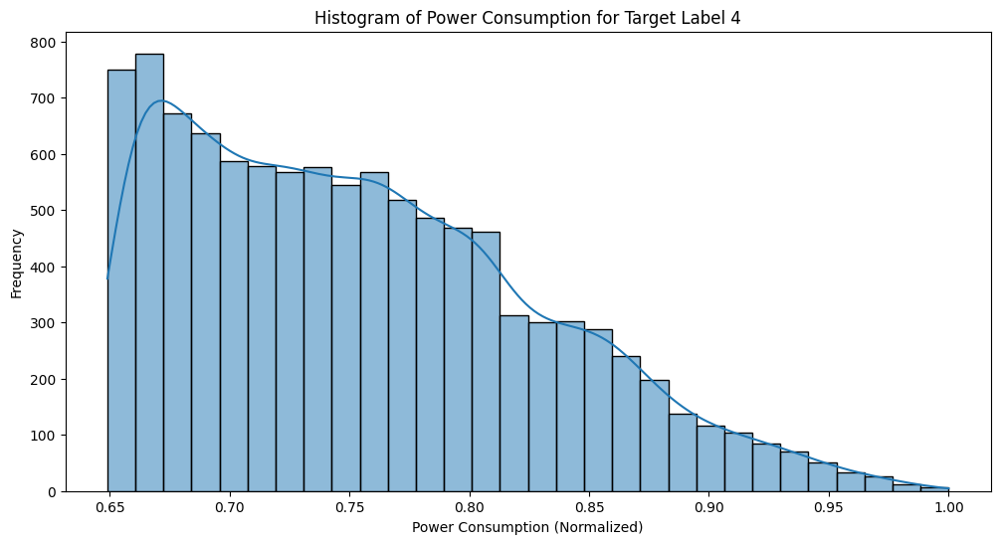

In [ ]:
# Plot histograms for each target label (power consumption)
for label in data['Target'].unique():
    plt.figure(figsize=(12, 6))
    sns.histplot(data[data['Target'] == label][column_name], bins=30, kde=True)
    plt.title(f'Histogram of Power Consumption for Target Label {label}')
    plt.xlabel('Power Consumption (Normalized)')
    plt.ylabel('Frequency')
    plt.show()


**Objectives**
- Examine the power consumption distribution

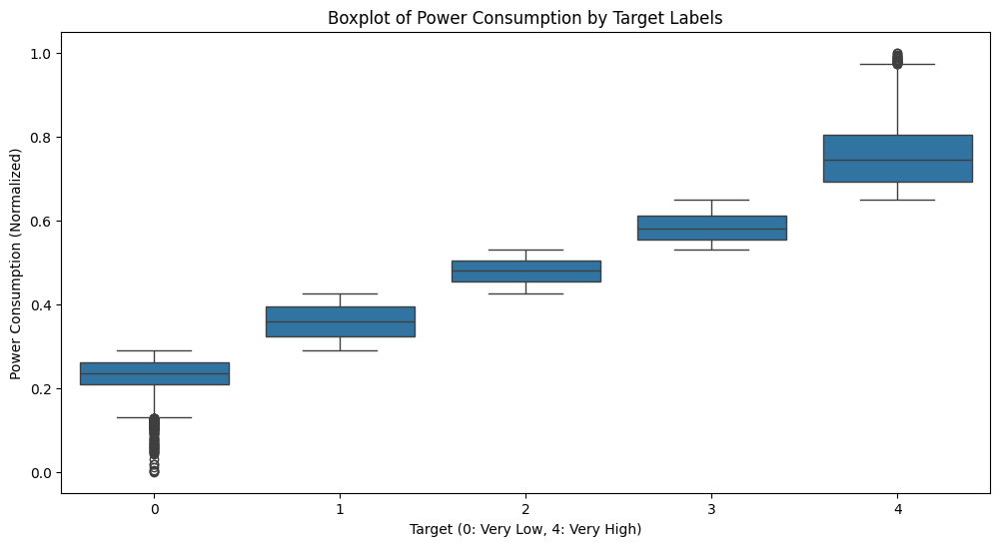

In [ ]:
# Plot the boxplot of power consumption by target labels
plt.figure(figsize=(12, 6))
sns.boxplot(x='Target', y=column_name, data=data)
plt.title('Boxplot of Power Consumption by Target Labels')
plt.xlabel('Target (0: Very Low, 4: Very High)')
plt.ylabel('Power Consumption (Normalized)')
plt.show()

**Objectives**
- The purpose is to visualize the distribution of normalized power consumption values across different target labels.

**Insights**
- There are some outliers in the label 0 (very low) and the label 4 (very high).
- Outliers indicate occasional very low and high power consumption.
- The majority of the data and median is as follows:
- Label 0: the data is from 0.15 to 0.25 and the median is around 2.0.
- Label 1: the data is from 0.3 to 0.4 and the median is around 0.35.
- Label 2: the data is from 0.4 to 0.5 and the median is around 0.45.
- Label 3: the data is from 0.5 to 0.65 and the median is around 0.6.
- Label 4: the data is from 0.65 to 1 and the median is around 0.75.
- The label 0 and 4's IQR are larger.

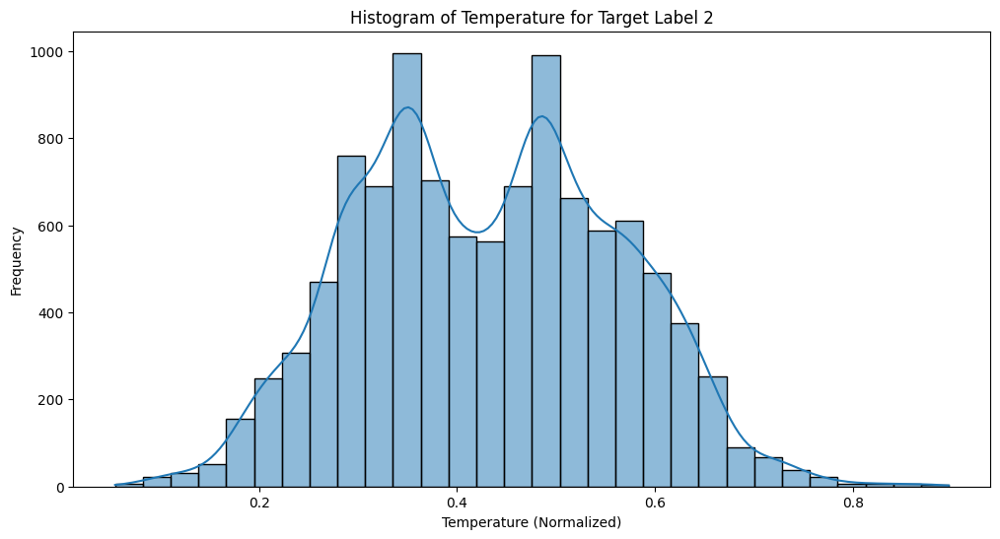

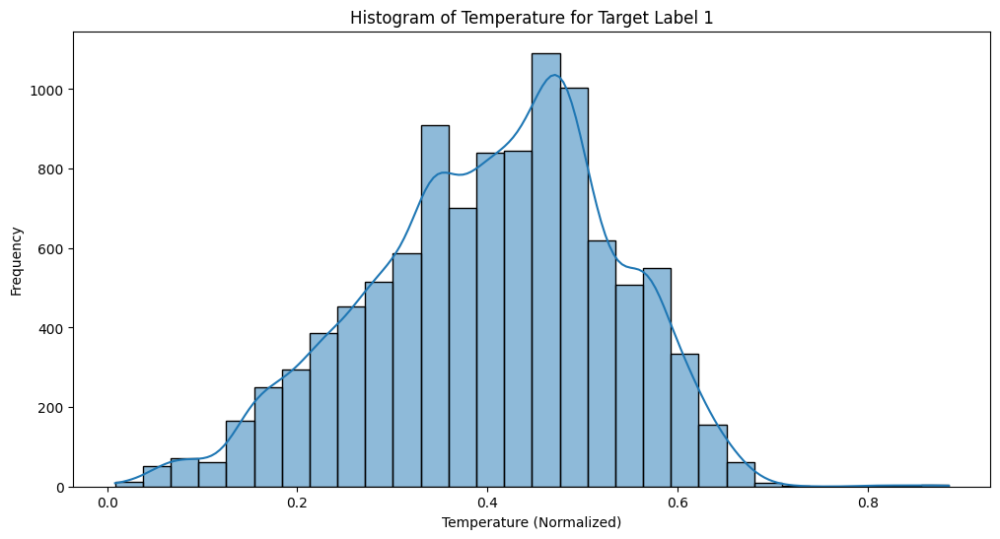

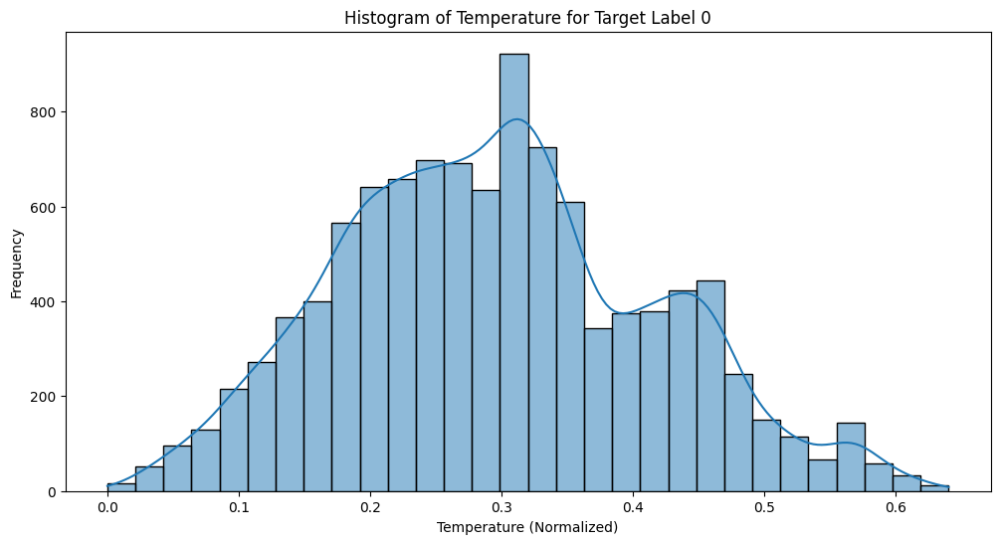

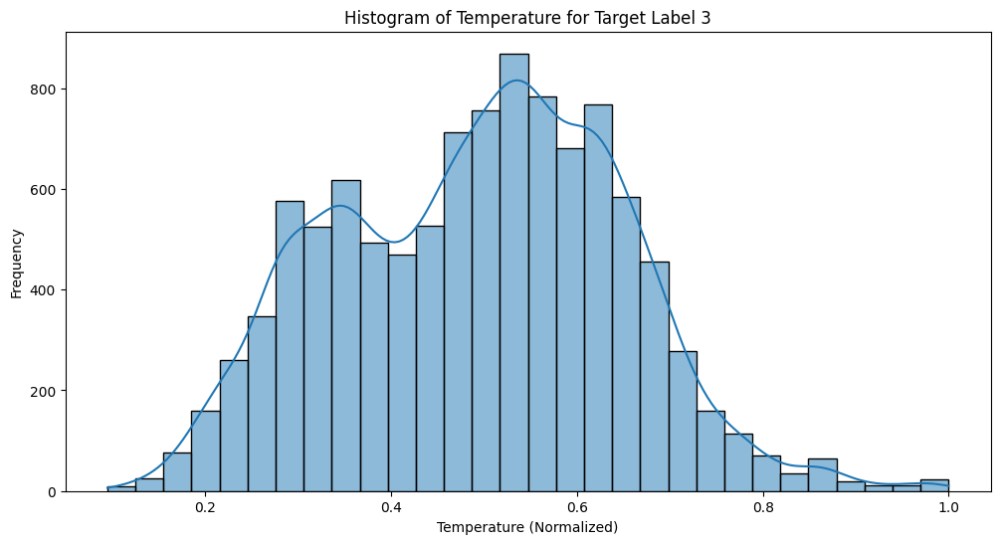

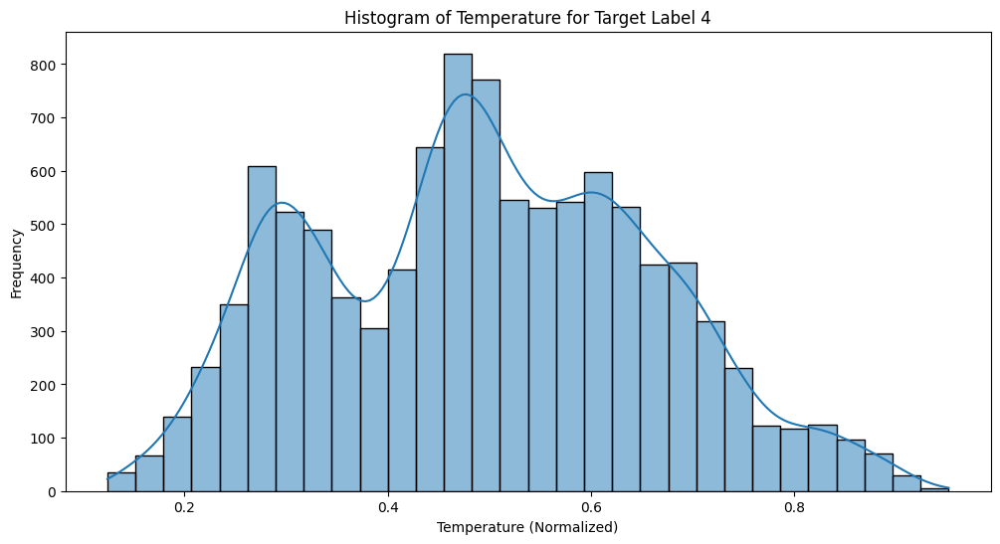

In [ ]:
# Plot histograms for each target label (temperature)
for label in data['Target'].unique():
    plt.figure(figsize=(12, 6))
    sns.histplot(data[data['Target'] == label]['Temperature'], bins=30, kde=True)
    plt.title(f'Histogram of Temperature for Target Label {label}')
    plt.xlabel('Temperature (Normalized)')
    plt.ylabel('Frequency')
    plt.show()


**Objective**
- The purpose is to understand the distribution of normalized temperature values for each power consumption target label.

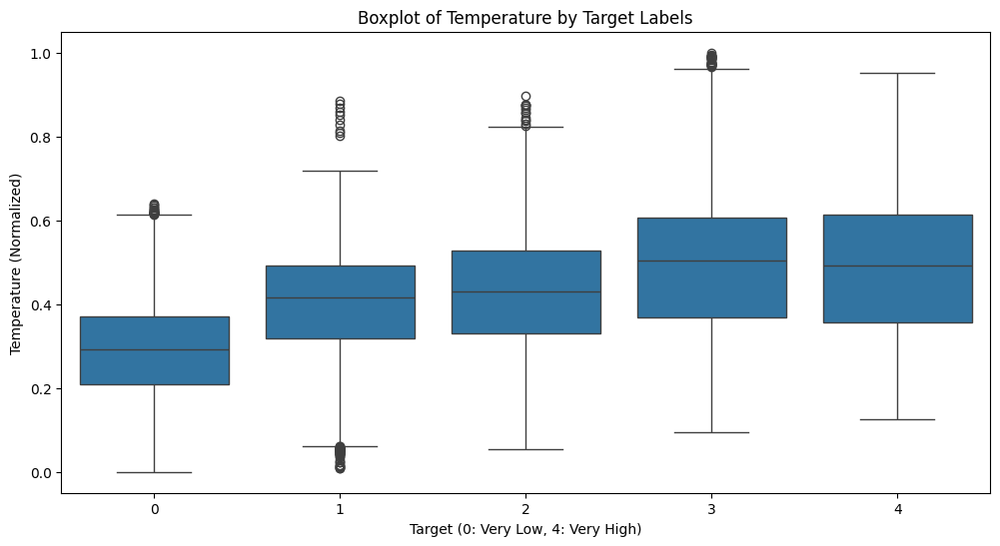

In [ ]:
# Plot the boxplot of temperature by target labels
plt.figure(figsize=(12, 6))
sns.boxplot(x='Target', y='Temperature', data=data)
plt.title('Boxplot of Temperature by Target Labels')
plt.xlabel('Target (0: Very Low, 4: Very High)')
plt.ylabel('Temperature (Normalized)')
plt.show()

**Objectives**
- The purpose is to visualize the distribution of normalized power consumption values across different power consumption target labels.

**Insights**
- There are some outliers in all labels except label 4 (very high).  
- Label 0:The median temperature is around 0.3 and the IQR spans are from 0.25 to 0.45.
- Label 1: The median temperature is around 0.4 and the IQR spans are from 0.3 to 0.5.
- Label 2: The median temperature is around 0.42 and the IQR spans are from 0.35 to 0.55.
- Label 3: The median temperature is around 0.5 and the IQR spans are from 0.4 to 0.6.
- Label 4: The median temperature is around 0.5 and the IQR spans are from 0.4 to 0.65.  
- The graph indicates that the high power consumption tend to happen in the hot weather.

In [ ]:
# Feature engineering - creating sequences
def create_sequences(data, seq_length):
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data.iloc[i:i+seq_length, :-1].values)
        y.append(data.iloc[i+seq_length, -1])  # Assuming the target is the last column
    return np.array(X), np.array(y)

SEQ_LENGTH = 10
X, y = create_sequences(data[['Temperature', column_name, 'Target']], SEQ_LENGTH)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Generate a random subject mapping for demonstration purposes
sub_map = np.random.randint(1, 11, size=y_train.shape[0])


In [ ]:
# Function to retrieve all data for a specific subject
def data_for_subject(X, y, sub_map, sub_id):
    row_indexes = [i for i, sid in enumerate(sub_map) if sid == sub_id]
    selected_X = X[row_indexes, :, :]
    selected_y = y[row_indexes]
    return selected_X, selected_y


In [ ]:
# Function to flatten data for plotting
def to_series(windows):
    series = []
    for window in windows:
        half = len(window) // 2
        series.extend(window[-half:])
    return series


In [ ]:
# Function to plot histograms for multiple subjects
def plot_subject_histograms(X, y, sub_map, offset, title, n=10):
    plt.figure(figsize=(8, 10))
    plt.suptitle(title, fontsize=14)

    subject_ids = np.unique(sub_map)
    for k in range(min(n, len(subject_ids))):
        sub_id = subject_ids[k]
        subX, _ = data_for_subject(X, y, sub_map, sub_id)

        for i in range(2):  # We only have 2 features: Temperature and Power Consumption
            ax = plt.subplot(n, 1, k + 1)
            ax.hist(to_series(subX[:, :, i]), bins=100, color=['blue', 'orange'][i])
            ax.set_xlim(-1, 1)
            plt.yticks([])
            plt.xticks([-1, 0, 1])

    plt.tight_layout()
    plt.show()


In [ ]:
# Function to plot activity durations by subject
def plot_activity_durations_by_subject(X, y, sub_map):
    subject_ids = np.unique(sub_map)
    activity_ids = np.unique(y)
    activity_windows = {a: [] for a in activity_ids}
    for sub_id in subject_ids:
        _, subj_y = data_for_subject(X, y, sub_map, sub_id)
        for a in activity_ids:
            activity_windows[a].append(len(subj_y[subj_y == a]))
    durations = [activity_windows[a] for a in activity_ids]
    plt.figure(figsize=(10, 6))
    plt.boxplot(durations, labels=activity_ids)
    plt.xlabel('Power Consumption Level')
    plt.ylabel('Duration (number of windows)')
    plt.title('Power Consumption Durations by Subject')
    plt.show()

In [ ]:
# # Plot durations
# plot_activity_durations_by_subject(X_train, y_train, sub_map)

# Create sequences using the subset of data for the features and target
data_subset = data[['Temperature', column_name, 'Target']]
X, y = create_sequences(data_subset, SEQ_LENGTH)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Reshape data for the machine learning models
n_samples, n_timesteps, n_features = X_train.shape
X_train = X_train.reshape((n_samples, n_timesteps * n_features))
X_test = X_test.reshape((X_test.shape[0], n_timesteps * n_features))


In [ ]:
# Define a dictionary of standard models to evaluate {name:object}
def define_models(models=dict()):
    models['knn'] = KNeighborsClassifier(n_neighbors=7)
    models['cart'] = DecisionTreeClassifier()
    models['svm'] = SVC()
    models['bayes'] = GaussianNB()
    models['rf'] = RandomForestClassifier(n_estimators=100)
    models['et'] = ExtraTreesClassifier(n_estimators=100)
    models['gbm'] = GradientBoostingClassifier(n_estimators=100)
    print('Defined %d models' % len(models))
    return models


In [ ]:
# Evaluate a single model and return accuracy, precision, and recall
def evaluate_model(X_train, y_train, X_test, y_test, model):
    model.fit(X_train, y_train)
    yhat = model.predict(X_test)
    accuracy = accuracy_score(y_test, yhat)
    precision = precision_score(y_test, yhat, average='weighted')
    recall = recall_score(y_test, yhat, average='weighted')
    return {'accuracy': accuracy, 'precision': precision, 'recall': recall, 'predictions': yhat}


In [ ]:
# Evaluate a dictionary of models {name:object}, returns {name:score}
def evaluate_models(X_train, y_train, X_test, y_test, models):
    results = {}
    for name, model in models.items():
        results[name] = evaluate_model(X_train, y_train, X_test, y_test, model)
        print(f'>{name}: {results[name]["accuracy"]:.3f}')
    return results

In [ ]:
# Print the results
def summarize_results(results):
    # Create a DataFrame from the results dictionary
    df = pd.DataFrame(results).T
    df['accuracy'] = pd.to_numeric(df['accuracy'])
    df['precision'] = pd.to_numeric(df['precision'])
    df['recall'] = pd.to_numeric(df['recall'])
    print(df)
    return df


In [ ]:
# Plot the results
def plot_results(df):
    df.plot(kind='bar', figsize=(14, 8))
    plt.title('Model Evaluation Metrics')
    plt.xlabel('Models')
    plt.ylabel('Scores')
    plt.xticks(rotation=45)
    plt.legend(loc='best')
    plt.tight_layout()
    plt.show()


In [ ]:
# Function to plot confusion matrix
def plot_confusion_matrix(cm, classes, title='Confusion Matrix', cmap=plt.cm.Blues):
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    plt.figure(figsize=(10, 7))
    plt.imshow(cm_normalized, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f'
    thresh = cm_normalized.max() / 2.
    for i, j in itertools.product(range(cm_normalized.shape[0]), range(cm_normalized.shape[1])):
        plt.text(j, i, format(cm_normalized[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm_normalized[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()
    plt.show()

In [ ]:
# Get model list
models = define_models()

# Evaluate models
results = evaluate_models(X_train, y_train, X_test, y_test, models)

Defined 7 models
>knn: 0.931
>cart: 0.941
>svm: 0.943
>bayes: 0.776
>rf: 0.957
>et: 0.951
>gbm: 0.956


In [ ]:
# Identify the best and worst models based on accuracy
df_results = summarize_results(results)
best_model_name = df_results['accuracy'].idxmax()
worst_model_name = df_results['accuracy'].idxmin()

# Get the predictions of the best and worst models
best_model_predictions = results[best_model_name]['predictions']
worst_model_predictions = results[worst_model_name]['predictions']


       accuracy  precision    recall  \
knn    0.931120   0.931273  0.931120   
cart   0.940756   0.940722  0.940756   
svm    0.942664   0.942759  0.942664   
bayes  0.776283   0.776029  0.776283   
rf     0.957260   0.957310  0.957260   
et     0.950964   0.951029  0.950964   
gbm    0.955829   0.955810  0.955829   

                                             predictions  
knn    [2, 1, 1, 4, 4, 0, 0, 3, 4, 4, 3, 2, 0, 1, 4, ...  
cart   [2, 1, 1, 4, 4, 0, 0, 3, 4, 4, 3, 2, 0, 0, 4, ...  
svm    [2, 1, 1, 4, 4, 0, 0, 3, 4, 4, 3, 2, 0, 0, 4, ...  
bayes  [3, 2, 1, 4, 4, 0, 0, 3, 4, 4, 3, 2, 1, 0, 4, ...  
rf     [2, 1, 1, 4, 4, 0, 0, 3, 4, 4, 3, 2, 0, 1, 4, ...  
et     [2, 1, 1, 4, 4, 0, 0, 3, 4, 4, 3, 2, 0, 0, 4, ...  
gbm    [2, 1, 1, 4, 4, 0, 0, 3, 4, 4, 3, 2, 0, 1, 4, ...  


**Model Analysis**
- The best model in terms of accuracy and misclassification rates is **Random Forest**, and the accuracy is 95.72%.
- The worst model in terms of accuracy and misclassification rates is **Naive Bayes**, and the accuracy is 77.62%.
- Most of the model shows same predictions, but bayes has some mispredictions compared to other models.

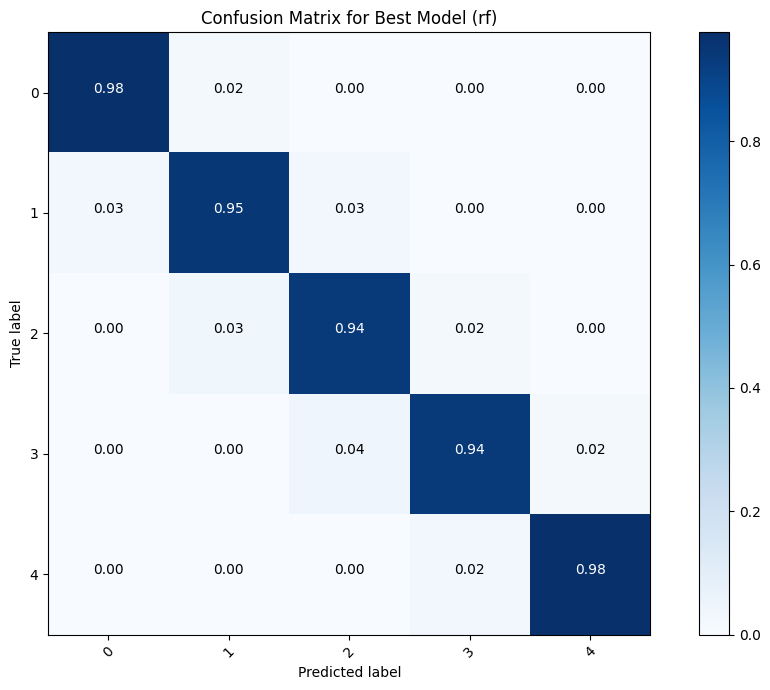

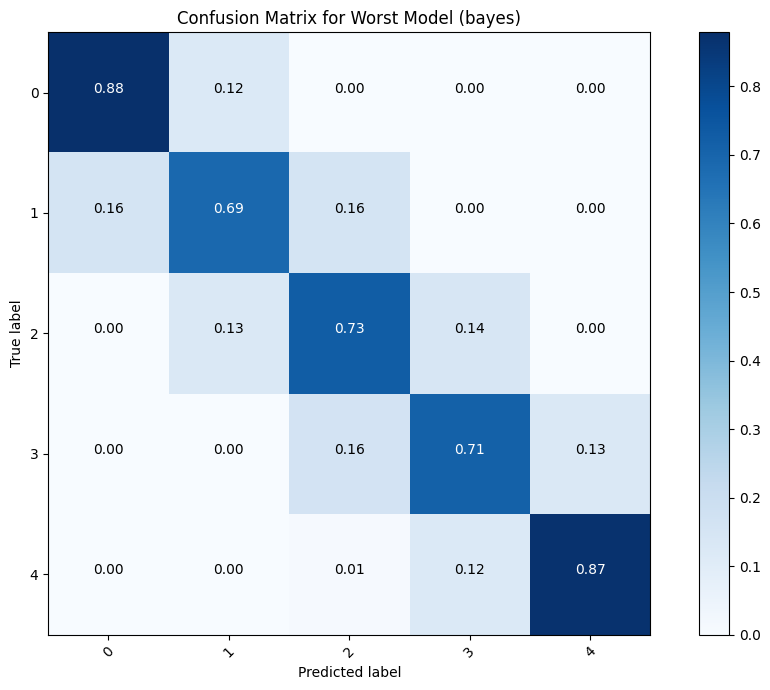

In [ ]:
# Compute confusion matrices
best_cm = confusion_matrix(y_test, best_model_predictions)
worst_cm = confusion_matrix(y_test, worst_model_predictions)

# Define labels
labels = ['0', '1', '2', '3', '4']

# Plot confusion matrices as percentages
plot_confusion_matrix(best_cm, classes=labels, title=f'Confusion Matrix for Best Model ({best_model_name})')
plot_confusion_matrix(worst_cm, classes=labels, title=f'Confusion Matrix for Worst Model ({worst_model_name})')

**Objective**
- The purpose of confusion matrix is to visualize the performance of the best and worst models in terms of its classification accuracy for each target label.

**Insights**
- In the best model's confusion matrix, the dark color on the diagonal indicates a high percentage of correct classifications, and the lighter colors off the diagonal indicate few misclassifications.
- In the worst model's confusion matrix, the lighter color on the diagonal indicates a lower percentage of correct classifications compared to the best model, and the darker colors off the diagonal indicate more misclassification.



# 13. Prophet

- Prophet is an open-source tool developed by Facebook.
- Prophet decomposes a time series into three main components, which are trend, seasonality, and holidays.
- It allows for custom seasonalities and handles missing data and outliers.
- Changepoints are detected automatically as well.
- Multiple seasonalities in the data can be catched by prophet although traditional model such as SARIMA can handle only one seasonality.
- Machine learning models like LSTM can model complex patterns and interactions in the data but high computational time.

In [ ]:
import pandas as pd
from prophet import Prophet
from prophet.make_holidays import make_holidays_df
from prophet.plot import plot_plotly, add_changepoints_to_plot, plot_components_plotly, plot_forecast_component, plot_yearly
from IPython.display import Image
import matplotlib.pyplot as plt

- This code removes outliers by setting values before 5% and after 95%.
- Removing outliers helps to improve model accuracy and reduce model sensitivity.

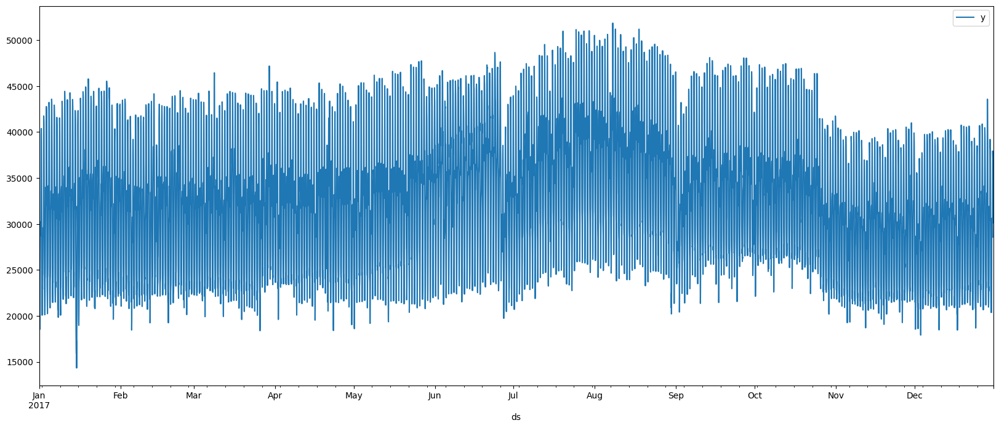

In [ ]:

# Load the dataset
df = pd.read_csv('powerconsumption.csv')

# Select only the relevant columns
df = df[['Datetime', 'PowerConsumption_Zone1']]

# Rename columns for Prophet
df.rename(columns={'Datetime': 'ds', 'PowerConsumption_Zone1': 'y'}, inplace=True)

# Convert the date column to datetime
df['ds'] = pd.to_datetime(df['ds'])

# Resample the data to hourly frequency and take the mean of each hour
df = df.set_index('ds').resample('H').mean().reset_index()


# Plot the data to see the trends
df.plot(x='ds', y='y', figsize=(20, 8))
plt.show()



In [ ]:
df.describe()


,ds,y
count,8736,8736.000000
mean,2017-07-01 23:30:00,32344.970564
min,2017-01-01 00:00:00,14329.113923
25%,2017-04-01 23:45:00,26292.951730
50%,2017-07-01 23:30:00,32342.303347
75%,2017-09-30 23:15:00,37318.002218
max,2017-12-30 23:00:00,51844.261932
std,NaN,7068.919876


In [ ]:
# Handle outliers by setting them to NA
df['y'] = df['y'].where(df['y'].between(df['y'].quantile(0.05), df['y'].quantile(0.95)), None)

# Initialize Prophet with additional seasonalities and more changepoints
m = Prophet(interval_width=0.95, changepoint_range=0.9, yearly_seasonality=True, weekly_seasonality=True, daily_seasonality=True)
m.add_seasonality(name='daily', period=1, fourier_order=15)

In [ ]:
# Fit the model
m.fit(df)

DEBUG:cmdstanpy:input tempfile: /tmp/tmppwv7f7rt/1nudleer.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppwv7f7rt/fkll98vq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39462', 'data', 'file=/tmp/tmppwv7f7rt/1nudleer.json', 'init=/tmp/tmppwv7f7rt/fkll98vq.json', 'output', 'file=/tmp/tmppwv7f7rt/prophet_modelyzqied_j/prophet_model-20240716185432.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:54:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:54:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:

# Create a future dataframe
future = m.make_future_dataframe(periods=24*90, freq='H')

In [ ]:
# Inspect Future Dataframe
future

,ds
0,2017-01-01 00:00:00
1,2017-01-01 01:00:00
2,2017-01-01 02:00:00
3,2017-01-01 09:00:00
4,2017-01-01 10:00:00
...,...
10017,2018-03-30 19:00:00
10018,2018-03-30 20:00:00
10019,2018-03-30 21:00:00
10020,2018-03-30 22:00:00


In [ ]:
# Make predictions
forecast = m.predict(future)



In [ ]:
forecast

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2017-01-01 00:00:00,32032.171772,21653.089333,31030.428667,32032.171772,32032.171772,-5435.807421,-5435.807421,-5435.807421,-2170.917128,...,-930.833562,-930.833562,-930.833562,-2334.056731,-2334.056731,-2334.056731,0.0,0.0,0.0,26596.364351
1,2017-01-01 01:00:00,32032.229613,19476.828166,28856.362734,32032.229613,32032.229613,-7886.125241,-7886.125241,-7886.125241,-4559.484379,...,-999.279940,-999.279940,-999.279940,-2327.360923,-2327.360923,-2327.360923,0.0,0.0,0.0,24146.104372
2,2017-01-01 02:00:00,32032.287454,18458.681294,27512.662848,32032.287454,32032.287454,-9126.263838,-9126.263838,-9126.263838,-5741.192691,...,-1064.417027,-1064.417027,-1064.417027,-2320.654121,-2320.654121,-2320.654121,0.0,0.0,0.0,22906.023616
3,2017-01-01 09:00:00,32032.692342,21158.769148,30272.956079,32032.692342,32032.692342,-6215.434844,-6215.434844,-6215.434844,-2566.441095,...,-1375.583250,-1375.583250,-1375.583250,-2273.410498,-2273.410498,-2273.410498,0.0,0.0,0.0,25817.257498
4,2017-01-01 10:00:00,32032.750183,23994.239858,33174.533242,32032.750183,32032.750183,-3524.768304,-3524.768304,-3524.768304,135.136650,...,-1393.284127,-1393.284127,-1393.284127,-2266.620827,-2266.620827,-2266.620827,0.0,0.0,0.0,28507.981879
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10017,2018-03-30 19:00:00,32639.561062,36722.127105,45930.182433,32638.352939,32640.876481,8504.962144,8504.962144,8504.962144,9227.090572,...,104.585829,104.585829,104.585829,-826.714257,-826.714257,-826.714257,0.0,0.0,0.0,41144.523206
10018,2018-03-30 20:00:00,32639.615322,38366.497593,47567.162826,32638.406137,32640.931653,10143.370772,10143.370772,10143.370772,10847.236942,...,122.723351,122.723351,122.723351,-826.589521,-826.589521,-826.589521,0.0,0.0,0.0,42782.986094
10019,2018-03-30 21:00:00,32639.669582,36868.784044,46325.556814,32638.459335,32640.986826,9088.005592,9088.005592,9088.005592,9775.439812,...,139.036959,139.036959,139.036959,-826.471180,-826.471180,-826.471180,0.0,0.0,0.0,41727.675174
10020,2018-03-30 22:00:00,32639.723842,33485.636844,42834.020823,32638.512533,32641.041998,5577.810418,5577.810418,5577.810418,6251.167255,...,153.002404,153.002404,153.002404,-826.359242,-826.359242,-826.359242,0.0,0.0,0.0,38217.534260


In [ ]:
# yhat: predicted values, yhat_lower: lower uncertainty interval, yhat_upper: upper uncertainty interval
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
10017,2018-03-30 19:00:00,41144.523206,36722.127105,45930.182433
10018,2018-03-30 20:00:00,42782.986094,38366.497593,47567.162826
10019,2018-03-30 21:00:00,41727.675174,36868.784044,46325.556814
10020,2018-03-30 22:00:00,38217.534260,33485.636844,42834.020823
10021,2018-03-30 23:00:00,33692.214972,29106.064210,38218.007050


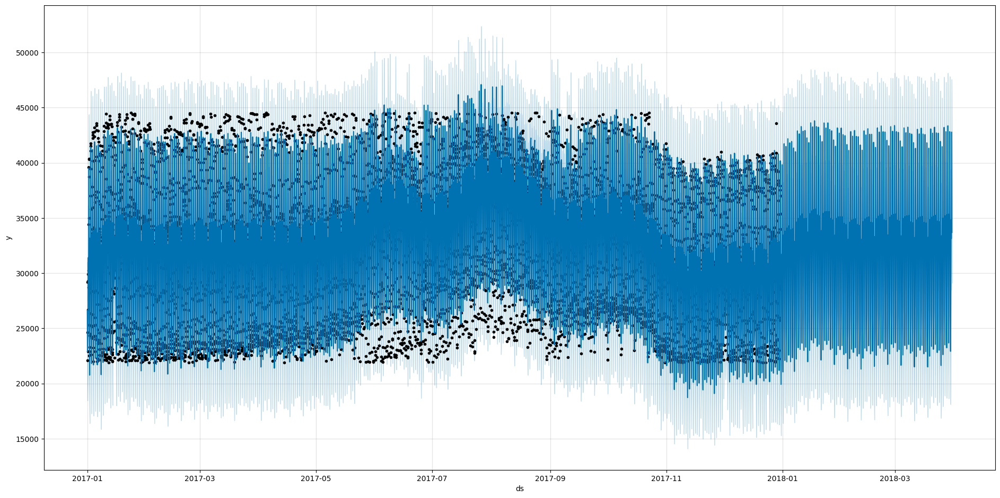

In [ ]:
# Plot the forecast with a larger figure size
fig = m.plot(forecast)
fig.set_size_inches(20, 10)  # Adjust the size as needed
plt.show()



**Objective**
- The purpose is to catch daily, weekly, and yearly seasonality and trends.

**Insights**
- The model clearly catches multiple seasonality patterns in the data.
- The trend changes appear slightly.
- The light blue shade indicates the intervals around the forecasted values.
- The dots indicate the datapoints. After 2018.01.01, there is no data.
- The width of these indicates the model's confidenence in its prediction.

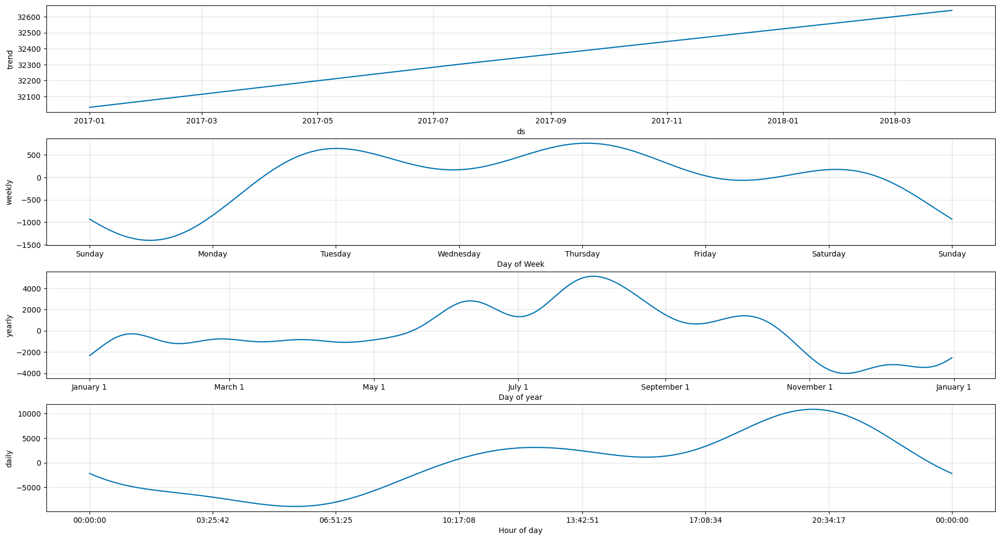

In [ ]:
# Plot the components
fig2 = m.plot_components(forecast)
fig2.set_size_inches(20, 10)
plt.show()

**Objective**
- The purpose is to plot the weekly daily and yearly seasonality to get insights.


**Insights**
- There is a upward trend in power consumption over the year, which means that the average of power consumption level increases over time.
- Each seasonality, weekly, yearly, and daily, is detected, which means that the prophet can catch multiple seasonality at the same time.
- The weekly seasonality shows there is a high power consumption on weekdays, and there is low power consumption on weekends.
- The yearly seasonality shows there is a high power consumption in summer while there is low power consumption in winter.
- The daily seasonality shows there is a high power consumption from afternoon to night while there is low power consumption from midnight to early morning.

In [ ]:
import pandas as pd
from prophet import Prophet
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error
import numpy as np

# Load the dataset
df = pd.read_csv('powerconsumption.csv')

# Select only the relevant columns
df = df[['Datetime', 'PowerConsumption_Zone1']]

# Rename columns for Prophet
df.rename(columns={'Datetime': 'ds', 'PowerConsumption_Zone1': 'y'}, inplace=True)

# Convert the date column to datetime
df['ds'] = pd.to_datetime(df['ds'])

# Resample the data to hourly frequency and take the mean of each hour
df = df.set_index('ds').resample('H').mean().reset_index()

# Split the data into training and testing sets
train_end_date = '2017-12-15'
train = df[df['ds'] < train_end_date]
test = df[df['ds'] >= train_end_date]

# Initialize Prophet with additional seasonalities and more changepoints
m = Prophet(interval_width=0.95, changepoint_range=0.9, yearly_seasonality=True, weekly_seasonality=True, daily_seasonality=True)
m.add_seasonality(name='daily', period=1, fourier_order=15)

# Fit the model on the training data
m.fit(train)

# Create a future dataframe for the test period
future = m.make_future_dataframe(periods=len(test), freq='H')
forecast = m.predict(future)

# Calculate evaluation metrics
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

y_true = test['y'].values
y_pred = forecast.loc[forecast['ds'].isin(test['ds']), 'yhat'].values

rmse = mean_squared_error(y_true, y_pred, squared=False)
mae = mean_absolute_error(y_true, y_pred)
mape = mean_absolute_percentage_error(y_true, y_pred)

print(f'RMSE: {rmse}')
print(f'MAE: {mae}')
print(f'MAPE: {mape}')

# Plot the forecast with a larger figure size
# fig = m.plot(forecast)
# fig.set_size_inches(20, 10)
# plt.show()


DEBUG:cmdstanpy:input tempfile: /tmp/tmppwv7f7rt/cbo2ver0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmppwv7f7rt/w13kma92.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57766', 'data', 'file=/tmp/tmppwv7f7rt/cbo2ver0.json', 'init=/tmp/tmppwv7f7rt/w13kma92.json', 'output', 'file=/tmp/tmppwv7f7rt/prophet_model6thuwwze/prophet_model-20240716185453.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:54:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:54:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


RMSE: 2036.2757110752575
MAE: 1607.1829344502228
MAPE: 5.52064502676067


**Analysis**
- The value of RMSE and MAE are high, which means that high errors in general.
- However, RMSE's magnitude can be influenced by the scale of the data. This time, given that power consumption values can be quite large, and it affects the error.
- MAE indicates less error, but still could benefit from further tuning and improvements.
- MAPE, on the other hand, low error, which means that the model is fairly accurate.
- Compared to CNN, MLP and LSTP, MAPE value is really small and indicates that the prophet model represents higher performance.

## **The plot can only be viewed when the platform is Google Colab**

In [ ]:
# Create interactive forecast plot
fig = plot_plotly(m, forecast)

# Update the layout to adjust the size
fig.update_layout(
    width=1500,  # Adjust the width as needed
    height=800,  # Adjust the height as needed
    title="Interactive Forecast of Power Consumption",
    xaxis_title="Date",
    yaxis_title="Power Consumption",
    font=dict(
        family="Arial, sans-serif",
        size=12,
        color="Black"
    )
)

## **The plot can only be viewed when the platform is Google Colab**

In [ ]:
# Interactive figure of the forecast components
plot_components_plotly(m, forecast)

- The cap and floor values for the future dataframe to ensure that the forecasted values do not exceed these bounds.

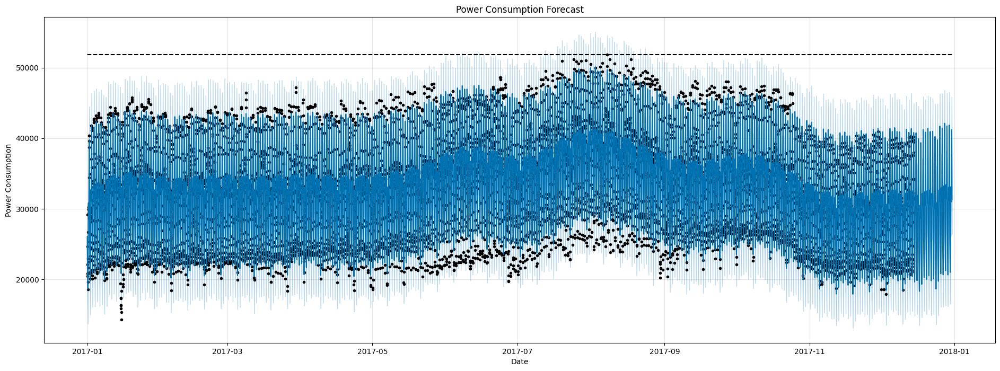

In [ ]:
# Add a floor column if needed
df['floor'] = df['y'].min()  # Set floor to an appropriate value based on your data

# Add a cap column if needed
df['cap'] = df['y'].max()  # Set cap to an appropriate value based on your data

# Specify constant capacity in the future
future['cap'] = df['y'].max()
future['floor'] = df['y'].min()

# Make predictions
fcst = m.predict(future)

# Plot the forecast
fig = m.plot(fcst)

# Change the size of the plot
fig.set_size_inches(20, 7)  # Adjust the size as needed

# Customize the plot
plt.title("Power Consumption Forecast")
plt.xlabel("Date")
plt.ylabel("Power Consumption")

# Display the plot
plt.show()

- The cap and floor values are shown as a black line to make sure that the prediction does not exceed the border.

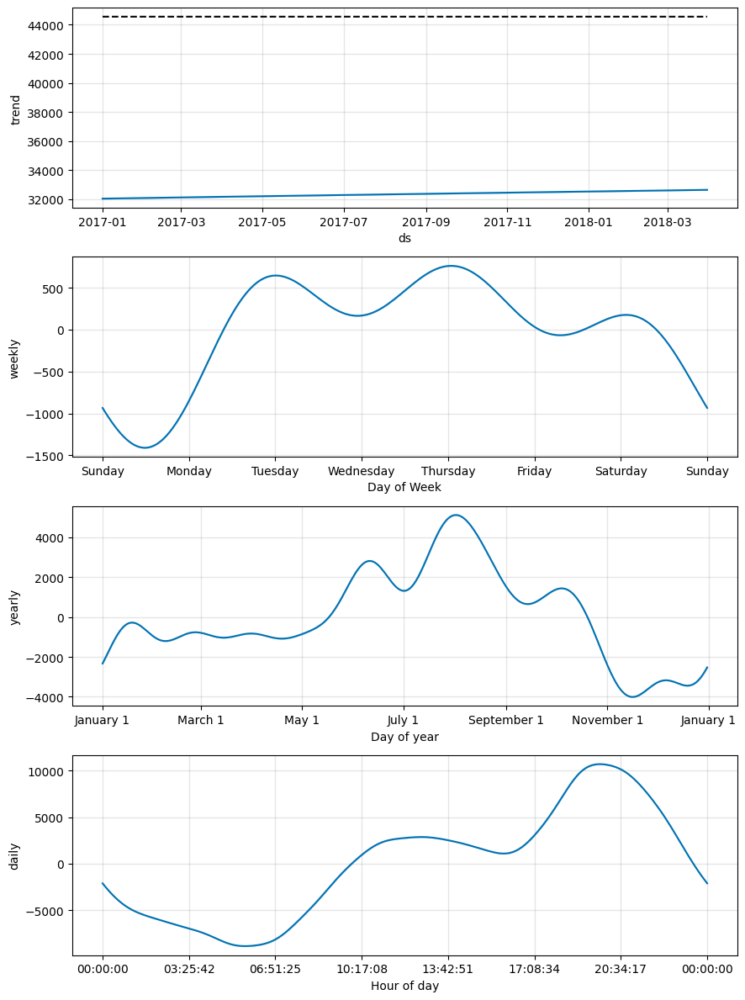

In [ ]:
# Plot forecast components
fig2 = m.plot_components(fcst)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/d8t5lf4u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/tff30ej7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43586', 'data', 'file=/tmp/tmpkwyz3y06/d8t5lf4u.json', 'init=/tmp/tmpkwyz3y06/tff30ej7.json', 'output', 'file=/tmp/tmpkwyz3y06/prophet_modellef4khl8/prophet_model-20240715083436.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
08:34:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:34:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


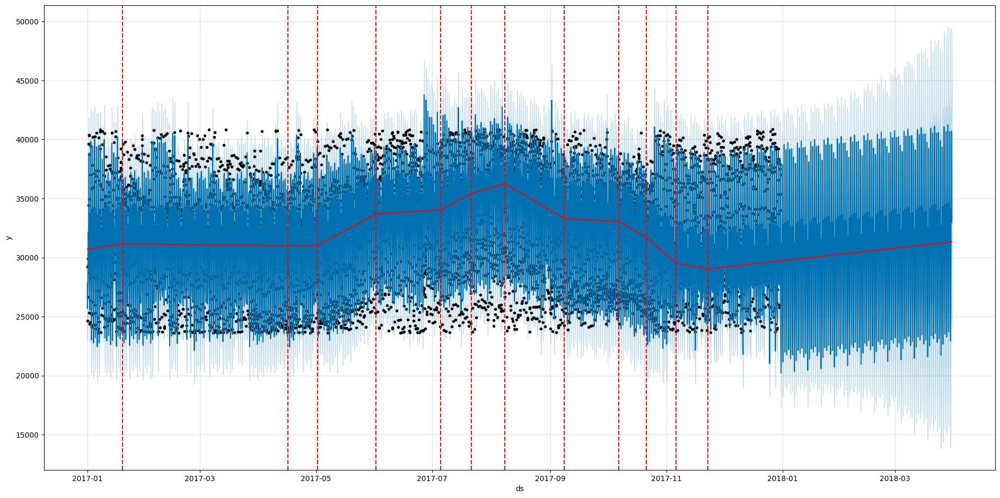

In [ ]:
# Initialize the model with custom changepoint settings (30 change points and the first 90% of the time series).
m = Prophet(n_changepoints=20, changepoint_range=0.9)

# Fit the model
m.fit(df)

# Create future dataframe
future = m.make_future_dataframe(periods=24*90, freq='H')

# Make predictions
forecast = m.predict(future)

# Plot the forecast
fig = m.plot(forecast)

fig.set_size_inches(20, 10)
a = add_changepoints_to_plot(fig.gca(), m, forecast);
 # Adjust the size as needed
plt.show()

**Objectives**
- The purpose of changepoints is to examine the specific dates of the detected changepoints such as events.

**Insights**
- The red lines show how the underlying trend adjusts at these changepoints and find periods increase or decrease power consumption.
- The red line is set to 20 manually.

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/xn9edib1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/0f3b515a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23376', 'data', 'file=/tmp/tmpkwyz3y06/xn9edib1.json', 'init=/tmp/tmpkwyz3y06/0f3b515a.json', 'output', 'file=/tmp/tmpkwyz3y06/prophet_modelp_gj7tm1/prophet_model-20240715083516.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
08:35:16 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:35:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


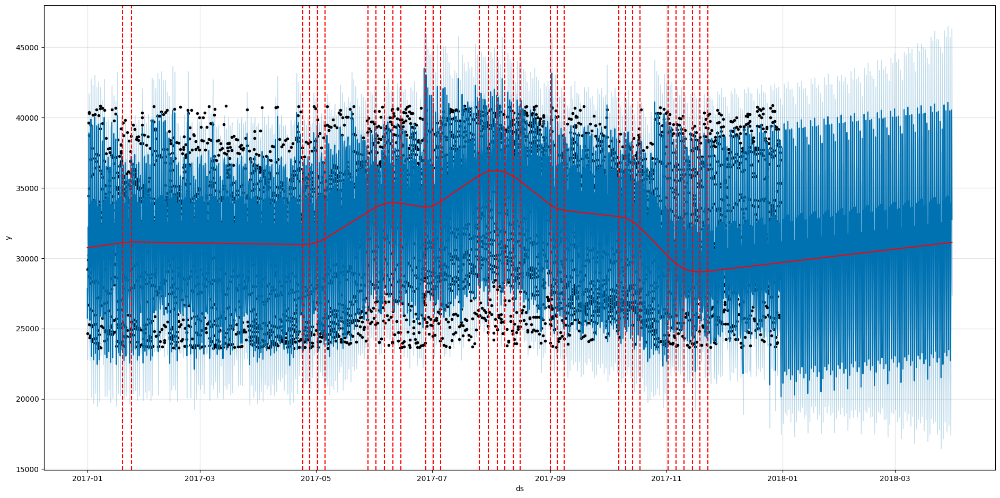

In [ ]:
# Initialize the model with custom changepoint settings (30 change points and the first 90% of the time series).
m = Prophet(n_changepoints=80, changepoint_range=0.9)

# Fit the model
m.fit(df)

# Create future dataframe
future = m.make_future_dataframe(periods=24*90, freq='H')

# Make predictions
forecast = m.predict(future)

# Plot the forecast
fig = m.plot(forecast)

fig.set_size_inches(20, 10)
a = add_changepoints_to_plot(fig.gca(), m, forecast);
 # Adjust the size as needed
plt.show()

**Insights**
- In this code, the red line is set to 80 manually.
- The plot with fewer changepoints resulted in a smoother trend line, and the plot with more changepoints resulted more frequent adjustments in the trend line.
- This plot indicates that the model has detected more points where the trend changes significantly.

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/7xif5y_4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/4pzyzali.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68453', 'data', 'file=/tmp/tmpkwyz3y06/7xif5y_4.json', 'init=/tmp/tmpkwyz3y06/4pzyzali.json', 'output', 'file=/tmp/tmpkwyz3y06/prophet_modelcw4_j0wp/prophet_model-20240715083813.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
08:38:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:38:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


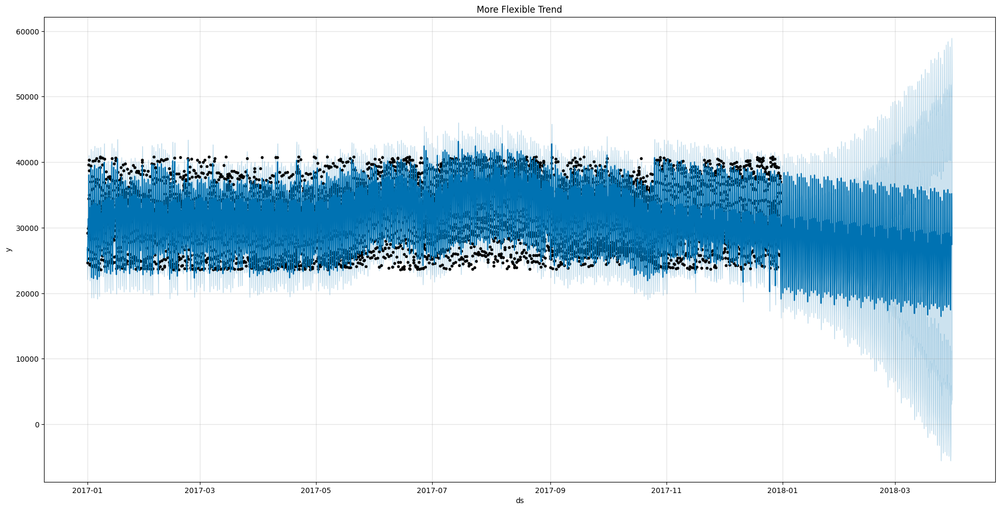

In [ ]:

m = Prophet(changepoint_prior_scale=0.5)
forecast = m.fit(df).predict(future)
fig = m.plot(forecast)
fig.set_size_inches(20, 10)
plt.title('More Flexible Trend');

**Objective**
- The chngepoint_prior_scale parameter is adjusted to 0.5, and the purpose is to control the flexibility of the trend by influencing the number and impact of changepoints.

**Insights**
- The blue shaded area is wider than before, and that represents the range of the area that true values are expected to fall.
- By setting the changepoint scale to 0.5, the model allows for a more flexible trend, and this indicates that the model can adapt more easily to changes in the trend.

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/g_leej9k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/vasefoqv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58476', 'data', 'file=/tmp/tmpkwyz3y06/g_leej9k.json', 'init=/tmp/tmpkwyz3y06/vasefoqv.json', 'output', 'file=/tmp/tmpkwyz3y06/prophet_modelgpgzwo62/prophet_model-20240715083823.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
08:38:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:38:24 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


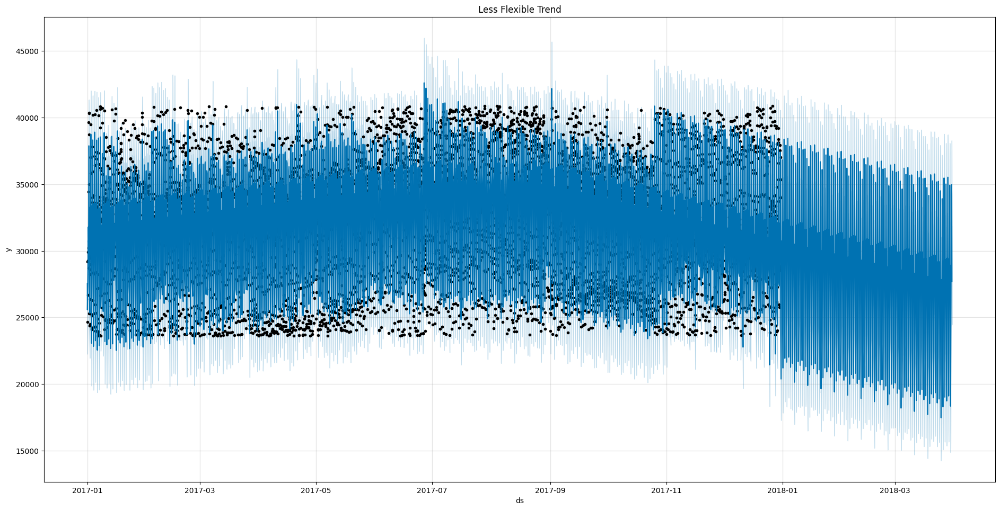

In [ ]:
# Less flexible trend
m = Prophet(changepoint_prior_scale=0.001)
forecast = m.fit(df).predict(future)
fig = m.plot(forecast)
fig.set_size_inches(20, 10)
plt.title('Less Flexible Trend');

**Insights**
- The changepoint scale parameter changed to 0.001.
- The forecasting results are represented differently as the above plot.
- When the scale is 0.5, the model catches the trend more flexibly, and is more dynamic forecast while when the scale is 0.001, the model catches the trend less flexibly, and is more stable and smoother forecast.
- More flexible trend is more sensitive to minor fluctuations, and gets short-term stability.
- Less flexible trend is less sensitive to fluctuations, and gets long=term stability.

In [ ]:
# Define the 2017 Morocco holidays
holidays = pd.DataFrame({
    'holiday': [
        'New Year\'s Day', 'Independence Manifesto Day', 'Labor Day', 'Throne Day', 'Allegiance Day',
        'Revolution Day', 'Youth Day', 'Green March Day', 'Independence Day', 'Eid al-Fitr',
        'Eid al-Fitr', 'Eid al-Adha', 'Eid al-Adha', 'Islamic New Year', 'Prophet Muhammad\'s Birthday'
    ],
    'ds': pd.to_datetime([
        '2017-01-01', '2017-01-11', '2017-05-01', '2017-07-30', '2017-08-20',
        '2017-08-21', '2017-08-21', '2017-11-06', '2017-11-18', '2017-06-25',
        '2017-06-26', '2017-09-01', '2017-09-02', '2017-09-21', '2017-11-30'
    ]),
    'lower_window': 0,
    'upper_window': 1,
})

In [ ]:
# Initialize a Prophet model with custom holidays.
m = Prophet(holidays=holidays)

# Add predefined country holidays for the United States to the model.
m.add_country_holidays(country_name='MA')

# Fit the model to the provided dataframe 'df' containing historical data.
m.fit(df)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/uww5qz1w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/enr5jmtg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4805', 'data', 'file=/tmp/tmpkwyz3y06/uww5qz1w.json', 'init=/tmp/tmpkwyz3y06/enr5jmtg.json', 'output', 'file=/tmp/tmpkwyz3y06/prophet_model_nx9pkq5/prophet_model-20240715084154.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
08:41:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:41:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
# Check which holidays were included
m.train_holiday_names

0                       New Year's Day
1           Independence Manifesto Day
2                            Labor Day
3                           Throne Day
4                       Allegiance Day
5                       Revolution Day
6                            Youth Day
7                      Green March Day
8                     Independence Day
9                          Eid al-Fitr
10                         Eid al-Adha
11                    Islamic New Year
12         Prophet Muhammad's Birthday
13    Proclamation of Independence Day
14                   Oued Ed-Dahab Day
15                         Green March
16             Eid al-Fitr (estimated)
17             Eid al-Adha (estimated)
18        Islamic New Year (estimated)
19      Prophet's Birthday (estimated)
dtype: object

- This is the list of Morroco's holidays in 2017.

In [ ]:
# Make predictions
forecast = m.predict(future)

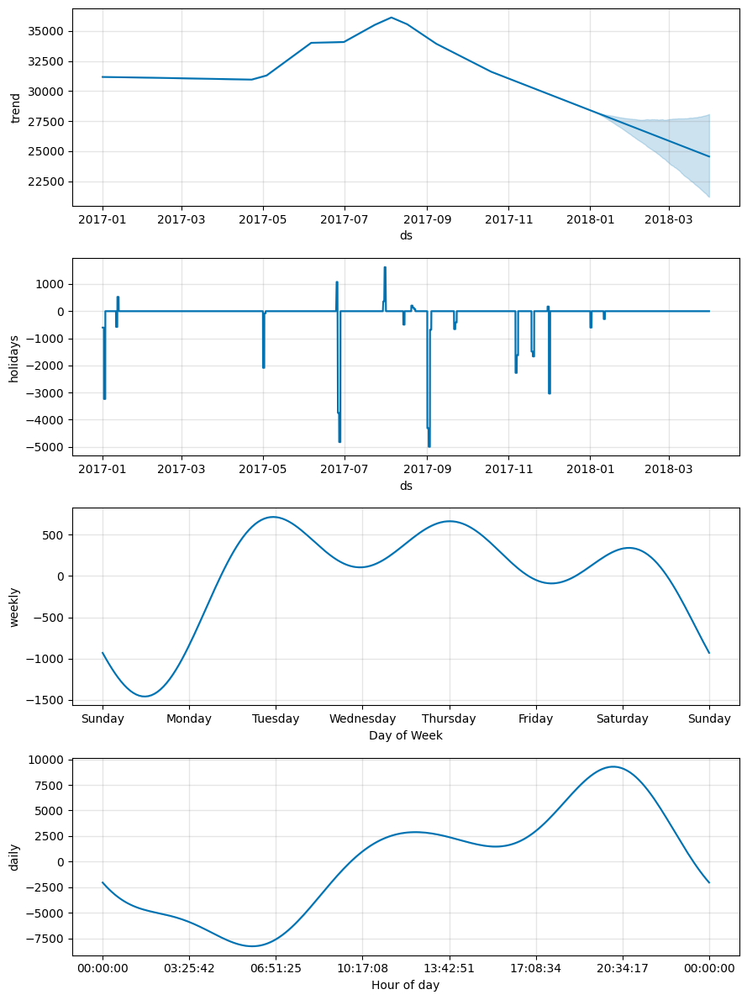

In [ ]:
# Plot the forecast components including holiday effects
fig = m.plot_components(forecast)

**Objective**
- The purpose is to find how the holidays component shows the impact of specific holidays on power consumption.

**Insights**
- Most of the holidays show minus correlation with power consumption, which means reduced industrial and ommercial activity during these days, or citizen tend to go outside from the country, Morroco.
- There is a few plus correlation with power consumption, which means increased industrial and commercial activity during the day.

DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/al9p8y38.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/6ukjgc06.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82485', 'data', 'file=/tmp/tmpkwyz3y06/al9p8y38.json', 'init=/tmp/tmpkwyz3y06/6ukjgc06.json', 'output', 'file=/tmp/tmpkwyz3y06/prophet_model505wskj7/prophet_model-20240715085313.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
08:53:13 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:53:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


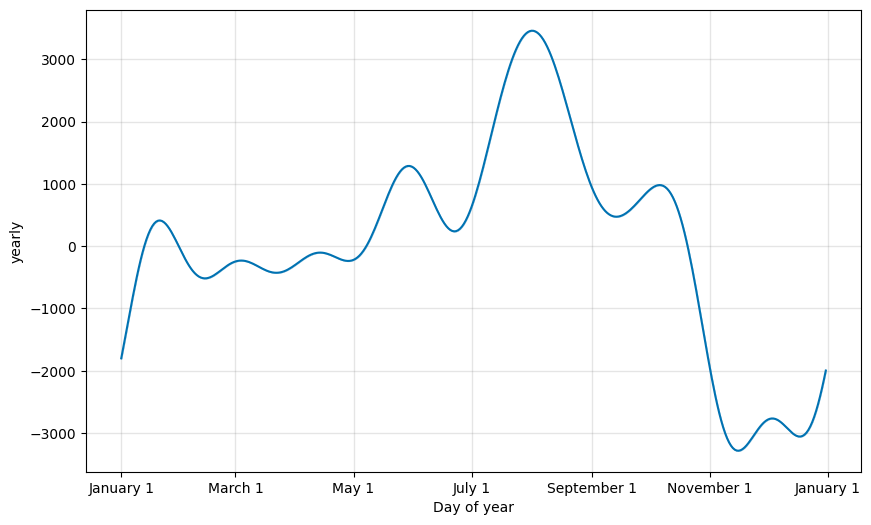

In [ ]:
from prophet.plot import add_changepoints_to_plot, plot_yearly
# Handle outliers by setting them to NA
df['y'] = df['y'].where(df['y'].between(df['y'].quantile(0.05), df['y'].quantile(0.95)), None)

# Initialize Prophet with additional seasonalities and more changepoints
m = Prophet(interval_width=0.95, changepoint_range=0.9, yearly_seasonality=True, weekly_seasonality=True, daily_seasonality=False)
m.add_seasonality(name='daily', period=1, fourier_order=15)

# Fit the model
m.fit(df)

# Create a future dataframe
future = m.make_future_dataframe(periods=24*90, freq='H')

# Make predictions
forecast = m.predict(future)
# Plot the yearly seasonality
fig = plot_yearly(m)
plt.show()

DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/9c5u3n43.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpkwyz3y06/6a2ndiva.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61048', 'data', 'file=/tmp/tmpkwyz3y06/9c5u3n43.json', 'init=/tmp/tmpkwyz3y06/6a2ndiva.json', 'output', 'file=/tmp/tmpkwyz3y06/prophet_modelveo7kc7z/prophet_model-20240715085320.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
08:53:20 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:53:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


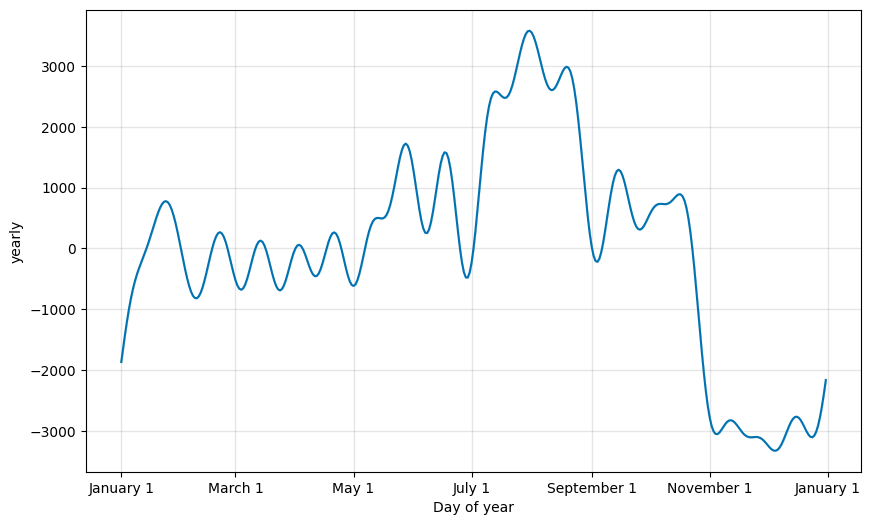

In [ ]:
m = Prophet(yearly_seasonality=20).fit(df)
a = plot_yearly(m)

**Objective**
- The purpose is to understand seasonal variations, and compare model configuration.

**Insights**
- Both plots show the seasonal patterns over a year.
- In the summer season, the peak of power consumption comes because of the air conditioner.
- In the winter season, a dip is observed because of less activity or holidays effects.
- The second plot shows more detailed seasonality compared to the first plot because the second plot increased complexity and the the model captured more complex seasonal patterns.

# 14. Conclusion


1.**What are the trends and patterns in energy consumption over the recorded period?**
- There is a seasonality which is higher energy consumption during morning and evening hours due to human activities (e.g., households, work).
- There is a trend of increasing energy usage during summer months for cooling.
- Daily seasonality is important for accurate modeling and forecasting of energy consumption.
- The prophet model was able to catch all seasonalities that the data has and differentiate them.

2.**How do different weather conditions affect electricity usage in Tetouan?**
- Temperature: There is a positive correlation (0.440) with power consumption, with higher temperatures increasing air conditioning use in summer and colder temperatures increasing heating use in winter.
- Humidity: There is a weak negative correlation (-0.287) with power consumption.
- power wind: There is almost no correlation (0.167) with power consumption.
- Temperature data was used as a feature to find demands based on the seasons or weather conditions using the classification method.

3.**How effective are different machine learning models in predicting energy consumption, and which model performs the best?**
- Naive and Drift Models: High RMSE, MAE, and MAPE values indicate limited predictive power.
- Seasonal Naive and Mean Models: Slightly better but still high error metrics.
- Autoregression and AR+MA Models: Lower RMSE and MAE, but high MAPE values.
- ARIMA and SARIMA Models: Lowest RMSE, MAE, and MAPE values, with SARIMA performing best due to capturing seasonal patterns.
- Univariate MLP and CNN Models: Low RMSE and MAE but high MAPE values suggest issues with generalization.
- Multivariate MLP and CNN Models: Slightly better RMSE and MAE but still high MAPE values.
- Multi-step Models: Higher error metrics, and it is difficult to capture multi-step dependencies accurately.
- The Prophet Model: High error for RMSE and MAE but lowest percentage for MAPE.
- The prophet model is the best-performing model across all metrics because it captures multiple seasonalities at the same time, and removes the outliers.
- The grid search succeeded in searching the best parameters for MLP, CNN and LSTM.

4.**How can integrating multiple features (e.g., temperature, humidity) improve the accuracy of energy consumption forecasts?**
 Multiple Input Models: Improved RMSE and MAE values by capturing additional variability from multiple features.
- Multi-headed and Multi-output Models: Benefit from additional features but still face high MAPE values.
- Multi-step Models: Better performance in capturing future steps but higher error metrics compared to simpler models.
- The classification succeeded in classifying the data into five labels based on the power consumption data and temperature data as a feature to investigate the usage based on weather conditions.
<br><br/>

This project thoroughly analyzed the demand and usage for power consumption based on historical data while utilizing various frameworks and methods to forecast future power consumption. The discovered patterns, trends, and accurate predictions are essential for power suppliers in determining future strategies. Therefore, it is crucial to aim for an expansion of knowledge and techniques, along with achieving even higher accuracy in predictions.

